# Shear profile around A360 using ComCam HSM shapes - Manual

Prakruth Adari, Céline Combet, Anja von der Linden\
LSST Science Piplines version: Weekly 2025_30\
Container Size: large

This notebook goes over the necessary steps to create the source sample for the Abell 360 Weak Lensing project. A rough outline of the steps are:

- Loading the relevant object catalogs (all tracts and patches needed) using the butler
- Applying cuts (color/photo-z + lensing quality)
- Load in calibration (using the `gen_hsc_calibration` script)
- Shear profile

In [1]:
import numpy as np
import astropy.units as u
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from scipy.spatial import KDTree
import scipy.interpolate as interpolate
from scipy.optimize import curve_fit
import scipy.integrate as integrate
import scipy.stats as stats
import healpy as hp
import pandas as pd
import matplotlib as mpl
from matplotlib import cm
import matplotlib.colors as colors
from matplotlib.colors import to_rgba
from matplotlib.patches import Patch, Circle
from astropy.visualization import make_lupton_rgb
from matplotlib.legend_handler import HandlerLine2D
from matplotlib.lines import Line2D
from astropy.table import Table, join, vstack
from astropy.io import fits
from astropy.wcs import WCS
import healsparse as hsp
from astropy.coordinates import SkyCoord
# %matplotlib widget
import h5py
import qp

In [2]:
# Familiar stack packages
from lsst.daf.butler import Butler
from lsst.geom import Box2I, Box2D, Point2I, Point2D, Extent2I, Extent2D
import lsst.geom as geom
# from lsst.afw.image import Exposure, Image, PARENT
import lsst.sphgeom

# These may be less familiar objects dealing with multi-band data products
from lsst.afw.image import MultibandExposure, MultibandImage, Image
from lsst.afw.geom import makeSkyWcs

from lsst.ip.diffim import GetTemplateTask

In [3]:
# import lsst.afw.display as afwDisplay
import os, sys, gc
import functools
import pickle

In [4]:
import clmm
from clmm import GalaxyCluster, ClusterEnsemble, GCData, Cosmology
from clmm import Cosmology, utils

cosmo = clmm.Cosmology(H0=70.0, Omega_dm0=0.3 - 0.045, Omega_b0=0.045, Omega_k0=0.0)

/home/a/adari/.local/lib/python3.13/site-packages/clmm/theory/__init__.py:91: UserWarning: CLMM Backend requested 'ccl' is not available, trying others...
  warnings.warn(
/home/a/adari/.local/lib/python3.13/site-packages/clmm/theory/__init__.py:96: UserWarning: * NumCosmo BACKEND also not available
  warnings.warn(f"* {conf['name']} BACKEND also not available")


In [5]:
hdir = os.getenv('HOME')
ddir = '/home/a/adari/DATA'
outdir = '/home/a/adari/u/clusters/cluster_data'
# outdir = '/global/cfs/cdirs/lsst/groups/CL/A360_DP1/source_selection_scratch/'

In [6]:
# Running at USDF RSP?
pz_sv38_point = '/sdf/data/rubin/shared/pz/projects/dp1/data/gold_baseline/dp1_sv38/dp1_v29.0.0_gold_Rubin_SV_38_7_photoz_cat.parquet'
pz_ecdfs_point = '/sdf/data/rubin/shared/pz/projects/dp1/data/gold_baseline/dp1_all/dp1_v29.0.0_gold_photoz_cat.parquet'
# pz_sv38_pdf_dir = '/home/z/ztq1996/comm_pz/dp1_run/rail_project_root/projects/dp1/data/gold_dp1_optimize_4band/dp1_sv38/'
pz_ecdfs_pdf_dir = '/sdf/data/rubin/shared/pz/projects/dp1/data/gold_baseline/dp1_all'
pz_sv38_pdf_dir = '/sdf/data/rubin/shared/pz/projects/dp1/data/gold_baseline/dp1_sv38'

# Running at NERSC?
# pz_sv38_pdf_dir = '/global/cfs/cdirs/lsst/groups/PZ/DP1/projects/dp1_v4/data/gold_dp1_4band'
# pz_ecdfs_pdf_dir = '/global/cfs/cdirs/lsst/groups/PZ/DP1/projects/dp1_v4/data/gold_dp1_6band'

In [7]:
%matplotlib inline
%config InlineBackend.figure_format='retina'

In [8]:
plt.rcParams.update({
    "text.usetex": False,
    "font.family": "sans-serif",
    "font.sans-serif": ["Times"],
    "figure.labelsize": 14,
    "mathtext.fontset": 'stix',
    "font.family": "STIXGeneral",
    "font.size": 14
})
# plt.rcParams['mathtext.fontset'] = 'stix'
# plt.rcParams['font.family'] = 'STIXGeneral'
%matplotlib inline
# plt.rcParams.update({'font.size':14})

In [9]:
def showRGB(image, bgr="gri", ax=None, fp=None, figsize=(8,8), stretch=57, Q=10):
    """Display an RGB color composite image with matplotlib.
    
    Parameters
    ----------
    image : `MultibandImage`
        `MultibandImage` to display.
    bgr : sequence
        A 3-element sequence of filter names (i.e. keys of the exps dict) indicating what band
        to use for each channel. If `image` only has three filters then this parameter is ignored
        and the filters in the image are used.
    ax : `matplotlib.axes.Axes`
        Axis in a `matplotlib.Figure` to display the image.
        If `axis` is `None` then a new figure is created.
    fp: `lsst.afw.detection.Footprint`
        Footprint that contains the peak catalog for peaks in the image.
        If `fp` is `None` then no peak positions are plotted.
    figsize: tuple
        Size of the `matplotlib.Figure` created.
        If `ax` is not `None` then this parameter is ignored.
    stretch: int
        The linear stretch of the image.
    Q: int
        The Asinh softening parameter.
    """
    # If the image only has 3 bands, reverse the order of the bands to produce the RGB image
    if len(image) == 3:
        bgr = image.filters
    # Extract the primary image component of each Exposure with the .image property, and use .array to get a NumPy array view.
    rgb = make_lupton_rgb(image_r=image[bgr[2]].array,  # numpy array for the r channel
                          image_g=image[bgr[1]].array,  # numpy array for the g channel
                          image_b=image[bgr[0]].array,  # numpy array for the b channel
                          stretch=stretch, Q=Q)  # parameters used to stretch and scale the pixel values
    if ax is None:
        fig = plt.figure(figsize=figsize)
        ax = fig.add_subplot(1,1,1)
    
    # Exposure.getBBox() returns a Box2I, a box with integer pixel coordinates that correspond to the centers of pixels.
    # Matplotlib's `extent` argument expects to receive the coordinates of the edges of pixels, which is what
    # this Box2D (a box with floating-point coordinates) represents.
    integerPixelBBox = image[bgr[0]].getBBox()
    bbox = Box2D(integerPixelBBox)
    ax.imshow(rgb, interpolation='nearest', origin='lower', extent=(bbox.getMinX(), bbox.getMaxX(), bbox.getMinY(), bbox.getMaxY()))
    if fp is not None:
        for peak in fp.getPeaks():
            ax.plot(peak.getIx(), peak.getIy(), "bx", mew=2)

In [10]:
def createRGB(image, bgr="gri", stretch=57, Q=10, scale=None):
    """Display an RGB color composite image with matplotlib.
    
    Parameters
    ----------
    image : `MultibandImage`
        `MultibandImage` to display.
    bgr : sequence
        A 3-element sequence of filter names (i.e. keys of the exps dict) indicating what band
        to use for each channel. If `image` only has three filters then this parameter is ignored
        and the filters in the image are used.
    ax : `matplotlib.axes.Axes`
        Axis in a `matplotlib.Figure` to display the image.
        If `axis` is `None` then a new figure is created.
    fp: `lsst.afw.detection.Footprint`
        Footprint that contains the peak catalog for peaks in the image.
        If `fp` is `None` then no peak positions are plotted.
    figsize: tuple
        Size of the `matplotlib.Figure` created.
        If `ax` is not `None` then this parameter is ignored.
    stretch: int
        The linear stretch of the image.
    Q: int
        The Asinh softening parameter.
    """
    # If the image only has 3 bands, reverse the order of the bands
    #   to produce the RGB image
    if len(image) == 3:
        bgr = image.bands

    # Extract the primary image component of each Exposure with the
    #   .image property, and use .array to get a NumPy array view.

    if scale is None:
        r_im = image[bgr[2]].array  # numpy array for the r channel
        g_im = image[bgr[1]].array  # numpy array for the g channel
        b_im = image[bgr[0]].array  # numpy array for the b channel
    else:
        # manually re-scaling the images here
        r_im = image[bgr[2]].array * scale[0]
        g_im = image[bgr[1]].array * scale[1]
        b_im = image[bgr[0]].array * scale[2]

    rgb = make_lupton_rgb(image_r=r_im,
                          image_g=g_im,
                          image_b=b_im,
                          stretch=stretch, Q=Q)
    # "stretch" and "Q" are parameters to stretch and scale the pixel values

    return rgb

In [11]:
# QOL Functions to make cubehelix colormaps

import matplotlib as mpl
import matplotlib.colors as mcolors


def _reverser(func, x):
    # adapted from matplotlib.colors.LinearSegmentedColormap._reverser
    return func(1 - x)

def reversed(cmap):
    # adapted from matplotlib.colors.LinearSegmentedColormap.reversed
    # Using a partial object keeps the cmap picklable.
    data_r = {
        key: (functools.partial(_reverser, data))
        for key, data in cmap._segmentdata.items()}

    new_cmap = mcolors.LinearSegmentedColormap(
        cmap.name,
        data_r,
        cmap.N,
        cmap._gamma,
    )

    # Reverse the over/under values too
    new_cmap._rgba_over = cmap._rgba_under
    new_cmap._rgba_under = cmap._rgba_over
    new_cmap._rgba_bad = cmap._rgba_bad

    return new_cmap


def _truncator(func, light, dark, x):
    # adapted from matplotlib.colors.LinearSegmentedColormap._reverser
    if (light > 1) or (light < 0):
        raise ValueError(f"light {light} not in [0, 1]")
    if (dark > 1) or (dark < 0):
        raise ValueError(f"dark {dark} not in [0, 1]")

    return func(x * (light - dark) + dark)


def truncated(cmap, light, dark):
    # adapted from matplotlib.colors.LinearSegmentedColormap.reversed
    # Using a partial object keeps the cmap picklable.
    data_t = {
        key: (functools.partial(_truncator, data, light, dark))
        for key, data in cmap._segmentdata.items()
    }

    new_cmap = mcolors.LinearSegmentedColormap(
        cmap.name,
        data_t,
        cmap.N,
        cmap._gamma,
    )

    # Truncate the over/under values too
    new_cmap._rgba_over = cmap._rgba_under
    new_cmap._rgba_under = cmap._rgba_over
    new_cmap._rgba_bad = cmap._rgba_bad

    return new_cmap


def cubehelix_colormap(
    *,
    start=None,
    rot=None,
    gamma=None,
    hue=None,
    light=1,
    dark=0,
    name=None,
    reverse=False,
):
    """
    cubehelix color scheme by Dave Green (https://people.phy.cam.ac.uk/dag9/CUBEHELIX/)
    """
    # Note: this relies on an internal matplotlib function, so may need to be
    # updated in the future
    cdict = mpl._cm.cubehelix(gamma=gamma, s=start, r=rot, h=hue)

    cmap = mcolors.LinearSegmentedColormap(name, cdict)

    cmap = truncated(cmap, light, dark)

    if reverse:
        cmap = reversed(cmap)

    return cmap

def cubehelix_palette(
    n_colors=6,
    start=0,
    rot=0.4,
    gamma=1.0,
    hue=0.8,
    light=0.85,
    dark=0.15,
    reverse=False,
):
    cmap = cubehelix_colormap(
        start=start,
        rot=rot,
        gamma=gamma,
        hue=hue,
        light=light,
        dark=dark,
        name=None,
        reverse=reverse,
    )

    x = np.linspace(0, 1, n_colors)
    palette = cmap(x)[:, :3].tolist()

    return palette

In [12]:
rng = np.random.default_rng()

In [13]:
arcsec = 1/60**2

In [14]:
cosmo = clmm.Cosmology(H0=70.0, Omega_dm0=0.3 - 0.045, Omega_b0=0.045, Omega_k0=0.0)

In [15]:
omega_m = .3
omega_de= .7
omega_r = 0
H0 = 70 # km/s/Mpc
C = 3e5 # km/s

In [16]:
Hz = lambda z : C/(H0  * np.sqrt((omega_de + omega_m * (1+z)**3 + omega_r * (1+z)**4)))
chi_dl = lambda z, z0=0 : integrate.quad(Hz, z0, z)[0]
Da = lambda z : chi_dl(z)/(1+z)
Daz1z2 = lambda z1, z2 : 1/(1+z2)*(chi_dl(z2) - chi_dl(z1))
# beta_r = lambda zl, zs : integrate.quad(Hz, zl, zs)[0]/integrate.quad(Hz, 0, zs)[0]
beta_s = lambda zl, zs : 0 if zs < zl else Daz1z2(zl, zs)/Da(zs) * Da(1e3)/Daz1z2(zl, 1e3)

In [17]:
cluster_coords = (37.86501659859067, 6.982204815599694)
ra_bcg, dec_bcg = cluster_coords

In [18]:
pz_algos = ['bpz', 'tpz', 'fzboost', 'knn', 'gpz', 'dnf', 'lephare', 'cmnn']

In [19]:
bands = list('griz')
cmodel_bands = [b+suffix for b in bands for suffix in ['_cModelFlux', '_cModelFluxErr', '_cModel_flag']]
gaap_bands = [b+suffix for b in bands for suffix in ['_gaap1p0Flux', '_gaap1p0FluxErr',  '_gaapFlux_flag']]
psf_bands = [b+suffix for b in bands for suffix in ['_psfFlux', '_psfFluxErr',  '_psfFlux_flag']]
extended_bands = [b+'_extendedness' for b in bands]

object_req_cols = ['coord_ra', 'coord_dec', 'refExtendedness', 'objectId', 'parentObjectId',
                   'shape_flag', 'shape_xx', 'shape_xy', 'shape_yy', 'refBand', 'x', 'y',
                   'patch', 'tract', 'i_ixxPSF', 'i_iyyPSF', 'i_ixyPSF', 'i_iPSF_flag',
                   'i_hsmShapeRegauss_e1', 'i_hsmShapeRegauss_e2', 'i_ixx', 'i_ixy', 'i_iyy',
                   'i_hsmShapeRegauss_flag', 'i_hsmShapeRegauss_sigma', 'i_blendedness' ] + cmodel_bands + gaap_bands + extended_bands + psf_bands

## Functions

It's helpful to have all the relevant functions defined in once place instead of scattered throughout the entire notebook.

In [20]:
def preclean_filt(preclean_table):
    clean_filt = np.logical_and.reduce((~preclean_table['i_iPSF_flag'], ~preclean_table['i_hsmShapeRegauss_flag'],
                                        ~preclean_table['shape_flag'], ~np.isnan(preclean_table['refExtendedness']),
                                        ~preclean_table['g_cModel_flag'], ~preclean_table['r_cModel_flag'], ~preclean_table['i_cModel_flag'], ~preclean_table['z_cModel_flag'],
                                        ~preclean_table['g_gaapFlux_flag'], ~preclean_table['r_gaapFlux_flag'], ~preclean_table['i_gaapFlux_flag'], ~preclean_table['z_gaapFlux_flag']))
    return clean_filt

def preclean_flux_filt(preclean_table):
    clean_filt = np.logical_and.reduce((~np.isnan(preclean_table['refExtendedness']), ~preclean_table['shape_flag'],
                                    ~preclean_table['g_cModel_flag'], ~preclean_table['r_cModel_flag'], ~preclean_table['i_cModel_flag'], ~preclean_table['z_cModel_flag'],
                                    ~preclean_table['g_gaapFlux_flag'], ~preclean_table['r_gaapFlux_flag'], ~preclean_table['i_gaapFlux_flag'], ~preclean_table['z_gaapFlux_flag']))
    return clean_filt

In [21]:
def apply_redsequence(table, mag_lim = 23.5, bright_lim=18, delta=0.05):
    
    gi_table_line = (table['i_cModel_mag'] - 18) * (-0.2/5) + 1.9
    ri_table_line = (table['i_cModel_mag'] - 18) * (-0.1/5) + .55
    gr_table_line = (table['i_cModel_mag'] - 18) * (-0.25/5) + 1.35
    
    gi_lims = (0.1, -.25)
    ri_lims = (0.04, -0.08)
    gr_lims = (0.1, -.15)

    table['gi'] = table['g_gaap_mag'] - table['i_gaap_mag']
    table['gr'] = table['g_gaap_mag'] - table['r_gaap_mag']
    table['ri'] = table['r_gaap_mag'] - table['i_gaap_mag']

    gi_redseq = np.logical_and.reduce((table['gi'] < gi_table_line + gi_lims[0] + delta, table['gi'] > gi_table_line + gi_lims[1] - delta,
                                   table['i_cModel_mag'] < 28, table['i_cModel_mag'] > bright_lim))
    ri_redseq = np.logical_and.reduce((table['ri'] < ri_table_line + ri_lims[0] + delta, table['ri'] > ri_table_line + ri_lims[1] - delta,
                                       table['i_cModel_mag'] < 28, table['i_cModel_mag'] > bright_lim))
    gr_redseq = np.logical_and.reduce((table['gr'] < gr_table_line + gr_lims[0] + delta, table['gr'] > gr_table_line + gr_lims[1] - delta,
                                       table['i_cModel_mag'] < 28, table['i_cModel_mag'] > bright_lim))

    all_redseq = np.logical_and.reduce((gi_redseq, ri_redseq, gr_redseq))
    table['all_redseq'] = all_redseq
    # For individual colors we should add a magnitude limit since it's more likely for source galaxies to be located in at least one color
    
    table['gi_redseq'] = np.logical_and(gi_redseq, table['r_cModel_mag'] < mag_lim)
    table['ri_redseq'] = np.logical_and(ri_redseq, table['r_cModel_mag'] < mag_lim)
    table['gr_redseq'] = np.logical_and(gr_redseq, table['r_cModel_mag'] < mag_lim)

    return table
    
def apply_redsequence_noisy(table, mag_lim = 23.5, bright_lim=18, sigma=2, delta=0.05):

    gi_table_line = (table['i_cModel_mag'] - 18) * (-0.3/5) + 1.9
    ri_table_line = (table['i_cModel_mag'] - 18) * (-0.1/5) + .55
    gr_table_line = (table['i_cModel_mag'] - 18) * (-0.25/5) + 1.35

    gi_lims = (0.1 + delta, -.25 - delta)
    ri_lims = (0.04 + delta, -0.08 - delta)
    gr_lims = (0.1 + delta, -.15 - delta)

    # gi_neg = -2.5*np.log10((table['g_gaap1p0Flux'] - sigma*table['g_gaap1p0FluxErr'])/(table['i_gaap1p0Flux'] - sigma*table['i_gaap1p0FluxErr']))
    # ri_neg = -2.5*np.log10((table['r_gaap1p0Flux'] - sigma*table['r_gaap1p0FluxErr'])/(table['i_gaap1p0Flux'] - sigma*table['i_gaap1p0FluxErr']))
    # gr_neg = -2.5*np.log10((table['g_gaap1p0Flux'] - sigma*table['g_gaap1p0FluxErr'])/(table['r_gaap1p0Flux'] - sigma*table['r_gaap1p0FluxErr']))

    # gi_pos = -2.5*np.log10((table['g_gaap1p0Flux'] + sigma*table['g_gaap1p0FluxErr'])/(table['i_gaap1p0Flux'] + sigma*table['i_gaap1p0FluxErr']))
    # ri_pos = -2.5*np.log10((table['r_gaap1p0Flux'] + sigma*table['r_gaap1p0FluxErr'])/(table['i_gaap1p0Flux'] + sigma*table['i_gaap1p0FluxErr']))
    # gr_pos = -2.5*np.log10((table['g_gaap1p0Flux'] + sigma*table['g_gaap1p0FluxErr'])/(table['r_gaap1p0Flux'] + sigma*table['r_gaap1p0FluxErr']))

    # gi_plus = np.maximum(gi_pos, gi_neg)
    # ri_plus = np.maximum(ri_pos, ri_neg)
    # gr_plus = np.maximum(gr_pos, gr_neg)

    # gi_minus = np.minimum(gi_neg, gi_pos)
    # ri_minus = np.minimum(ri_neg, ri_pos)
    # gr_minus = np.minimum(gr_neg, gr_pos)

    g_mag_err = 2.5/np.log(10) * table['g_gaap1p0FluxErr']/table['g_gaap1p0Flux']
    r_mag_err = 2.5/np.log(10) * table['r_gaap1p0FluxErr']/table['r_gaap1p0Flux']
    i_mag_err = 2.5/np.log(10) * table['i_gaap1p0FluxErr']/table['i_gaap1p0Flux']
    
    gi_err = np.sqrt(g_mag_err**2 + i_mag_err**2)
    gr_err = np.sqrt(g_mag_err**2 + r_mag_err**2)
    ri_err = np.sqrt(r_mag_err**2 + i_mag_err**2)
    
    table['gi'] = table['g_gaap_mag'] - table['i_gaap_mag']
    table['ri'] = table['r_gaap_mag'] - table['i_gaap_mag']
    table['gr'] = table['g_gaap_mag'] - table['r_gaap_mag']

    gi_plus = table['gi'] + sigma*gi_err
    ri_plus = table['ri'] + sigma*ri_err
    gr_plus = table['gr'] + sigma*gr_err

    gi_minus = table['gi'] - sigma*gi_err
    ri_minus = table['ri'] - sigma*ri_err
    gr_minus = table['gr'] - sigma*gr_err
    
    table['gi_plus'] = gi_plus
    table['ri_plus'] = ri_plus
    table['gr_plus'] = gr_plus

    table['gi_neg'] = gi_minus
    table['ri_neg'] = ri_minus
    table['gr_neg'] = gr_minus

    rs_table_lines = [gi_table_line, ri_table_line, gr_table_line]
    rs_lims = [gi_lims, ri_lims, gr_lims]
    rs_table_upper = [t+l[0] for t,l in zip(rs_table_lines, rs_lims)]
    rs_table_lower = [t+l[1] for t,l in zip(rs_table_lines, rs_lims)]
    table_plus = [gi_plus, ri_plus, gr_plus]
    table_neg = [gi_minus, ri_minus, gr_minus]

    redsequences = []
    for i,cc in enumerate(['gi', 'ri', 'gr']):
        redseq = np.logical_and.reduce((table[cc] < rs_table_upper[i], table[cc] > rs_table_lower[i],
                                         table['i_cModel_mag'] < 28, table['i_cModel_mag'] > bright_lim))
        redseq_err = np.logical_or.reduce((
                                           np.logical_and.reduce((table_plus[i] > rs_table_upper[i],
                                                                  rs_table_lower[i] < table_neg[i],
                                                                  table_neg[i] < rs_table_upper[i])),
                                           np.logical_and.reduce((table_neg[i] < rs_table_lower[i],
                                                                  rs_table_lower[i] < table_plus[i],
                                                                  table_plus[i] < rs_table_upper[i])),
                                           np.logical_and(table_plus[i] > rs_table_upper[i],
                                                          table_neg[i] < rs_table_lower[i])
                                         ))
        # redseq_err = np.logical_and(table_plus[i] > rs_table_upper[i], table_neg[i] < rs_table_lower[i])
        fin_redseq = np.logical_or(redseq, redseq_err)
        redsequences.append(fin_redseq)


    all_redseq = np.logical_and.reduce(redsequences)
    table['all_redseq'] = all_redseq
    # For individual colors we should add a magnitude limit since it's more likely for source galaxies to be located in at least one color
    
    table['gi_redseq'] = np.logical_and(redsequences[0], table['i_cModel_mag'] < mag_lim)
    table['ri_redseq'] = np.logical_and(redsequences[1], table['i_cModel_mag'] < mag_lim)
    table['gr_redseq'] = np.logical_and(redsequences[2], table['i_cModel_mag'] < mag_lim)

    return table

In [22]:
def get_wlfilt(table, mag_lim=24, bright_lim=20, SNR=10,
               apply_sep=True, apply_extend=True, apply_blendness=False, apply_res=True):
    filt = table['g_cModel_flag']== False
    filt &= table['r_cModel_flag']== False
    filt &= table['i_cModel_flag']== False
    filt &= (table['i_cModel_mag'] <= mag_lim)
    filt &= (table['i_cModel_mag'] >= bright_lim)
    filt &= (table['i_cModelFlux']/table['i_cModelFluxErr']) >= SNR
    filt &= ~(table['i_hsmShapeRegauss_flag'])
    filt &= (table['i_hsmShapeRegauss_e1']**2 + table['i_hsmShapeRegauss_e2']**2) <= 4
    if apply_res:
        filt &= table['res'] >= 0.3
    if apply_blendness:
        filt &= table['i_blendedness'] <= 0.42
    filt &= (table['i_hsmShapeRegauss_sigma']<= 0.4) * (0 < table['i_hsmShapeRegauss_sigma'])
    filt &= table['i_iPSF_flag']==0
    if apply_sep:
        filt &= table['sep'] < 0.5
    if apply_extend:
        # filt &= table['g_extendedness']==1
        # filt &= table['r_extendedness']==1
        # filt &= table['i_extendedness']==1
        filt &= (table['refExtendedness'] >= 0.5)
    print(f"After WL cuts: {np.sum(filt)}")
    return filt

In [23]:
def get_minimal_wlfilt(table, mag_lim=24, bright_lim=20, SNR=10,
                       apply_sep=True, apply_extend=True,
                       hsm_sigma = 0.4, res=0.3):
    filt = table['g_cModel_flag']== False
    filt &= table['r_cModel_flag']== False
    filt &= table['i_cModel_flag']== False
    filt &= ~(table['i_hsmShapeRegauss_flag'])
    filt &= table['i_iPSF_flag']==0
    filt &= (table['i_hsmShapeRegauss_e1']**2 + table['i_hsmShapeRegauss_e2']**2) <= 4
    
    filt &= (table['i_cModel_mag'] <= mag_lim)
    filt &= (table['i_cModel_mag'] >= bright_lim)
    filt &= (table['i_cModelFlux']/table['i_cModelFluxErr']) >= SNR
    filt &= table['res'] >= res
    filt &= (table['i_hsmShapeRegauss_sigma']<= hsm_sigma) * (0 < table['i_hsmShapeRegauss_sigma'])
    if apply_sep:
        filt &= table['sep'] < 0.5
    if apply_extend:
        filt &= (table['refExtendedness'] >= 0.5)
    print(f"After WL cuts: {np.sum(filt)}")
    return filt

In [24]:
default_xs = np.linspace(0, 3, 301)

def get_pdfs(algo_type, filt, pz_dir, xs = default_xs, weights=None):

    # for x in qp.iterator('{pz_dir}/output_estimate_{algo_type}.hdf5', chunk_size=50000):
    #     print(x)
    # Need to manually chunk the filter filt to match the size of x but should make this step
    # less memory intensive

    Nobjs = np.sum(filt)
    pdfs = qp.read(f'{pz_dir}/output_estimate_{algo_type}.hdf5')
    pdf_plot = pdfs[filt].pdf(xs)

    if weights is None:
        pz_weights = np.ones(Nobjs) # Equal weighted
    else:
        pz_weights = weights[filt]
        
    stacked_plot = np.sum(pdf_plot * pz_weights[:,None], axis=0) / np.sum(pz_weights)
    normalized_plot = stacked_plot / Nobjs

    # stacked_plot_all = np.sum(pdf_plot, axis=0)
    # normalized_plot_all = stacked_plot_all / len(pdf_plot)

    return normalized_plot, pdf_plot, xs

In [25]:
def load_pz_photomdata(tracts=[10463, 10464, 10704],
                       ddir='/sdf/data/rubin/shared/pz/data/dp1_v29.0.0_gold/',
                       suffix = 'pq',
                       columns=object_req_cols,
                       clean_fn=preclean_flux_filt):
    object_cat = []


    for tract in tracts:
        tract_data = pd.read_parquet(ddir+str(tract)+'/object.' + suffix)
        relevant_data = Table.from_pandas(tract_data[columns])
        object_cat.append(relevant_data)

    preclean_table = vstack(object_cat)

    for b in list('griz'):
        preclean_table[f'{b}_cModel_mag'] = u.nJy.to(u.ABmag, preclean_table[f'{b}_cModelFlux'])
        preclean_table[f'{b}_gaap_mag'] = u.nJy.to(u.ABmag, preclean_table[f'{b}_gaap1p0Flux'])

    clean_filt = clean_fn(preclean_table)
    full_obj = preclean_table[clean_filt]

    R2 = 1 - (full_obj['i_ixxPSF']+full_obj['i_iyyPSF'])/(full_obj['shape_xx']+full_obj['shape_yy'])
    full_obj['res'] = R2

    full_obj['gi'] = full_obj['g_gaap_mag'] - full_obj['i_gaap_mag']
    full_obj['gr'] = full_obj['g_gaap_mag'] - full_obj['r_gaap_mag']
    full_obj['ri'] = full_obj['r_gaap_mag'] - full_obj['i_gaap_mag']

    c1 = SkyCoord(full_obj['coord_ra']*u.deg, full_obj['coord_dec']*u.deg)
    c2 = SkyCoord(cluster_coords[0]*u.deg, cluster_coords[1]*u.deg)
    sep = c1.separation(c2)
    full_obj['sep'] = sep.deg
    return full_obj, preclean_table

In [26]:
def pz_diffs(table, algos):
    for algo in algos:
        zwidth = (table[f'{algo}_z_err95_high'] - table[f'{algo}_z_err95_low'])
        table[algo+'_diff'] = zwidth/2
    return None

In [27]:
# bo_hsp = hsp.HealSparseMap.read('/home/b/bclevine/A360/masks_Rubin_SV_38_7.hs')
# hand_hsp = hsp.HealSparseMap.read('/home/b/bclevine/A360/A360_maskmap_hsp_1024_16384.fits')
# sfd_hsp = hsp.HealSparseMap.read('/home/b/bclevine/A360/A360_sfd_map_hsp_1024_16384.fits')

# def get_masks(table):
#     star_mask = ~bo_hsp.get_values_pos(table['coord_ra'], table['coord_dec'], lonlat=True)
#     hand_mask = ~hand_hsp.get_values_pos(table['coord_ra'], table['coord_dec'], lonlat=True)
#     sfd_mask = sfd_hsp.get_values_pos(table['coord_ra'], table['coord_dec'], lonlat=True) <= 0.15
#     mask = star_mask & hand_mask & sfd_mask
#     return mask

mask_hsp = hsp.HealSparseMap.read('/home/b/bclevine/A360/A360_full_mask_hsp_128_131072.parquet')
def get_masks(table):
    mask = ~mask_hsp['full_mask'].get_values_pos(table['coord_ra'], table['coord_dec'], lonlat=True)
    return mask

ecdfs_hsp = hsp.HealSparseMap.read('/sdf/data/rubin/shared/cluster_commissioning/catalogs/masks_ECDFS.hs')
def ecdfs_mask(table):
    star_mask = ~ecdfs_hsp.get_values_pos(table['coord_ra'], table['coord_dec'], lonlat=True)
    return star_mask

In [28]:
def get_weights(e1, e2, err_e1, err_e2):
    sigma_shapenoise = np.std(e1)**2 + np.std(e2)**2
    sigma_measurement = err_e1**2 + err_e2**2
    weights = 1/(sigma_shapenoise + sigma_measurement)
    return weights

## Butler Data

In [29]:
# Running at NERSC? Need to run the next line:
# os.environ['DAF_BUTLER_REPOSITORY_INDEX'] = '/global/cfs/cdirs/lsst/production/gen3/shared/data-repos.yaml'

In [126]:
# Setup the Butler

repo = "dp1" # At USDF RSP
# repo = "/repo/DP1" # At NERSC
collection = "LSSTComCam/DP1"
obs_butler = Butler(repo, collections=collection)
obs_registry = obs_butler.registry
t_skymap = obs_butler.get('skyMap', skymap='lsst_cells_v1')

In [127]:
# Position of the BCG for A360
cluster_coords = (37.86501659859067, 6.982204815599694)
ra_bcg, dec_bcg = cluster_coords

# Looking for all patches in delta deg region around it
delta = 0.5
center = lsst.geom.SpherePoint(ra_bcg, dec_bcg, lsst.geom.degrees)
ra_min, ra_max = ra_bcg - delta, ra_bcg + delta
dec_min, dec_max = dec_bcg - delta, dec_bcg + delta

nsteps = 20
ra_range = np.linspace(ra_min, ra_max, num=nsteps)
dec_range = np.linspace(dec_min, dec_max, num=nsteps)
radec = []
for rar in ra_range:
    for decr in dec_range:
        radec.append(lsst.geom.SpherePoint(rar, decr, lsst.geom.degrees))
        
tracts_and_patches = t_skymap.findTractPatchList(radec)

tp_dict = {}
for tract_num in np.arange(len(tracts_and_patches)):
    tract_info = tracts_and_patches[tract_num][0]
    tract_idx = tract_info.getId()
    # All the patches around the cluster
    patches = []
    for i,patch in enumerate(tracts_and_patches[tract_num][1]):
        patch_info = tracts_and_patches[tract_num][1][i]
        patch_idx = patch_info.sequential_index
        patches.append(patch_idx)
    tp_dict.update({tract_idx:patches})
print(tp_dict)

{10463: [30, 40, 50, 60, 70, 80, 90, 31, 41, 51, 61, 71, 81, 91, 32, 42, 52, 62, 72, 82, 92, 33, 43, 53, 63, 73, 83, 93, 34, 44, 54, 64, 74, 84, 94], 10704: [0, 1, 2, 3, 4, 5], 10464: [37, 47, 57, 67, 77, 87, 97, 38, 48, 58, 68, 78, 88, 98, 39, 49, 59, 69, 79, 89, 99], 10705: [8, 9]}


In [128]:
tract = t_skymap.findTract(center)
patch = tract.findPatch(center)
tract_id = tract.tract_id
patch_id = patch.getSequentialIndex()
skymap_str = 'lsst_cells_v1'

In [129]:
cluster_tables = []

tids = tp_dict.keys()
for tid in tids:
    cluster_tables.append(obs_butler.get('object', skymap='lsst_cells_v1', tract=tid, 
                               parameters={"columns":object_req_cols}))

In [130]:
primary_cluster = vstack(cluster_tables, metadata_conflicts='silent')

In [131]:
bands = 'griz'
for b in bands:
    primary_cluster[f'{b}_cModel_mag'] = u.nJy.to(u.ABmag, primary_cluster[f'{b}_cModelFlux'])
    primary_cluster[f'{b}_gaap_mag'] = u.nJy.to(u.ABmag, primary_cluster[f'{b}_gaap1p0Flux'])
    primary_cluster[f'{b}_psf_mag'] = u.nJy.to(u.ABmag, primary_cluster[f'{b}_psfFlux'])
    # primary_cluster[f'{b}_snr'] = primary_cluster[f'{b}{flux_suffix}']/primary_cluster[f'{b}{flux_suffix}Err']

/opt/lsst/software/stack/conda/envs/lsst-scipipe-12.1.0/lib/python3.13/site-packages/astropy/units/function/logarithmic.py:67: RuntimeWarning: divide by zero encountered in log10
  return dex.to(self._function_unit, np.log10(x))
/opt/lsst/software/stack/conda/envs/lsst-scipipe-12.1.0/lib/python3.13/site-packages/astropy/units/function/logarithmic.py:67: RuntimeWarning: invalid value encountered in log10
  return dex.to(self._function_unit, np.log10(x))


In [132]:
# R2 = 1 - (primary_cluster['i_ixxPSF']+primary_cluster['i_iyyPSF'])/(primary_cluster['shape_xx']+primary_cluster['shape_yy'])
R2 = 1 - (primary_cluster['i_ixxPSF']+primary_cluster['i_iyyPSF'])/(primary_cluster['i_ixx']+primary_cluster['i_iyy'])
primary_cluster['res'] = R2

In [133]:
primary_cluster.add_index('objectId')

In [134]:
preclean_table = primary_cluster 

In [135]:
c1 = SkyCoord(preclean_table['coord_ra']*u.deg, preclean_table['coord_dec']*u.deg)
c2 = SkyCoord(cluster_coords[0]*u.deg, cluster_coords[1]*u.deg)
sep = c1.separation(c2)
preclean_table['sep'] = sep.deg

In [136]:
preclean_table = preclean_table[preclean_table['sep'] < 0.5]

In [137]:
preclean_table = Table.filled(preclean_table, fill_value=np.nan)

In [171]:
# test_table = Table.read('cluster_data/sv38_preclean_table.fits',  format='fits')
# bright_test_table = test_table[test_table['i_cModel_mag'] < 22]
# bright_test_table.write('cluster_data/sv38_preclean_brighttable.fits', overwrite=True, format='fits')

In [138]:
# preclean_table.meta = {}
# preclean_table.write('cluster_data/sv38_preclean_table.fits', overwrite=True, format='fits')

In [139]:
# u_tract = np.unique(preclean_table['tract'])

# for tid in u_tract:
#     tid_filt = preclean_table['tract']==tid
#     plt.plot(preclean_table[tid_filt]['coord_ra'], preclean_table[tid_filt]['coord_dec'], '.', label=tid)
# plt.legend()

#### Quality Cuts

In [140]:
quality_flags = ['i_iPSF_flag', 'i_hsmShapeRegauss_flag', 'g_cModel_flag', 'r_cModel_flag', 'i_cModel_flag', 'z_cModel_flag',
                 'g_gaapFlux_flag', 'r_gaapFlux_flag', 'i_gaapFlux_flag', 'z_gaapFlux_flag']
print(f"For flag 'refExtendedness', there are {np.sum(np.isnan(preclean_table['refExtendedness']))} bad objects")

for qf in quality_flags:
    print(f"For flag '{qf}', there are {np.sum(preclean_table[qf] == True)} bad objects")


For flag 'refExtendedness', there are 24892 bad objects
For flag 'i_iPSF_flag', there are 62462 bad objects
For flag 'i_hsmShapeRegauss_flag', there are 91836 bad objects
For flag 'g_cModel_flag', there are 4016 bad objects
For flag 'r_cModel_flag', there are 4228 bad objects
For flag 'i_cModel_flag', there are 4137 bad objects
For flag 'z_cModel_flag', there are 3713 bad objects
For flag 'g_gaapFlux_flag', there are 0 bad objects
For flag 'r_gaapFlux_flag', there are 0 bad objects
For flag 'i_gaapFlux_flag', there are 6 bad objects
For flag 'z_gaapFlux_flag', there are 0 bad objects


In [141]:
clean_filt = preclean_filt(preclean_table)
print(len(preclean_table) - np.sum(clean_filt))
unmask_table = preclean_table[clean_filt]

116746


In [142]:
table_mask = get_masks(unmask_table)
table = unmask_table[table_mask]

In [143]:
np.sum(table['i_cModel_mag'] < 23.76)/len(table)

np.float64(0.5387818113772455)

In [144]:
gi = table['g_gaap_mag'] - table['i_gaap_mag']
ri = table['r_gaap_mag'] - table['i_gaap_mag']
gr = table['g_gaap_mag'] - table['r_gaap_mag']

table['gi'] = gi
table['ri'] = ri
table['gr'] = gr

In [145]:
for b in list('griz'):
    snr = table[f'{b}_cModelFlux']/table[f'{b}_cModelFluxErr']
    filt = np.logical_and(snr > 5, snr < 6)
    depth = np.nanmean(table[f'{b}_cModel_mag'][filt])
    print(f"band {b} with depth: {depth:0.2f} w/ N={np.sum(filt)}")

band g with depth: 25.15 w/ N=2747
band r with depth: 24.87 w/ N=2783
band i with depth: 24.60 w/ N=3729
band z with depth: 23.19 w/ N=2681


In [146]:
near_table = table[table['sep'] < 0.5]
Nobj = len(near_table)
Ngal = np.sum(near_table['refExtendedness']==1)
Nstar = np.sum(near_table['refExtendedness']==0)
print(Nobj, Ngal, Nstar, Nobj - Ngal - Nstar)
print("{:0.2}".format(Ngal/Nobj), "{:0.2}".format(Nstar/Nobj))

42752 37988 4764 0
0.89 0.11


In [147]:
# table.meta = {}
# table.write(f'{outdir}/abell360_PRECUTS_DP1_new.fits', format="fits", overwrite=True)

In [148]:
gi_neg = -2.5*np.log10((table['g_gaap1p0Flux'] - table['g_gaap1p0FluxErr'])/(table['i_gaap1p0Flux'] - table['i_gaap1p0FluxErr']))
gi_pos = -2.5*np.log10((table['g_gaap1p0Flux'] + table['g_gaap1p0FluxErr'])/(table['i_gaap1p0Flux'] + table['i_gaap1p0FluxErr']))

/tmp/ipykernel_521/2074801087.py:1: RuntimeWarning: invalid value encountered in log10
  gi_neg = -2.5*np.log10((table['g_gaap1p0Flux'] - table['g_gaap1p0FluxErr'])/(table['i_gaap1p0Flux'] - table['i_gaap1p0FluxErr']))
/tmp/ipykernel_521/2074801087.py:2: RuntimeWarning: invalid value encountered in log10
  gi_pos = -2.5*np.log10((table['g_gaap1p0Flux'] + table['g_gaap1p0FluxErr'])/(table['i_gaap1p0Flux'] + table['i_gaap1p0FluxErr']))


### Data Distributions

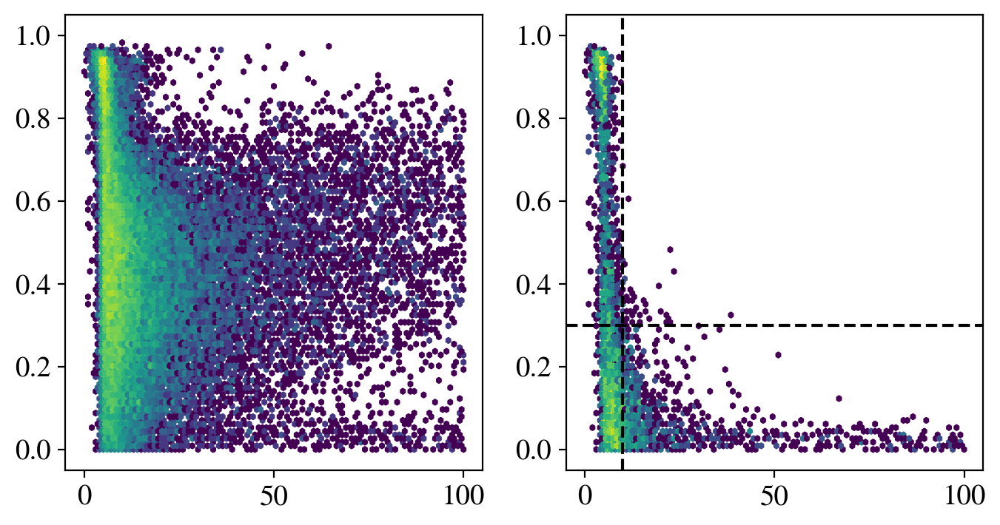

In [149]:
fig, ax = plt.subplots(ncols=2, figsize=(8,4))

# near_table = table[table['sep'] < 0.5]
cmodel_snr = table['i_cModelFlux']/table['i_cModelFluxErr']
ax[0].hexbin(cmodel_snr, table['res'], extent=(0, 100, 0, 1), bins='log')

star_filt = np.logical_or.reduce((table['i_extendedness'] == 0,
                                  table['refExtendedness'] == 0))
ax[1].hexbin(cmodel_snr[star_filt], table['res'][star_filt], extent=(0, 100, 0, 1), bins='log')
ax[1].axvline(10, ls='--', color='k')
ax[1].axhline(0.3, ls='--', color='k')
# ax.plot(cmodel_snr, near_table['res'], '.')
# ax.set_xlim(0, 100)
# ax.set_ylim(0, 1)

In [150]:
wl_filt = get_wlfilt(table, mag_lim=23.76, bright_lim=18, SNR=0, apply_extend=True)
wl_table = table[wl_filt]

After WL cuts: 16075


Text(0.5, 1.0, 'Distribution of Galaxy Magnitudes')

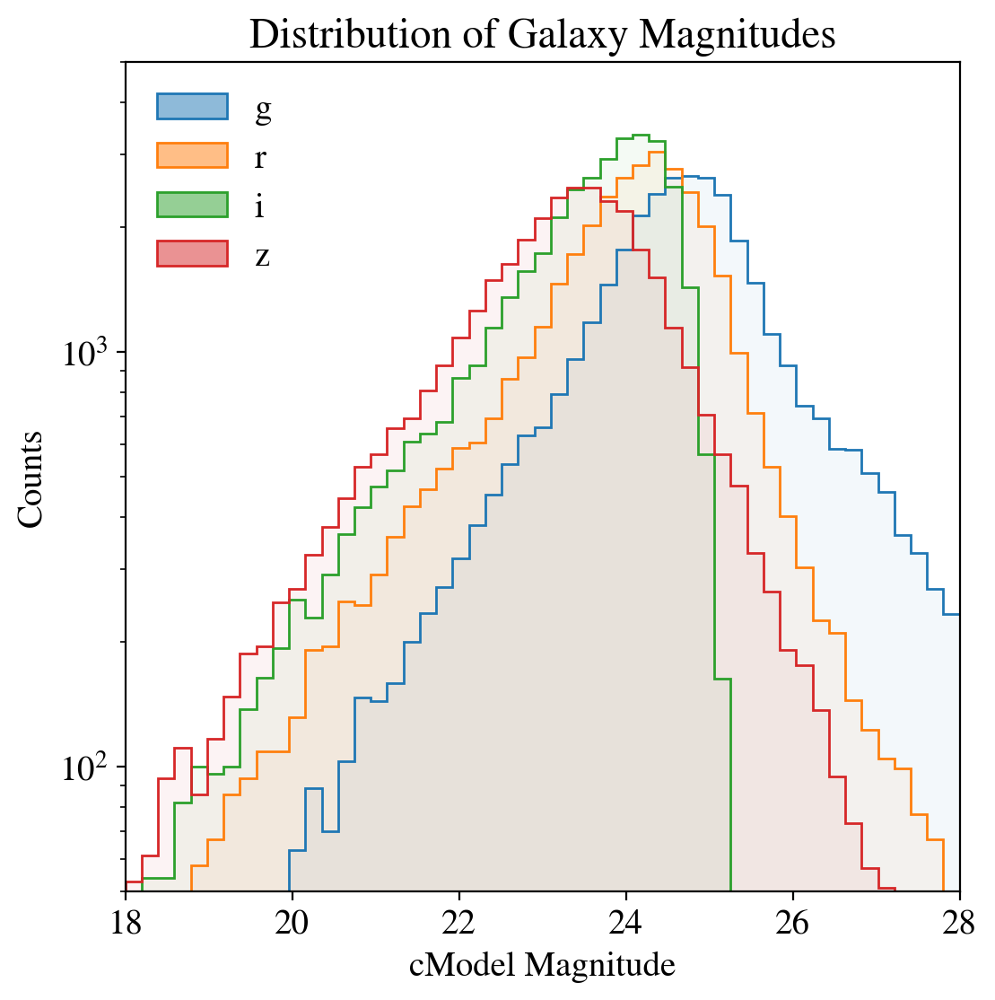

In [151]:
fig, ax = plt.subplots(ncols=1, figsize=(6,6))

near_table = table[np.logical_and(table['sep'] < 0.5, table['refExtendedness']==1)]
cmap = cm.tab10
band_list = 'griz'
legend_elems = [Patch(facecolor=cmap(i, 0.5), edgecolor=cmap(i), label=band) for i,band in enumerate(band_list)]
# band_lims = [25.3, 24.9, 24.5, 24.0]
# band_lims = [24.9, 24.4, 24.2, 23.5]
for i in range(4):
    band = band_list[i]
    ax.hist(near_table[f'{band}_cModel_mag'], range=(18, 28), bins=51, histtype='step', label=band);
    ax.hist(near_table[f'{band}_cModel_mag'], range=(18, 28), color=cmap(i), bins=51, histtype='stepfilled', alpha=0.05);
    # ax.axvline(band_lims[i], ls='-', alpha=1, color=cmap(i), label=f'{band} = {band_lims[i]}')
ax.set_xlim(18, 28)
ax.set_ylim(5e1, 5e3)
ax.set_xlabel('cModel Magnitude')
ax.semilogy()
# ax.legend(frameon=False, loc='upper left')
ax.legend(frameon=False, handles=legend_elems, loc='upper left')
ax.set_ylabel("Counts", x=0.05)
ax.set_title("Distribution of Galaxy Magnitudes")
# plt.savefig('./figs/galaxy_dist.png', dpi=450)

In [152]:
# fig, ax = plt.subplots(ncols=1, figsize=(6,6))

# near_table = table[np.logical_and(table['sep'] < 0.5]
# cmap = cm.tab10
# band_list = 'griz'
# legend_elems = [Patch(facecolor=cmap(i, 0.5), edgecolor=cmap(i), label=band) for i,band in enumerate(band_list)]
# # band_lims = [25.3, 24.9, 24.5, 24.0]
# # band_lims = [24.9, 24.4, 24.2, 23.5]
# for i in range(4):
#     band = band_list[i]
#     ax.hist(near_table[f'{band}_cModel_mag'], range=(18, 28), bins=51, histtype='step', label=band);
#     ax.hist(near_table[f'{band}_cModel_mag'], range=(18, 28), color=cmap(i), bins=51, histtype='stepfilled', alpha=0.05);
#     # ax.axvline(band_lims[i], ls='-', alpha=1, color=cmap(i), label=f'{band} = {band_lims[i]}')
# ax.set_xlim(18, 28)
# ax.set_ylim(5e1, 5e3)
# ax.set_xlabel('cModel Magnitude')
# ax.semilogy()
# # ax.legend(frameon=False, loc='upper left')
# ax.legend(frameon=False, handles=legend_elems, loc='upper left')
# ax.set_ylabel("Counts", x=0.05)
# ax.set_title("Distribution of Galaxy Magnitudes")
# # plt.savefig('./figs/galaxy_dist.png', dpi=450)

## Color Cut

### Red Sequence

We can identify the cluster members by plotting a color magnitude diagram 

1693


Text(0.5, 0.01, 'cModel $i$-mag')

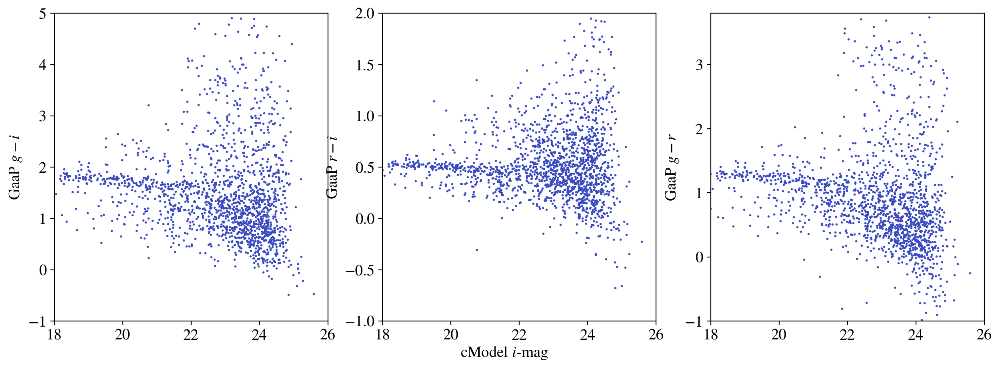

In [153]:
fig, ax = plt.subplots(ncols=3, figsize=(15, 5)) 

rs_table = table[np.logical_and(table['sep'] < 6/60, table['refExtendedness']==1)]
print(len(rs_table))

color_names = ['gi', 'ri', 'gr']
col_name = ['$g-i$', '$r-i$', '$g-r$']
cmap = cm.coolwarm
for i in range(3):
    col = color_names[i]
    ax[i].scatter(rs_table['i_cModel_mag'], rs_table[col], marker='.', s=4, color=cmap(0))
    # ax[i].scatter(rs_table['r_cModel_mag'], rs_table[col], c=rs_table['sep'], marker='.', s=4)
    ax[i].set_ylabel(f'GaaP {col_name[i]}')
    ax[i].set_xlim(18, 26)

ax[0].set_ylim(-1, 5)
ax[1].set_ylim(-1, 2)
ax[2].set_ylim(-1, 3.8)

# ax[0].axline((18, 1.9+0.1 + delta), slope=-0.2/5, ls='--', color=cmap(1.0), alpha=0.2)
# ax[0].axline((18, 1.9-0.25 - delta), slope=-0.2/5, ls='--', color=cmap(1.0), alpha=0.2)

# ax[1].axline((18, .55+0.04 + delta), slope=-0.1/5, ls='--', color=cmap(1.0), alpha=0.2)
# ax[1].axline((18, .55-0.08 - delta), slope=-0.1/5, ls='--', color=cmap(1.0), alpha=0.2)

# ax[2].axline((18, 1.35+0.1 + delta), slope=-0.25/5, ls='--', color=cmap(1.0), alpha=0.2)
# ax[2].axline((18, 1.35-0.15 - delta), slope=-0.25/5, ls='--', color=cmap(1.0), alpha=0.2)

fig.supxlabel(r"cModel $i$-mag")

In [154]:
# table, table_plus, table_neg, rs_table_upper, rs_table_lower = apply_redsequence_noisy(table, sigma=1.5, mag_lim=23.76)
delta = 0.05
table = apply_redsequence_noisy(table, sigma=1, mag_lim=23.76, bright_lim=18, delta=delta)

473 656 467


Text(0.5, 0.01, 'cModel $i$-mag')

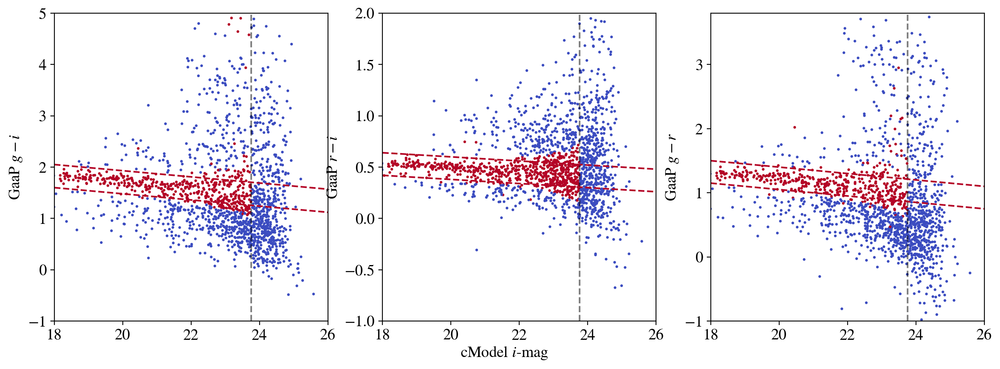

In [155]:
fig, ax = plt.subplots(ncols=3, figsize=(15, 5))

rs_table = table[np.logical_and(table['sep'] < 6/60, table['refExtendedness']==1)]
print(np.sum(rs_table['gi_redseq']), np.sum(rs_table['ri_redseq']), np.sum(rs_table['gr_redseq']))

cmap = cm.coolwarm
color_names = ['gi', 'ri', 'gr']
col_name = ['$g-i$', '$r-i$', '$g-r$']
for i in range(3):
    col = color_names[i]
    col_filt = rs_table[f'{col}_redseq']
    # col_filt = np.logical_or(redseq_err[i], rs_table[f'{col}_redseq'])
    ax[i].scatter(rs_table['i_cModel_mag'], rs_table[col], marker='.', s=8, c=col_filt, cmap=cmap)
    ax[i].set_ylabel(f'GaaP {col_name[i]}')
    ax[i].set_xlim(18, 26)
    # ax[i].axvline(20, ls='--', color='k', alpha=0.5)
    ax[i].axvline(23.76, ls='--', color='k', alpha=0.5)

ax[0].set_ylim(-1, 5)
ax[1].set_ylim(-1, 2)
ax[2].set_ylim(-1, 3.8)

ax[0].axline((18, 1.9+0.1 + delta), slope=-0.3/5, ls='--', color=cmap(1.0))
ax[0].axline((18, 1.9-0.25 - delta), slope=-0.3/5, ls='--', color=cmap(1.0))

ax[1].axline((18, .55+0.04 + delta), slope=-0.1/5, ls='--', color=cmap(1.0))
ax[1].axline((18, .55-0.08 - delta), slope=-0.1/5, ls='--', color=cmap(1.0))

ax[2].axline((18, 1.35+0.1 + delta), slope=-0.25/5, ls='--', color=cmap(1.0))
ax[2].axline((18, 1.35-0.15 - delta), slope=-0.25/5, ls='--', color=cmap(1.0))

fig.supxlabel(r"cModel $i$-mag")

473 656 467


Text(0.5, 0.05, 'cModel $i$-mag')

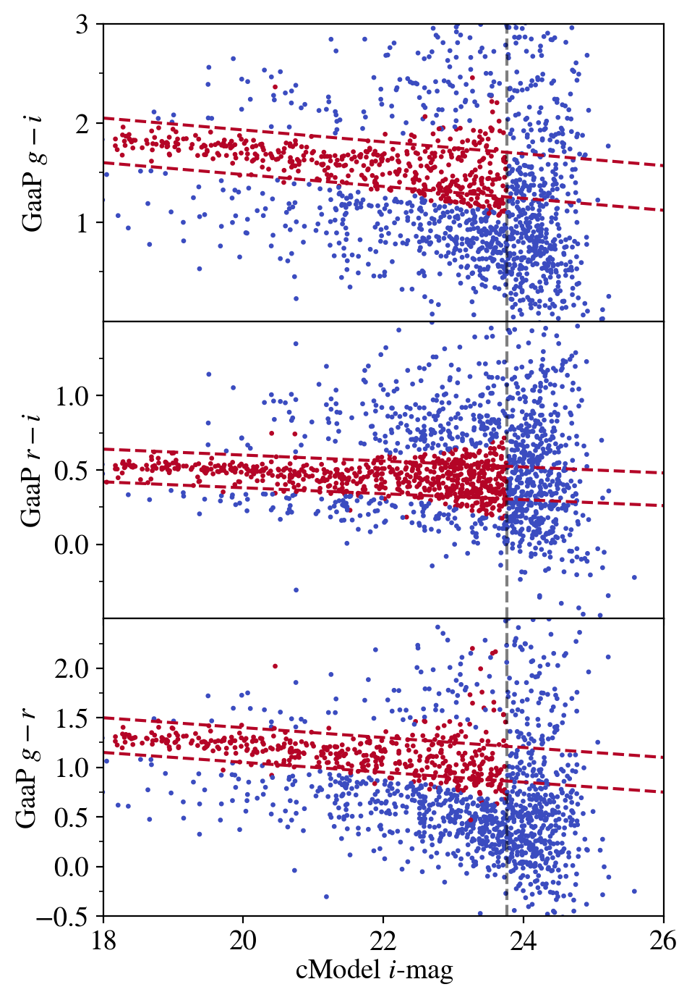

In [156]:
# fig, ax = plt.subplots(nrows=3, figsize=(5, 10), sharex=True)
fig = plt.figure(figsize=(5,8))
gs = fig.add_gridspec(nrows=3, hspace=0)
ax = gs.subplots(sharex=True)

rs_table = table[np.logical_and(table['sep'] < 6/60, table['refExtendedness']==1)]
print(np.sum(rs_table['gi_redseq']), np.sum(rs_table['ri_redseq']), np.sum(rs_table['gr_redseq']))

cmap = cm.coolwarm
color_names = ['gi', 'ri', 'gr']
col_name = ['$g-i$', '$r-i$', '$g-r$']

lpads = [13,4,-4]
for i in range(3):
    col = color_names[i]
    col_filt = rs_table[f'{col}_redseq']
    # col_filt = np.logical_or(redseq_err[i], rs_table[f'{col}_redseq'])
    ax[i].scatter(rs_table['i_cModel_mag'], rs_table[col], marker='.', s=8, c=col_filt, cmap=cmap)
    ax[i].set_ylabel(f'GaaP {col_name[i]}', labelpad=lpads[i])
    ax[i].set_xlim(18, 26)
    # ax[i].axvline(20, ls='--', color='k', alpha=0.5)
    ax[i].axvline(23.76, ls='--', color='k', alpha=0.5)

ax[0].set_ylim(0, 3)
ax[1].set_ylim(-0.5, 1.5)
ax[2].set_ylim(-0.5, 2.5)

ax[0].set_yticks([1.0,2.0,3.0], minor=False)
ax[0].set_yticks([0.5, 1.5, 2.5], minor=True)
ax[1].set_yticks([0, 0.5, 1])
ax[1].set_yticks([-0.25, 0.25, 0.75, 1.25], minor=True)
ax[2].set_yticks([-0.5, 0, 0.5, 1, 1.5, 2])
ax[2].set_yticks([-0.25, 0.25, 0.75, 1.25, 1.75, 2.25], minor=True)

ax[0].axline((18, 1.9+0.1 + delta), slope=-0.3/5, ls='--', color=cmap(1.0))
ax[0].axline((18, 1.9-0.25 - delta), slope=-0.3/5, ls='--', color=cmap(1.0))

ax[1].axline((18, .55+0.04 + delta), slope=-0.1/5, ls='--', color=cmap(1.0))
ax[1].axline((18, .55-0.08 - delta), slope=-0.1/5, ls='--', color=cmap(1.0))

ax[2].axline((18, 1.35+0.1 + delta), slope=-0.25/5, ls='--', color=cmap(1.0))
ax[2].axline((18, 1.35-0.15 - delta), slope=-0.25/5, ls='--', color=cmap(1.0))

fig.supxlabel(r"cModel $i$-mag", y=0.05)

473 656 467


Text(0.5, 0.05, 'cModel $i$-mag')

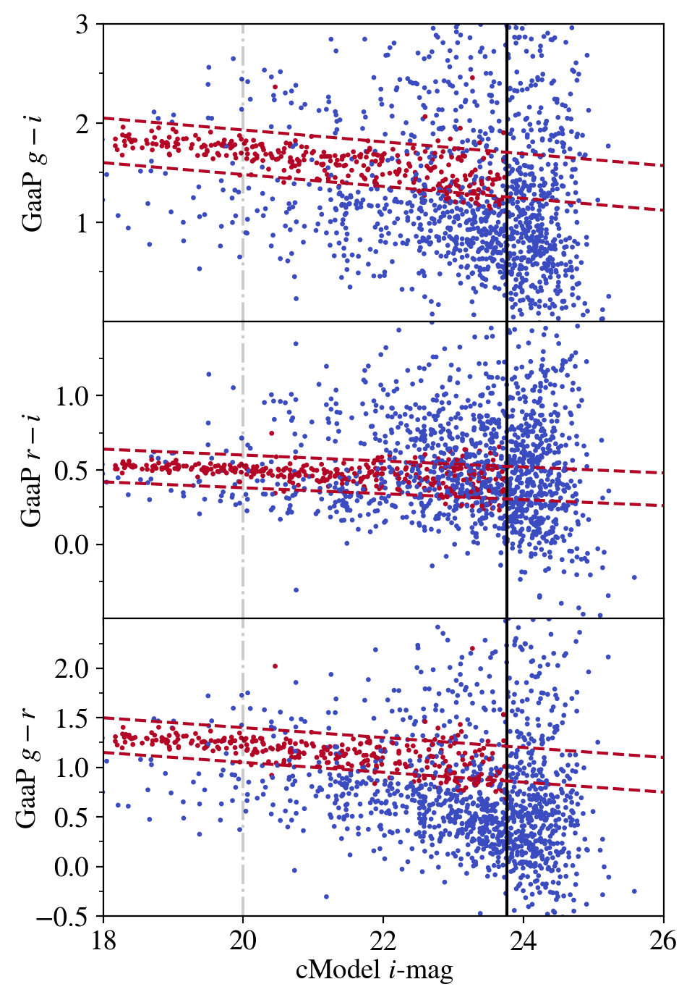

In [157]:
# fig, ax = plt.subplots(nrows=3, figsize=(5, 10), sharex=True)
fig = plt.figure(figsize=(5,8))
gs = fig.add_gridspec(nrows=3, hspace=0)
ax = gs.subplots(sharex=True)

rs_table = table[np.logical_and(table['sep'] < 6/60, table['refExtendedness']==1)]
print(np.sum(rs_table['gi_redseq']), np.sum(rs_table['ri_redseq']), np.sum(rs_table['gr_redseq']))

cmap = cm.coolwarm
color_names = ['gi', 'ri', 'gr']
col_name = ['$g-i$', '$r-i$', '$g-r$']

lpads = [13,4,-4]
for i in range(3):
    col = color_names[i]
    col_filt = rs_table[f'all_redseq'] & (rs_table['i_cModel_mag'] < 23.76)
    # col_filt = np.logical_or(redseq_err[i], rs_table[f'{col}_redseq'])
    ax[i].scatter(rs_table['i_cModel_mag'], rs_table[col], marker='.', s=8, c=col_filt, cmap=cmap)
    ax[i].set_ylabel(f'GaaP {col_name[i]}', labelpad=lpads[i])
    ax[i].set_xlim(18, 26)
    ax[i].axvline(20, ls='-.', color='k', alpha=0.2)
    ax[i].axvline(23.76, ls='-', color='k')

ax[0].set_ylim(0, 3)
ax[1].set_ylim(-0.5, 1.5)
ax[2].set_ylim(-0.5, 2.5)

ax[0].set_yticks([1.0,2.0,3.0], minor=False)
ax[0].set_yticks([0.5, 1.5, 2.5], minor=True)
ax[1].set_yticks([0, 0.5, 1])
ax[1].set_yticks([-0.25, 0.25, 0.75, 1.25], minor=True)
ax[2].set_yticks([-0.5, 0, 0.5, 1, 1.5, 2])
ax[2].set_yticks([-0.25, 0.25, 0.75, 1.25, 1.75, 2.25], minor=True)

ax[0].axline((18, 1.9+0.1 + delta), slope=-0.3/5, ls='--', color=cmap(1.0))
ax[0].axline((18, 1.9-0.25 - delta), slope=-0.3/5, ls='--', color=cmap(1.0))

ax[1].axline((18, .55+0.04 + delta), slope=-0.1/5, ls='--', color=cmap(1.0))
ax[1].axline((18, .55-0.08 - delta), slope=-0.1/5, ls='--', color=cmap(1.0))

ax[2].axline((18, 1.35+0.1 + delta), slope=-0.25/5, ls='--', color=cmap(1.0))
ax[2].axline((18, 1.35-0.15 - delta), slope=-0.25/5, ls='--', color=cmap(1.0))

fig.supxlabel(r"cModel $i$-mag", y=0.05)

152 181 145


Text(0.5, 0.01, 'cModel $i$-mag')

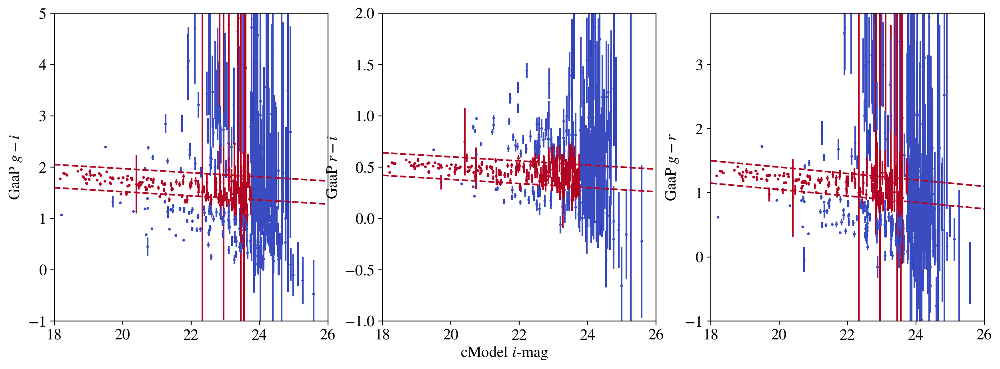

In [158]:
fig, ax = plt.subplots(ncols=3, figsize=(15, 5))

rs_table = table[np.logical_and(table['sep'] < 3/60, table['refExtendedness']==1)]
print(np.sum(rs_table['gi_redseq']), np.sum(rs_table['ri_redseq']), np.sum(rs_table['gr_redseq']))

cmap = cm.coolwarm
color_names = ['gi', 'ri', 'gr']
col_name = ['$g-i$', '$r-i$', '$g-r$']
for i in range(3):
    col = color_names[i]
    col_filt = rs_table[f'{col}_redseq']
    # col_filt = np.logical_or(redseq_err[i], rs_table[f'{col}_redseq'])
    ax[i].scatter(rs_table['i_cModel_mag'], rs_table[col], marker='.', s=8, c=col_filt, cmap=cmap)
    ax[i].vlines(rs_table['i_cModel_mag'],rs_table[col+'_neg'],  rs_table[col+'_plus'], color=cmap((col_filt).astype(float)))
    ax[i].set_ylabel(f'GaaP {col_name[i]}')
    ax[i].set_xlim(18, 26)

ax[0].axline((18, 1.9+0.1 + delta), slope=-0.2/5, ls='--', color=cmap(1.0))
ax[0].axline((18, 1.9-0.25 - delta), slope=-0.2/5, ls='--', color=cmap(1.0))

ax[1].axline((18, .55+0.04 + delta), slope=-0.1/5, ls='--', color=cmap(1.0))
ax[1].axline((18, .55-0.08 - delta), slope=-0.1/5, ls='--', color=cmap(1.0))

ax[2].axline((18, 1.35+0.1 + delta), slope=-0.25/5, ls='--', color=cmap(1.0))
ax[2].axline((18, 1.35-0.15 - delta), slope=-0.25/5, ls='--', color=cmap(1.0))

ax[0].set_ylim(-1, 5)
ax[1].set_ylim(-1, 2)
ax[2].set_ylim(-1, 3.8)
fig.supxlabel(r"cModel $i$-mag")

487


Text(0.5, 0.01, 'cModel $i$-mag')

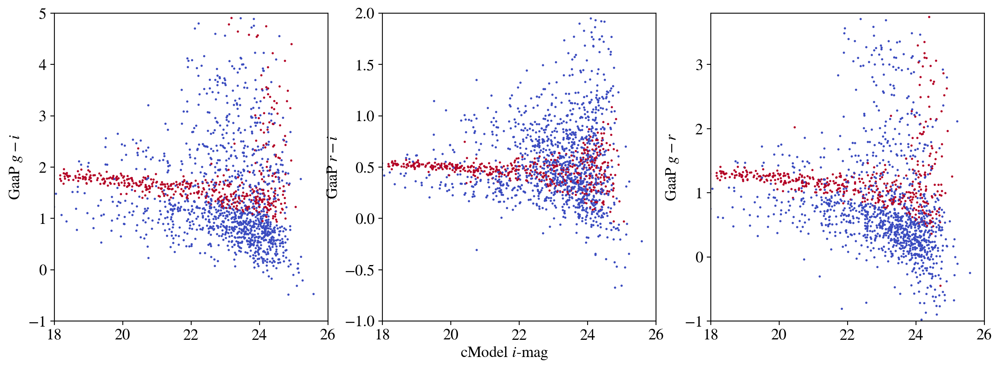

In [159]:
fig, ax = plt.subplots(ncols=3, figsize=(15, 5))

rs_table = table[np.logical_and(table['sep'] < 0.1, table['refExtendedness']==1)]
print(np.sum(rs_table['all_redseq']))
cmap = cm.coolwarm
color_names = ['gi', 'ri', 'gr']
col_name = ['$g-i$', '$r-i$', '$g-r$']
for i in range(3):
    col = color_names[i]
    ax[i].scatter(rs_table['i_cModel_mag'], rs_table[col], marker='.', s=4, c=rs_table[f'all_redseq'], cmap=cmap)
    ax[i].set_ylabel(f'GaaP {col_name[i]}')
    ax[i].set_xlim(18, 26)

ax[0].set_ylim(-1, 5)
ax[1].set_ylim(-1, 2)
ax[2].set_ylim(-1, 3.8)
fig.supxlabel(r"cModel $i$-mag")

In [63]:
wl_filt = get_wlfilt(table, mag_lim=23.76, bright_lim=20, SNR=10, apply_extend=True, apply_blendness=False)
# table = table[wl_filt]

After WL cuts: 14656


In [125]:
test_table = table[wl_filt & ~table['all_redseq']]

NameError: name 'table' is not defined

In [65]:
55/12595

0.004366812227074236

In [66]:
Nobj = len(table)
Nrs = np.sum(table['all_redseq'])
print(Nrs, Nobj-Nrs)

8055 34697


### Write Tables

In [67]:

# outdir

In [68]:
# Apply cuts
cut_types = ['none', 'all', 'ri', 'gr', 'gi']
wl_filt = get_wlfilt(table, mag_lim=23.76)
for ct in cut_types:
    if ct=='none':
        filt = wl_filt
    else:
        filt = np.logical_and(wl_filt,  ~(table[f'{ct}_redseq']))
    print(f"After {ct} cuts: {np.sum(filt)}")
    source_table = table[filt]
    source_table.meta = {}
    # if ct=='none':
    # source_table.write(f'{outdir}/abell360_POSTCUTS_{ct}noisy_masked_DP1.fits', format="fits", overwrite=True)

After WL cuts: 14656
After none cuts: 14656
After all cuts: 12595
After ri cuts: 7602
After gr cuts: 10091
After gi cuts: 10381


In [288]:
wl_test = Table.read(f'{outdir}/abell360_POSTCUTS_allnoisy_masked_DP1.fits')

## Photo-z Cuts

Another way for us to obtain the source sample is by removing objects that have $z \leq 0.22$ which we can do using photometric redshift estimates.
Here we load in both the point estimates and the $P(z)$ distributions for each object.

In [116]:
# # Get point estimates for the entire field (169034 objects)
pz_ests = pd.read_parquet(pz_sv38_point)
pz_ests = Table.from_pandas(pz_ests)

In [117]:
method_list = ['fzboost', 'knn', 'cmnn', 'dnf', 'tpz', 'gpz', 'bpz', 'lephare']

for algo in method_list:
    zwidth = np.abs(pz_ests[f'{algo}_z_err95_high'] - pz_ests[f'{algo}_z_err95_low'])
    pz_ests[algo+'_diff'] = zwidth

In [118]:
# We could load this in via butler we did save this earlier :)
# This is the cleaned catalog that removed entries if any of the measurement algorithms failed.
# dp1_catalog = Table.read('cluster_data/abell360_PRECUTS_DP1_new.fits', format="fits")
# dp1_catalog, _ = load_pz_photomdata(ddir='/global/cfs/cdirs/lsst/groups/PZ/DP1/data/dp1_v29.0.0/', suffix='parquet')
dp1_catalog, _ = load_pz_photomdata(clean_fn=preclean_filt)
# dp1_catalog, _ = load_pz_photomdata(clean_fn=preclean_flux_filt)
# dp1_catalog = Table.read('cluster_data/abell360_PRECUTS_DP1_gaap_cModel.fits', format="fits")

/opt/lsst/software/stack/conda/envs/lsst-scipipe-12.1.0/lib/python3.13/site-packages/astropy/units/function/logarithmic.py:67: RuntimeWarning: divide by zero encountered in log10
  return dex.to(self._function_unit, np.log10(x))
/opt/lsst/software/stack/conda/envs/lsst-scipipe-12.1.0/lib/python3.13/site-packages/astropy/units/function/logarithmic.py:67: RuntimeWarning: invalid value encountered in log10
  return dex.to(self._function_unit, np.log10(x))


In [119]:
pz_table = join(dp1_catalog, pz_ests, keys='objectId')

In [76]:
# The P(z) PDFs are stored in a qp file which we can access via the get_pdfs function
# This contains the PDFs for all objects in the field which would be too much data to
# load in this notebook. We only want the PDFs for the objects that have passed our
# basic quality cuts.

clean_pz_ids = pz_table['objectId']
all_pz_ids = pz_ests['objectId']
big_pz_filt = np.isin(all_pz_ids, clean_pz_ids)
# big_pz_filt = [k in clean_pz_ids for k in pz_ests['objectId']]


In [77]:
xs = np.linspace(0, 3, 301)

### Entire Sample $N(z)$

In [75]:
plot_algs = ['bpz', 'dnf', 'fzboost', 'knn']
quality_pdfs = []

for alg in plot_algs:
    new_filt = np.logical_and(big_pz_filt, pz_ests[f'{alg}_diff'] < 0.25)
    print(f"On {alg} we have {np.sum(new_filt)}")
    pdf, _, xs = get_pdfs(alg, new_filt, pz_dir=pz_sv38_pdf_dir)
    c = gc.collect()
    # pdf, _, xs = get_pdfs(alg, big_pz_filt)
    quality_pdfs.append(pdf)

On bpz we have 7850
On dnf we have 17441
On fzboost we have 14376
On knn we have 15384


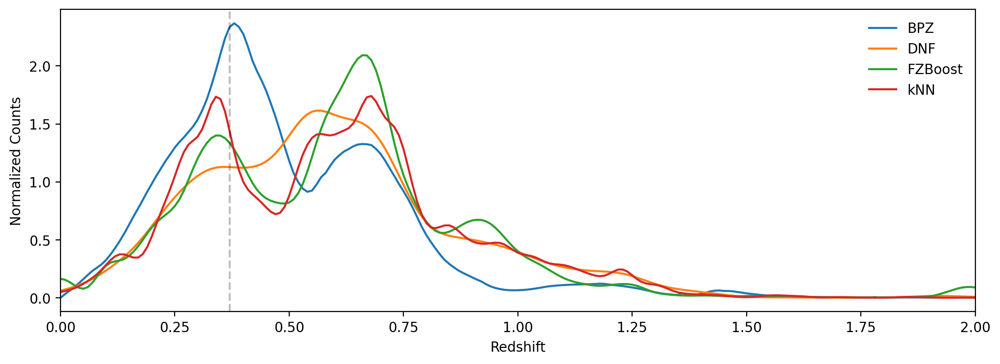

In [149]:
fig, ax = plt.subplots(1, figsize=(12, 4))

label = ['BPZ', 'DNF', 'FZBoost', 'kNN']
for i, alg in enumerate(plot_algs):
    ax.plot(xs, quality_pdfs[i], label=label[i])

ax.legend(frameon=False)
ax.set_xlim(0, 2)
ax.set_xlabel("Redshift")
ax.set_ylabel("Normalized Counts")
ax.axvline(0.37, ls='--', color='k', alpha=0.25)
# ax.set_title("N(z) with $\\sigma_z \\leq 0.25$")
# ax.set_title("N(z) with Quality Cuts")

### Write Tables

Save the photo-z subsets

In [78]:
pz_mask = get_masks(pz_table)
pz_table = pz_table[pz_mask]

In [79]:
# pz_wlfilt = get_wlfilt(pz_table, apply_sep=True, bright_lim=20, mag_lim=23.76)
pz_wlfilt = get_wlfilt(pz_table, apply_sep=True, bright_lim=15, mag_lim=25)
pz_wltable = pz_table[pz_wlfilt]
_ = apply_redsequence_noisy(pz_wltable, mag_lim=23.76, sigma=1)

After WL cuts: 14091


In [108]:
# pz_wltable.write('cluster_data/wl_pztable_new.fits', format='fits', overwrite=True)

# write_pz_wltable = pz_wltable[~pz_wltable['all_redseq']]

# write_pz_wltable.write('cluster_data/wl_pztable_new_nors.fits', format='fits', overwrite=True)

In [334]:
# Apply cuts
# pz_algs = ['knn', 'tpz', 'cmnn', 'gpz', 'bpz', 'dnf', 'fzboost', 'lephare']
pz_algs = ['bpz', 'tpz', 'fzboost', 'knn', 'gpz', 'dnf', 'lephare', 'cmnn']
pz_cutoff = 0.37
# pz_cutoff2 = 0.65

for alg in pz_algs:
    central = 'median' if alg=='knn' else 'mean'

    filt = pz_wltable[f'{alg}_z_{central}'] > pz_cutoff
    if not (alg=='gpz'):
        filt &= pz_wltable[f'{alg}_diff'] < 2.5
    filt &= ~pz_wltable['all_redseq']
    print(f"After cuts: {np.sum(filt)}")
    source_table = pz_wltable[filt]
    source_table.write(f'{outdir}/abell360_POSTCUTS_{alg}0.37_masked_DP1_widepz.fits', format="fits", overwrite=True)

After cuts: 8854
After cuts: 9018
After cuts: 7913
After cuts: 6917
After cuts: 10814
After cuts: 9469
After cuts: 4950
After cuts: 4783


Save subsets for the shear-ratio plot

In [325]:
# # Apply cuts
# pz_algs = ['knn', 'tpz', 'cmnn', 'gpz', 'bpz', 'dnf', 'fzboost', 'lephare']
# pz_cutoff1 = 0.37
# pz_cutoff2 = 0.65

# pz_wlfilt = get_wlfilt(pz_table)

# for alg in pz_algs:
#     central = 'median' if alg=='knn' else 'mean'

#     filt = np.logical_and(pz_wlfilt, pz_table[f'{alg}_z_{central}'] > pz_cutoff)
#     filt &= pz_table[f'{alg}_z_{central}'] < pz_cutoff2 # Change this from < to > when doing bin1 or bin2
#     if not (alg=='gpz'):
#         filt &= pz_table[f'{alg}_diff'] < 0.25

#     print(f"After cuts: {np.sum(filt)}")
#     source_table = pz_table[filt]
#     source_table.write(f'{outdir}/shear-ratio_{alg}bin1_DP1.fits', format="fits", overwrite=True)

In [91]:
# quality_pdfs = np.array(quality_pdfs)

# quality_pdfs.shape

# np.save('cluster_data/technote/nz/colorcuts_nz_noquality.npy', quality_pdfs)

In [76]:
delta = 0.05
_ = apply_redsequence_noisy(pz_table, mag_lim=23.76, sigma=1, delta=delta)

1543


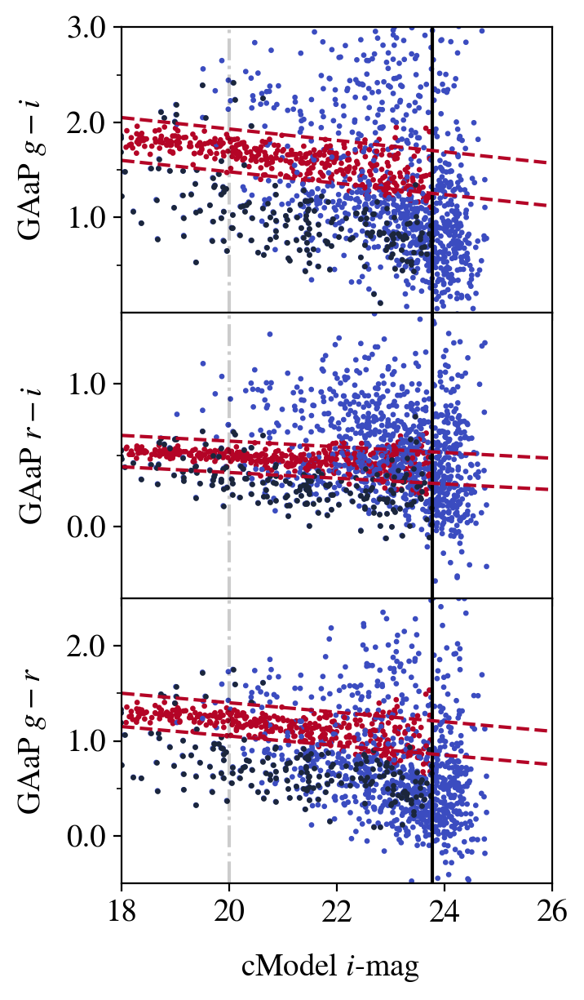

In [84]:
# fig, ax = plt.subplots(nrows=3, figsize=(5, 10), sharex=True)
fig = plt.figure(figsize=(3.406, 3.406*2))
gs = fig.add_gridspec(nrows=3, hspace=0)
ax = gs.subplots(sharex=True)

rs_table = pz_table[np.logical_and(pz_table['sep'] < 6/60, pz_table['refExtendedness']==1)]
print(len(rs_table))
# print(np.sum(pz_wltable['gi_redseq']), np.sum(pz_wltable['ri_redseq']), np.sum(rs_table['gr_redseq']))

cmap = cm.coolwarm
# cmap = cm.seismic
cm_dict = {0: cmap(0),
           1: cmap(1),
           0.5: '#999999'}
color_names = ['gi', 'ri', 'gr']
col_name = ['$g-i$', '$r-i$', '$g-r$']

lpads = [8,8.1,8]
for i in range(3):
    col = color_names[i]
    col_bool = (rs_table[f'all_redseq'] & (rs_table['i_cModel_mag'] < 23.76))
    pz_cuts = ((rs_table['dnf_z_median'] < 0.37) | (rs_table['dnf_diff'] > 2.5)) & (~col_bool) & (rs_table['i_cModel_mag'] < 23.76)
    col_filt = col_bool.astype(float)
    # col_filt[pz_cuts] = 0.5
    # col_filt = np.logical_or(redseq_err[i], rs_table[f'{col}_redseq'])
    ax[i].scatter(rs_table['i_cModel_mag'], rs_table[col], marker='.', s=8, c=col_filt, cmap=cmap)
    ax[i].scatter(rs_table['i_cModel_mag'][pz_cuts], rs_table[col][pz_cuts], marker='.', s=8, c='#1b263b')
    ax[i].set_ylabel(f'GAaP {col_name[i]}', labelpad=lpads[i])
    ax[i].set_xlim(18, 26)
    ax[i].axvline(20, ls='-.', color='k', alpha=0.2)
    ax[i].axvline(23.76, ls='-', color='k')

ax[0].set_ylim(0, 3)
ax[1].set_ylim(-0.5, 1.5)
ax[2].set_ylim(-0.5, 2.5)

ax[0].set_yticks([1.0,2.0,3.0], ["1.0", "2.0", "3.0"], minor=False)
ax[0].set_yticks([0.5, 1.5, 2.5], minor=True)
ax[1].set_yticks([0.0, 1.0], ["0.0", "1.0"])
ax[1].set_yticks([0.5], minor=True)


# ax[1].set_yticks([0.0, 0.5, 1.0])
# ax[1].set_yticks([-0.25, 0.25, 0.75, 1.25], minor=True)
# ax[2].set_yticks([-0.5, 0, 0.5, 1, 1.5, 2])
# ax[2].set_yticks([-0.25, 0.25, 0.75, 1.25, 1.75, 2.25], minor=True)
ax[2].set_yticks([0.0, 1.0, 2.0], ["0.0", "1.0", "2.0"])
ax[2].set_yticks([0.5, 1.5], minor=True)
# ax[2].set_yticks([-0.25, 0.25, 0.75, 1.25, 1.75, 2.25], minor=True)

ax[0].axline((18, 1.9+0.1 + delta), slope=-0.3/5, ls='--', color=cmap(1.0))
ax[0].axline((18, 1.9-0.25 - delta), slope=-0.3/5, ls='--', color=cmap(1.0))

ax[1].axline((18, .55+0.04 + delta), slope=-0.1/5, ls='--', color=cmap(1.0))
ax[1].axline((18, .55-0.08 - delta), slope=-0.1/5, ls='--', color=cmap(1.0))

ax[2].axline((18, 1.35+0.1 + delta), slope=-0.25/5, ls='--', color=cmap(1.0))
ax[2].axline((18, 1.35-0.15 - delta), slope=-0.25/5, ls='--', color=cmap(1.0))

fig.supxlabel(r"cModel $i$-mag", y=0.02)
# ax[2].set_xlabel(r"cModel $i$-mag")
# plt.tight_layout()
plt.savefig('figs/redseq_cuts.pdf', format='pdf', bbox_inches='tight')

## Color-Color Cuts

In [224]:
# match_cc = Table.read('/home/a/adari/u/clusters/data/match_desi.fits')
# bands = list('griz')
# for b in bands:
#     match_cc.rename_column(f'{b}_cModelMag', f'{b}_cModel_mag')
#     match_cc.rename_column(f'{b}_gaap1p0Mag', f'{b}_gaap_mag')

# match_cc = Table.read('cluster_data/desi_sv38_matches_big.fits')

# # match_cc['gi'] = match_cc['g_gaap1p0Mag'] - match_cc['i_gaap1p0Mag']
# # match_cc['ri'] = match_cc['r_gaap1p0Mag'] - match_cc['i_gaap1p0Mag']
# # match_cc['gr'] = match_cc['g_gaap1p0Mag'] - match_cc['r_gaap1p0Mag']

# match_cc = apply_redsequence(match_cc, mag_lim=23.76)

# # # clean_filt = preclean_filt(preclean_table)
# # # print(len(preclean_table) - np.sum(clean_filt))
# # # clean_table = preclean_table[clean_filt]

# # # clean_table = apply_redsequence(clean_table, mag_lim=28)

# # # cmap = cubehelix_colormap(
# # #    start=0,
# # #    rot=-0.1,
# # #    gamma=1,
# # #    hue=5,
# # #    light=0.85,
# # #    dark=0.15,
# # #    name="test",
# # # )
# # # cmap_r = cmap.reversed()

# # # cmap_r

# # # imag_cut = wl_table[wl_table['i_cModel_mag'] < 23.76]
# # # imag_cut = apply_redsequence(imag_cut)

# # # fig, ax = plt.subplots(1, figsize=(6,6))

# # # # cmap = cm.coolwarm
# # # ax.hexbin(imag_cut['gr'] ,imag_cut['ri'])
# # # ax.scatter(match_cc['gr'], match_cc['ri'], s=8, c=match_cc['desi_z'], cmap=cmap_r)


# # # ax.set_xlim(-0.5, 2.5)
# # # ax.set_ylim(-0.5, 1.5)
# # # ax.set_xlabel("g-r")
# # # ax.set_ylabel("r-i")

# # fig, ax = plt.subplots(1, figsize=(6,6))

# # # cmap = cm.coolwarm
# # ax.hexbin(imag_cut['gi'] ,imag_cut['ri'])
# # ax.scatter(match_cc['gi'], match_cc['ri'], s=8, c=match_cc['desi_z'], cmap=cmap_r)


# # ax.set_xlim(-0.5, 2.5)
# # ax.set_ylim(-0.5, 1.5)
# # ax.set_xlabel("g-i")
# # ax.set_ylabel("r-i")

## SV 38-7 $N(z)$

In [294]:
# Get point estimates for the entire field (169034 objects)
pz_ests = pd.read_parquet(pz_sv38_point)
pz_ests = Table.from_pandas(pz_ests)
pz_diffs(pz_ests, pz_algos)

### Color-cuts $N(z)$

Can't read in the previous files since there might be some mismatch between the objectIds between the Butler DP1 and the statically written DP1 used in photo-zs.

In [295]:
# Load in PZ DP1 photometry and add the point estimates
# load_pz_photomdata applies the preclean_filt
dp1_catalog, _ = load_pz_photomdata(clean_fn=preclean_filt)
pz_table = join(pz_ests, dp1_catalog, keys='objectId')

/opt/lsst/software/stack/conda/envs/lsst-scipipe-12.0.0/lib/python3.13/site-packages/astropy/units/function/logarithmic.py:67: RuntimeWarning: divide by zero encountered in log10
  return dex.to(self._function_unit, np.log10(x))
/opt/lsst/software/stack/conda/envs/lsst-scipipe-12.0.0/lib/python3.13/site-packages/astropy/units/function/logarithmic.py:67: RuntimeWarning: invalid value encountered in log10
  return dex.to(self._function_unit, np.log10(x))


In [296]:
pz_mask = get_masks(pz_table)
pz_table = pz_table[pz_mask]

In [305]:
# Apply the WL Cuts
wl_pzfilt = get_wlfilt(pz_table, mag_lim=23.76, bright_lim=20)
wl_pztable = pz_table[wl_pzfilt]

After WL cuts: 12690


In [308]:
# Write the red-sequence
wl_pztable = apply_redsequence_noisy(wl_pztable, mag_lim=23.76, sigma=1)
# Remove red-sequence
wl_pztable = wl_pztable[~wl_pztable['all_redseq']]

In [322]:
# True for objects that SHOULD be in the weak lensing catalog
wl_pz_ids = wl_pztable['objectId']
all_pz_ids = pz_ests['objectId']
# wl_pz_filt = np.array([k in wl_pz_ids for k in pz_ests['objectId']])
wl_pz_filt = np.isin(all_pz_ids, wl_pz_ids)

In [323]:
wl_weights = get_weights(wl_pztable['i_hsmShapeRegauss_e1'], wl_pztable['i_hsmShapeRegauss_e2'],
                         wl_pztable['i_hsmShapeRegauss_sigma'], wl_pztable['i_hsmShapeRegauss_sigma'])

In [339]:
### pz_algs = ['bpz', 'tpz', 'fzboost', 'knn']
cc_cut_types = ['all', 'gi', 'ri', 'gr']
# cc_cut_types = ['all']
pz_algs = ['bpz', 'tpz', 'fzboost', 'knn', 'gpz', 'dnf', 'lephare', 'cmnn']

for cc in cc_cut_types[:1]:
    wl_pdfs = []
    for alg in pz_algs:
        central = 'median' if alg=='knn' else 'mean'
        cc_filt = np.isin(all_pz_ids, wl_pztable['objectId'][~wl_pztable[f'{cc}_redseq']])
        new_filt = np.logical_and(wl_pz_filt, cc_filt)
        print(f"On {alg} we have {np.sum(new_filt)}")
        pdf, sample_pdf, xs = get_pdfs(alg, new_filt, pz_dir = pz_sv38_pdf_dir)
        np.save(f'cluster_data/sv38_nz_{alg}_{cc}noisy_unweighted.npy', sample_pdf)
        wl_pdfs.append(pdf)
    wl_pdfs = np.array(wl_pdfs)
    # np.save(f'cluster_data/sv38_nz_{cc}noisy.npy', wl_pdfs)

On bpz we have 10839
On tpz we have 10839
On fzboost we have 10839
On knn we have 10839
On gpz we have 10839
On dnf we have 10839
On lephare we have 10839
On cmnn we have 10839


In [58]:
# np.save(f'cluster_data/sv38_nz_{cc}noisy.npy', wl_pdfs)

In [59]:
wl_pdfs = np.load('cluster_data/sv38_nz_allnoisy.npy')

Text(0.5, 1.0, 'SV_38_7 All Colors Red Sequence $N(z)$')

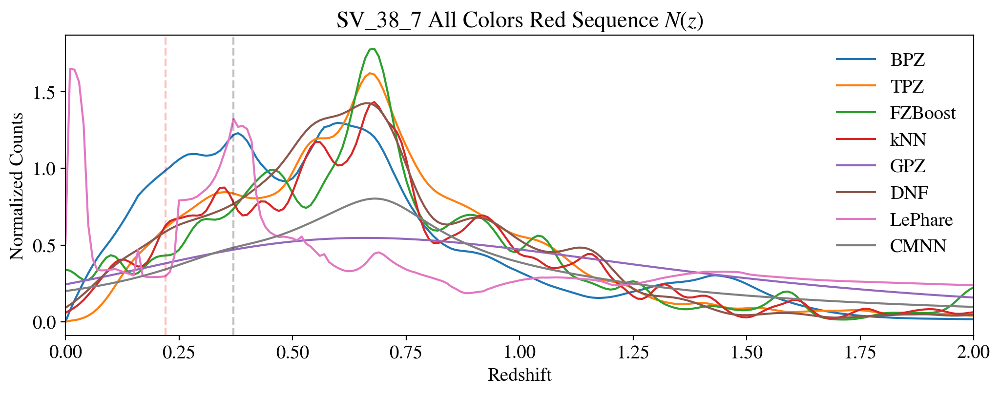

In [60]:
fig, ax = plt.subplots(1, figsize=(12, 4))

label = ['BPZ', 'TPZ', 'FZBoost', 'kNN', 'GPZ', 'DNF', 'LePhare', 'CMNN']

for i, alg in enumerate(pz_algs):
    ax.plot(xs, wl_pdfs[i], label=label[i])

ax.legend(frameon=False)
ax.set_xlim(0, 2)
ax.set_xlabel("Redshift")
ax.set_ylabel("Normalized Counts")
ax.axvline(0.22, ls='--', color='r', alpha=0.25)
ax.axvline(0.37, ls='--', color='k', alpha=0.25)
plt.title("SV_38_7 All Colors Red Sequence $N(z)$")
# ax.set_title("N(z) with $z \\geq 0.37$ and $\\sigma_z \\leq 0.25$")

### Photo-z Cut $N(z)$

In [61]:
# pz_algs = ['bpz', 'tpz', 'fzboost', 'knn']
pz_algs = ['bpz', 'tpz', 'fzboost', 'knn', 'gpz', 'dnf', 'lephare', 'cmnn']
# pz_algs = ['bpz', 'tpz', 'fzboost', 'knn', 'gpz', 'dnf', 'lephare', 'cmnn']


pz_cutoff = 0.22+0.15
wl_pdfs = []

for alg in pz_algs:
    # central = 'median' if alg=='knn' else 'mean'
    # new_filt = np.logical_and.reduce((wl_pz_filt, pz_ests[f'{alg}_z_{central}'] > pz_cutoff,
    #                                   pz_ests[f'{alg}_diff'] < 0.25))
    # new_filt = np.logical_and(wl_pz_filt, pz_ests[f'{alg}_z_{central}'] > pz_cutoff)
    # source_table = Table.read(f'{outdir}/abell360_POSTCUTS_{alg}0.37nq_masked_DP1.fits')
    source_table = Table.read(f'{outdir}/abell360_POSTCUTS_{alg}0.37_masked_DP1_widepz.fits')
    new_filt = np.isin(pz_ests['objectId'], source_table['objectId'])
    final_filt = new_filt
    print(f"On {alg} we have {np.sum(final_filt)}")
    pdf, sample_pdf, xs = get_pdfs(alg, final_filt, pz_dir = pz_sv38_pdf_dir)
    np.save(f'cluster_data/sv38_nz_{alg}_pzcut+allnoisy.npy', sample_pdf)

    wl_pdfs.append(pdf)

wl_pdfs = np.array(wl_pdfs)
np.save('cluster_data/sv38_nz_HSMwide_masked.npy', wl_pdfs)

On bpz we have 8854
On tpz we have 9018
On fzboost we have 7913
On knn we have 6917
On gpz we have 10814
On dnf we have 9469
On lephare we have 4950
On cmnn we have 4783


In [64]:
# wl_pdfs = np.load('cluster_data/sv38_nz_HSMnq_masked.npy')

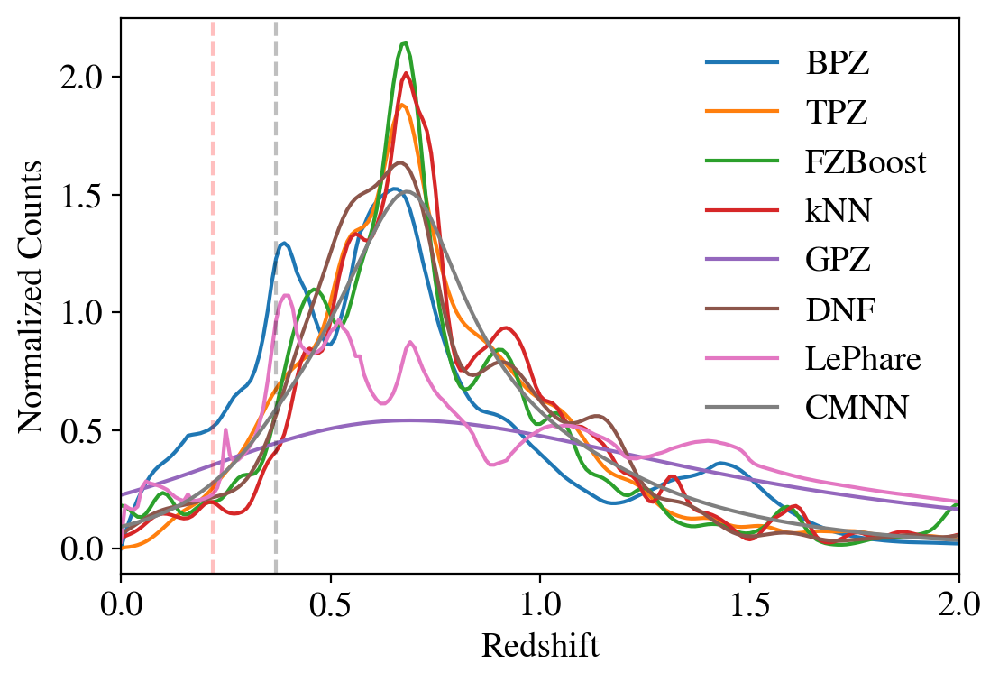

In [62]:
fig, ax = plt.subplots(1, figsize=(6, 4))

label = ['BPZ', 'TPZ', 'FZBoost', 'kNN', 'GPZ', 'DNF', 'LePhare', 'CMNN']

for i, alg in enumerate(pz_algs):
    ax.plot(xs, wl_pdfs[i], label=label[i])

ax.legend(frameon=False)
ax.set_xlim(0, 2)
ax.set_xlabel("Redshift")
ax.set_ylabel("Normalized Counts")
ax.axvline(0.22, ls='--', color='r', alpha=0.25)
ax.axvline(0.37, ls='--', color='k', alpha=0.25)
# ax.set_title("N(z) with $z \\geq 0.37$ and $\\sigma_z \\leq 0.25$")

#### Red Sequence Redshifts and N(z)s

In [241]:
pzo = pz_ests['objectId']

rs_ids = wl_pztable['objectId'][wl_pztable['all_redseq']]
rs_pz_filt = np.isin(all_pz_ids,rs_ids)

xs = np.linspace(0, 3, 301)

In [242]:
pz_algs = ['bpz', 'tpz', 'fzboost', 'knn']
quality_pdfs = [] 

for alg in pz_algs:
    new_filt = np.logical_and(rs_pz_filt, pz_ests[f'{alg}_diff'] < 0.25)
    print(f"On {alg} we have {np.sum(new_filt)}")
    pdf, _, xs = get_pdfs(alg, new_filt, pz_sv38_pdf_dir)

    # pdf, _, xs = get_pdfs(alg, big_pz_filt)
    quality_pdfs.append(pdf)

On bpz we have 1097
On tpz we have 968
On fzboost we have 726
On knn we have 776


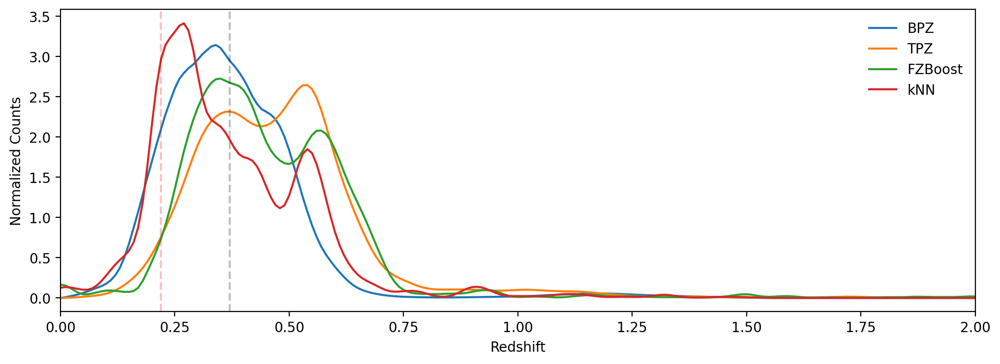

In [243]:
fig, ax = plt.subplots(1, figsize=(12, 4))

label = ['BPZ', 'TPZ', 'FZBoost', 'kNN']
for i, alg in enumerate(pz_algs):
    ax.plot(xs, quality_pdfs[i], label=label[i])

ax.legend(frameon=False)
ax.set_xlim(0, 2)
ax.set_xlabel("Redshift")
ax.set_ylabel("Normalized Counts")
ax.axvline(0.37, ls='--', color='k', alpha=0.25)
ax.axvline(0.22, ls='--', color='r', alpha=0.25)
# ax.set_title("N(z) with $\\sigma_z \\leq 0.25$")
# ax.set_title("N(z) with Quality Cuts")

#### DESI Matched


In [279]:
# match_cc = Table.read('/home/a/adari/u/clusters/data/match_desi.fits')
# bands = list('griz')
# for b in bands:
#     match_cc.rename_column(f'{b}_cModelMag', f'{b}_cModel_mag')
#     match_cc.rename_column(f'{b}_gaap1p0Mag', f'{b}_gaap_mag')

match_cc = Table.read('cluster_data/desi_sv38_matches.fits')
match_cc_iron = Table.read('cluster_data/desi_sv38_ironmatches.fits')

In [280]:
kale = u.nJy.to(u.ABmag, match_cc_iron['i_psfFlux'])

In [281]:
non_ble_iron_filt = np.isin(match_cc_iron['objectId'], match_cc['objectId'])
non_ble = match_cc_iron[~non_ble_iron_filt]

Text(0.5, 0.01, '$i$-mag')

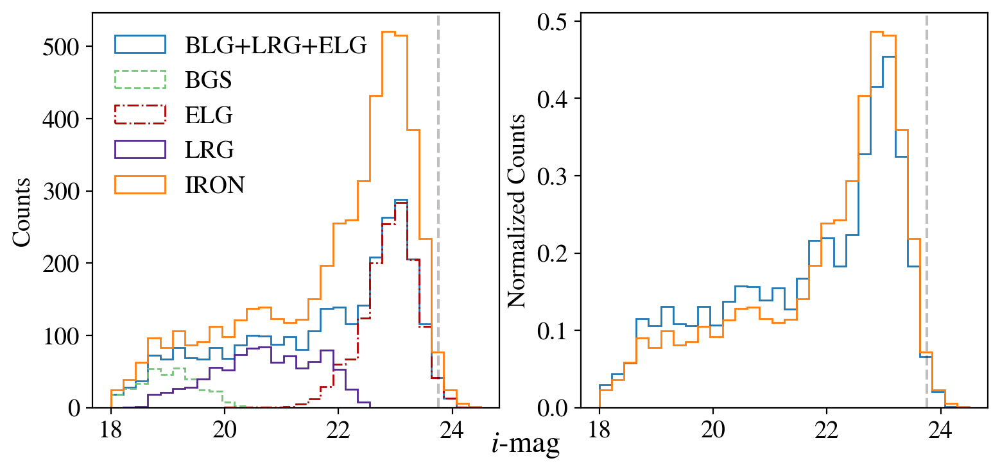

In [282]:
fig, ax = plt.subplots(ncols=2, figsize=(9,4))


sample_colors = ['#74c476','#b30000','#54278f']
sample_ls = ['--', '-.', '-']
ax[0].hist(match_cc['i_cModel_mag'], range=(18, 24.5), bins=30, histtype='step', label='BLG+LRG+ELG')
for i,k in enumerate(['BGS', 'ELG', 'LRG']):
    kfilt = match_cc['desi_sample'] == k
    ax[0].hist(match_cc['i_cModel_mag'][kfilt], range=(18, 24.5), label=k,
               bins=30, histtype='step', color=sample_colors[i], ls=sample_ls[i])
ax[0].hist(match_cc_iron['i_cModel_mag'], range=(18, 24.5), bins=30, histtype='step', label='IRON')
ax[0].axvline(23.76, ls='--', color='k', alpha=0.25)
ax[0].legend(frameon=False)
ax[0].set_ylabel("Counts")

ax[1].hist(match_cc['i_cModel_mag'], range=(18, 24.5), bins=30,
           histtype='step', label='BLG + RLG\n + ELG', density=True)
ax[1].hist(match_cc_iron['i_cModel_mag'], range=(18, 24.5), bins=30,
           histtype='step', label='IRON', density=True)
ax[1].axvline(23.76, ls='--', color='k', alpha=0.25)
ax[1].set_ylabel("Normalized Counts")
fig.supxlabel("$i$-mag")

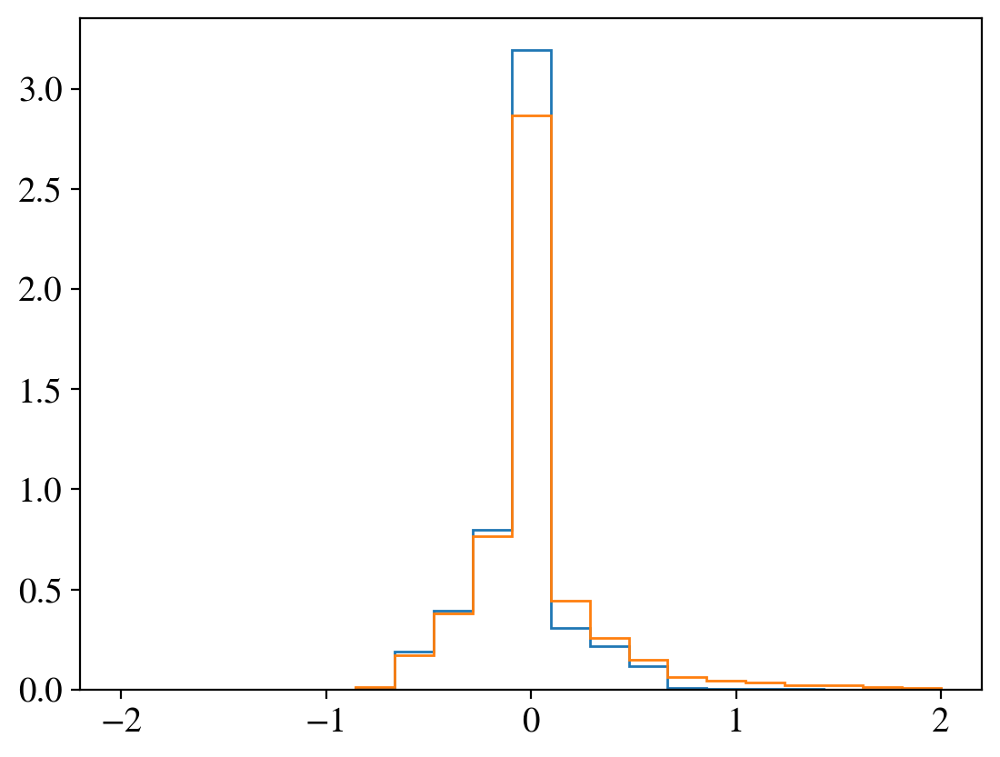

In [283]:
match_delta_z = (match_cc['dnf_z_median'] - match_cc['desi_z'])/(1+match_cc['desi_z'])
match_iron_delta_z = (match_cc_iron['dnf_z_median'] - match_cc_iron['desi_z'])/(1+match_cc_iron['desi_z'])
plt.hist(match_delta_z, range=(-2, 2), bins=21, density=True, histtype='step')
plt.hist(match_iron_delta_z, range=(-2, 2), bins=21, density=True, histtype='step');

Text(0.5, 0.01, '$i$-mag')

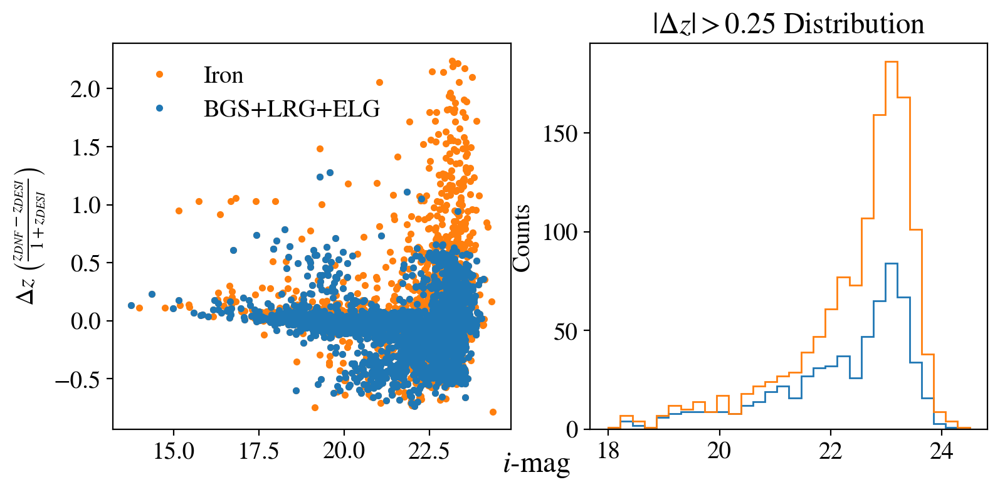

In [284]:
fig, ax = plt.subplots(ncols=2, figsize=(9,4))


ax[0].plot(match_cc_iron['i_cModel_mag'], match_iron_delta_z, '.', label='Iron', color='C1')
ax[0].plot(match_cc['i_cModel_mag'], match_delta_z, '.', label='BGS+LRG+ELG', color='C0')
ax[0].set_ylabel(r"$\Delta z$ $\left(\frac{z_{DNF} - z_{DESI}}{1 + z_{DESI}}\right)$")
ax[0].legend(frameon=False)

iron_delta_filt = np.abs(match_iron_delta_z) > 0.25
delta_filt = np.abs(match_delta_z) > 0.25
ax[1].hist(match_cc['i_cModel_mag'][delta_filt], 
           range=(18, 24.5), bins=30, histtype='step')
ax[1].hist(match_cc_iron['i_cModel_mag'][iron_delta_filt], 
           range=(18, 24.5), bins=30, histtype='step')
ax[1].set_title(r"$|\Delta z| > 0.25$ Distribution")
ax[1].set_ylabel("Counts")

fig.supxlabel("$i$-mag")

Text(0, 0.5, 'g-i')

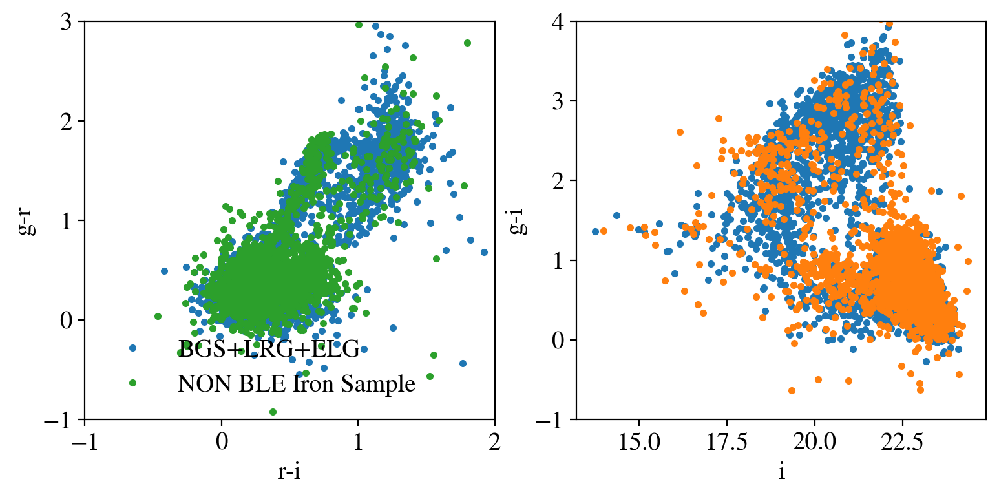

In [285]:

fig, ax = plt.subplots(ncols=2, figsize=(9,4))

# ax[0].plot(match_cc_iron['ri'], match_cc_iron['gr'], '.', color='C1', label='NON BLE Iron Sample')
ax[0].plot(match_cc['ri'], match_cc['gr'], '.', color='C0', label='BGS+LRG+ELG')
ax[0].plot(non_ble['ri'], non_ble['gr'], '.', color='C2', label='NON BLE Iron Sample')

ax[0].legend(frameon=False)
ax[0].set_xlim(-1, 2)
ax[0].set_ylim(-1, 3)
ax[0].set_xlabel("r-i")
ax[0].set_ylabel("g-r")

ax[1].plot(match_cc['i_cModel_mag'], match_cc['gi'], '.', color='C0')
ax[1].plot(non_ble['i_cModel_mag'], non_ble['gi'], '.', color='C1')
# ax[1].set_xlim(-1, 3)
ax[1].set_ylim(-1, 4)
ax[1].set_xlabel("i")
ax[1].set_ylabel("g-i")

Text(0, 0.5, 'g-i')

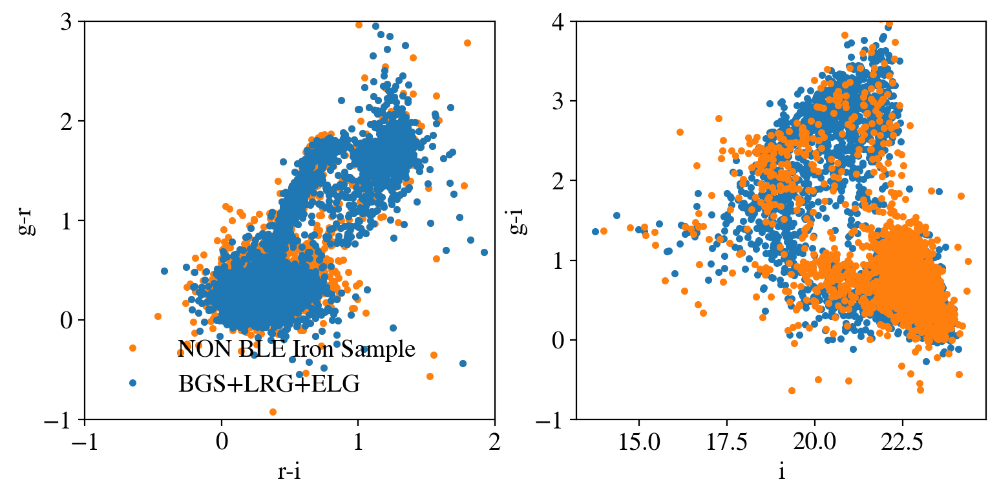

In [286]:
fig, ax = plt.subplots(ncols=2, figsize=(9,4))

ax[0].plot(match_cc_iron['ri'], match_cc_iron['gr'], '.', color='C1', label='NON BLE Iron Sample')
ax[0].plot(match_cc['ri'], match_cc['gr'], '.', color='C0', label='BGS+LRG+ELG')
# ax[0].plot(non_ble['ri'], non_ble['gr'], '.', color='C2', label='NON BLE Iron Sample')

ax[0].legend(frameon=False)
ax[0].set_xlim(-1, 2)
ax[0].set_ylim(-1, 3)
ax[0].set_xlabel("r-i")
ax[0].set_ylabel("g-r")

ax[1].plot(match_cc['i_cModel_mag'], match_cc['gi'], '.', color='C0')
ax[1].plot(non_ble['i_cModel_mag'], non_ble['gi'], '.', color='C1')
# ax[1].set_xlim(-1, 3)
ax[1].set_ylim(-1, 4)
ax[1].set_xlabel("i")
ax[1].set_ylabel("g-i")

In [287]:
# fig, ax = plt.subplots(ncols=2, figsize=(6,4))

# ax[0].scatter(match_cc1['desi_z'], match_cc1['dnf_z_median'], s=2, label='Original')
# ax[1].scatter(match_cc['desi_z'], match_cc['dnf_z_median'], s=2, label='IRON')
# for xx in ax:
#     xx.set_xlim(0, 1.5)
#     xx.set_ylim(0, 1.5)

In [288]:
match_cc = Table.read('cluster_data/desi_sv38_matches.fits')
match_cc_iron = Table.read('cluster_data/desi_sv38_ironmatches_quality.fits')

In [289]:
gala_cc = match_cc_iron[match_cc_iron['desi_sample']=='GALA']

In [290]:
plot_match = gala_cc

In [291]:
match_mask = get_masks(plot_match)
plot_match = plot_match[match_mask]

In [292]:
plot_match = plot_match[plot_match['i_cModel_mag'] < 23.76]

In [293]:
plot_match = apply_redsequence_noisy(plot_match, sigma=1, mag_lim=23.76)
pz_diffs(plot_match, pz_algos)

In [294]:
redseq_match = plot_match[plot_match['all_redseq']]
print(len(redseq_match))

83


In [295]:
pzo = pz_ests['objectId']

desi_rs_ids = redseq_match['objectId']
rs_desi_filt = np.isin(pzo,desi_rs_ids)

xs = np.linspace(0, 3, 301)

In [296]:
pz_algs = ['bpz', 'dnf', 'fzboost', 'knn']
quality_pdfs = []

for alg in pz_algos:
    # if alg=='gpz':
    #     new_filt = rs_desi_filt
    # else:
    #     new_filt = np.logical_and(rs_desi_filt, pz_ests[f'{alg}_diff'] < 0.25)
    new_filt = rs_desi_filt
    print(f"On {alg} we have {np.sum(new_filt)}")
    pdf, _, xs = get_pdfs(alg, new_filt, pz_dir=pz_sv38_pdf_dir)

    # pdf, _, xs = get_pdfs(alg, big_pz_filt)
    quality_pdfs.append(pdf)

On bpz we have 83
On tpz we have 83
On fzboost we have 83
On knn we have 83
On gpz we have 83
On dnf we have 83
On lephare we have 83
On cmnn we have 83


In [297]:
pdf_scale_factor = np.zeros(len(quality_pdfs))
for i,qpdf in enumerate(quality_pdfs):
    pdf_scale_factor[i] = 1/(integrate.trapezoid(qpdf, xs))

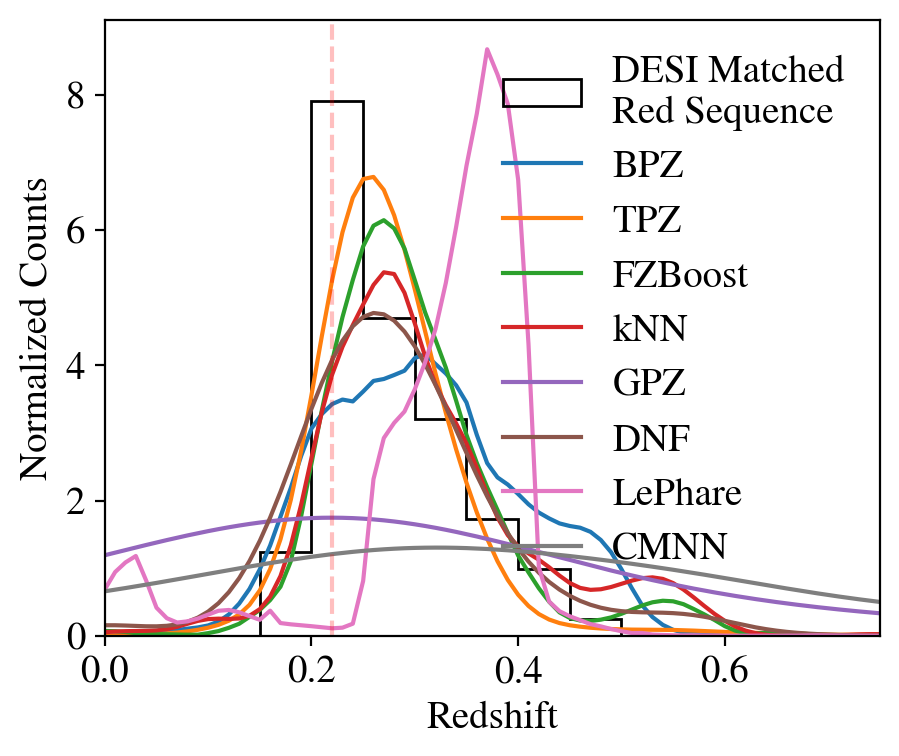

In [298]:
fig, ax = plt.subplots(1, figsize=(5, 4))

label = ['BPZ', 'TPZ', 'FZBoost', 'kNN', 'GPZ', 'DNF', 'LePhare', 'CMNN']

plot_bins = np.linspace(0.0, 0.5, 11)
# ax.hist(redseq_match['desi_z'], histtype='step', range=(0.01, .51), bins=25,
#         label="DESI Matched\nRed Sequence", density=True, color='k', ls='--')
ax.hist(redseq_match['desi_z'], histtype='step', bins=plot_bins,
        label="DESI Matched\nRed Sequence", density=True, color='k', ls='-')
for i, alg in enumerate(pz_algos):
    ax.plot(xs, quality_pdfs[i] * pdf_scale_factor[i], label=label[i])

ax.legend(frameon=False)
ax.set_xlim(0, .75)
ax.set_xlabel("Redshift")
ax.set_ylabel("Normalized Counts")
# ax.set_ylabel("Normalized Counts")
# ax.axvline(0.37, ls='--', color='k', alpha=0.25)
ax.axvline(0.22, ls='--', color='r', alpha=0.25)
# ax.set_title("N(z) with $\\sigma_z \\leq 0.25$")
# ax.set_title("N(z) with Quality Cuts")

In [299]:
# plt.axvline(0.22, ls='--', color='k', alpha=0.2)
# plt.hist(redseq_match['desi_z'], histtype='step', range=(0.01, .51), bins=25, label="Matched Red Sequence")
# plt.xlabel("Spectroscopic Redshift")
# plt.ylabel("Counts")

In [300]:
R2 = 1 - (plot_match['i_ixxPSF']+plot_match['i_iyyPSF'])/(plot_match['shape_xx']+plot_match['shape_yy'])
plot_match['res'] = R2

In [301]:
c1 = SkyCoord(plot_match['coord_ra']*u.deg, plot_match['coord_dec']*u.deg)
c2 = SkyCoord(cluster_coords[0]*u.deg, cluster_coords[1]*u.deg)
sep = c1.separation(c2)
plot_match['sep'] = sep.deg

In [302]:
match_wl_filt = get_wlfilt(plot_match, mag_lim=23.76, apply_sep=True)
wl_match = plot_match[match_wl_filt]

After WL cuts: 430


In [303]:
rs_match = plot_match[plot_match['all_redseq']]

In [304]:
pz_algs = ['bpz', 'dnf', 'fzboost', 'knn']

pzo = pz_ests['objectId']
rs_filt = np.isin(pzo, rs_match['objectId'])
source_filt = np.isin(pzo, wl_match['objectId'])

rs_pdf, _, xs = get_pdfs('dnf', rs_filt, pz_dir=pz_sv38_pdf_dir)
rs_scalefactor = 1/integrate.trapezoid(rs_pdf, xs)
wl_pdf, _, xs = get_pdfs('dnf', source_filt, pz_dir=pz_sv38_pdf_dir)
wl_scalefactor = 1/integrate.trapezoid(wl_pdf, xs)

Text(0.02, 0.5, 'Photo-z')

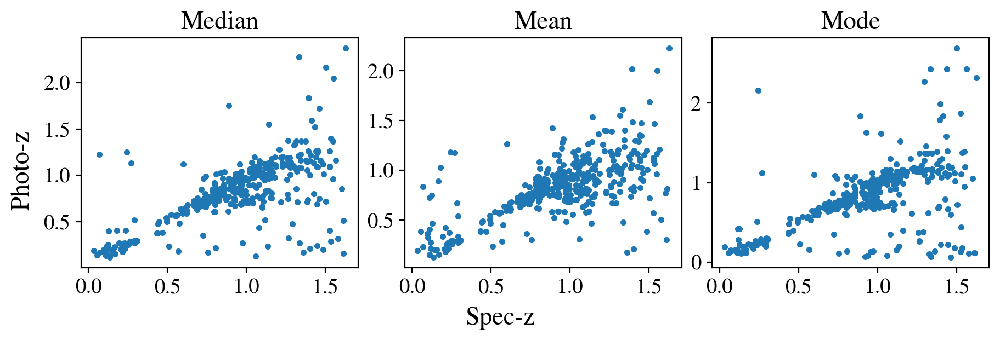

In [305]:
fig, ax = plt.subplots(ncols=3, figsize=(9, 3), layout='constrained')

ax[0].plot(wl_match['desi_z'], wl_match['dnf_z_median'], '.')
ax[0].set_title("Median")
ax[1].plot(wl_match['desi_z'], wl_match['dnf_z_mean'], '.')
ax[1].set_title("Mean")
ax[2].plot(wl_match['desi_z'], wl_match['dnf_z_mode'], '.')
ax[2].set_title("Mode")
fig.supxlabel("Spec-z")
fig.supylabel("Photo-z")
# plt.legend()

Text(0.5, 0.01, 'Photo-z')

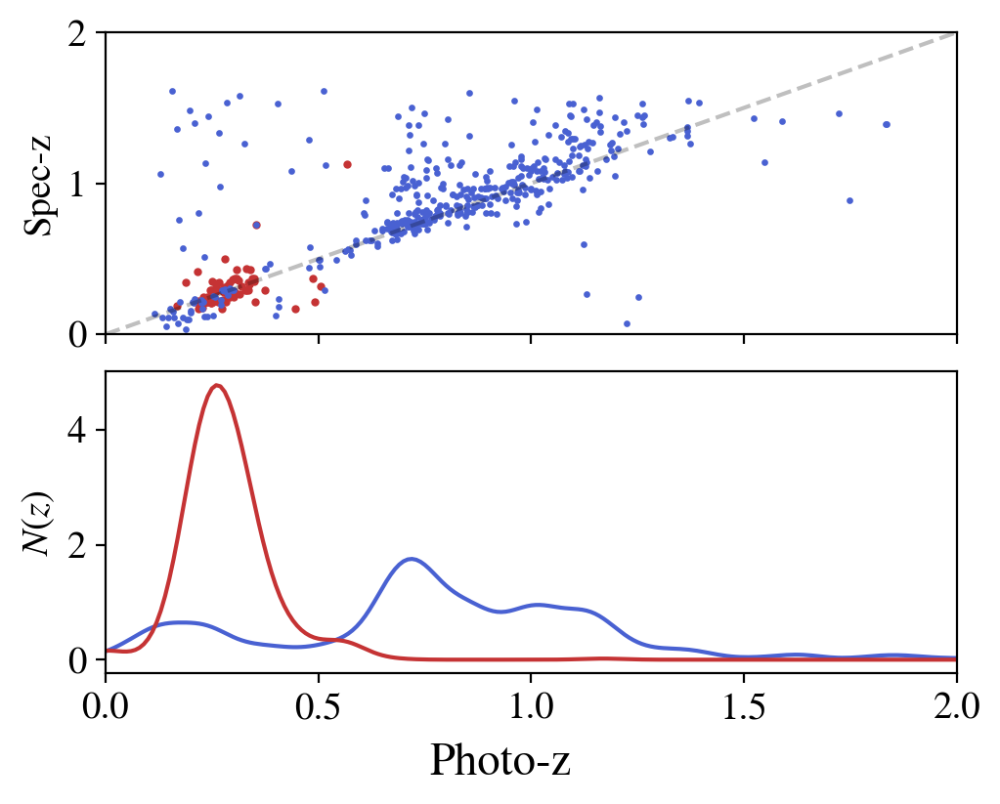

In [306]:
fig, ax = plt.subplots(nrows=2, figsize=(5,4), layout='constrained', sharex=True)

rs_filt = plot_match['all_redseq']
cmap = cm.coolwarm
rs_color = cmap(0.95)
source_color = cmap(0.05)

ax[0].scatter(plot_match['dnf_z_median'][rs_filt], plot_match['desi_z'][rs_filt],  s=4, color=rs_color)
ax[0].scatter(wl_match['dnf_z_median'], wl_match['desi_z'], s=2, color=source_color, alpha=1)
ax[0].plot([0,10], [0,10], ls='--', color='k', alpha=0.25)
ax[0].set_xlim(0, 2)
ax[0].set_ylim(0, 2)
ax[0].set_ylabel("Spec-z")

plot_bins = np.linspace(0.0, 0.5, 11)

ax[1].plot(xs, wl_pdf * wl_scalefactor, color=source_color)
ax[1].plot(xs, rs_pdf * rs_scalefactor, color=rs_color)
ax[1].set_xlim(0, 2)
ax[1].set_ylabel("$N(z)$")
# ax[1].set_ylabel("Normalized Counts")

fig.supxlabel("Photo-z")
# fig.suptitle("DESI IRON Catalog")
# fig.suptitle("BGS x LRG x ELG")

## ECDFS $N(z)$ from color cuts

#### Load ECDFS Photo-Z Data

In [60]:
bands = list('ugrizy')
ecdfs_cmodel_bands = [b+suffix for b in bands for suffix in ['_cModelFlux', '_cModelFluxErr', '_cModel_flag']]
ecdfs_gaap_bands = [b+suffix for b in bands for suffix in ['_gaap1p0Flux', '_gaap1p0FluxErr',  '_gaapFlux_flag']]

ecdfs_object_req_cols = ['coord_ra', 'coord_dec', 'refExtendedness', 'objectId',
            'parentObjectId', 'shape_xx', 'shape_xy', 'shape_yy', 'refBand', 'x', 'y',
            'patch', 'tract', 'i_ixxPSF', 'i_iyyPSF', 'i_ixyPSF', 'i_iPSF_flag', 'shape_flag',
            'i_hsmShapeRegauss_e1', 'i_hsmShapeRegauss_e2',
            'i_hsmShapeRegauss_flag', 'i_hsmShapeRegauss_sigma', 'i_blendedness' ] + ecdfs_cmodel_bands + ecdfs_gaap_bands

ecdfs_tracts = [5063, 4849, 4848]


In [61]:
pz_file = '/sdf/data/rubin/shared/pz/projects/dp1/data/gold_baseline/dp1_all/dp1_v29.0.0_gold_photoz_cat.parquet'
pz_ests = pd.read_parquet(pz_file)
pz_ests = Table.from_pandas(pz_ests)

In [62]:
method_list = ['fzboost', 'knn', 'cmnn', 'dnf', 'tpz', 'gpz', 'bpz', 'lephare']

for algo in method_list:
    zwidth = (pz_ests[f'{algo}_z_err95_high'] - pz_ests[f'{algo}_z_err95_low'])
    pz_ests[algo+'_diff'] = zwidth

In [63]:
dp1_catalog, preclean_ecdfs = load_pz_photomdata(tracts=ecdfs_tracts, columns=ecdfs_object_req_cols)
# dp1_catalog = Table.read('cluster_data/abell360_PRECUTS_DP1_gaap_cModel.fits', format="fits")

/opt/lsst/software/stack/conda/envs/lsst-scipipe-10.1.0/lib/python3.12/site-packages/astropy/units/function/logarithmic.py:67: RuntimeWarning: divide by zero encountered in log10
  return dex.to(self._function_unit, np.log10(x))
/opt/lsst/software/stack/conda/envs/lsst-scipipe-10.1.0/lib/python3.12/site-packages/astropy/units/function/logarithmic.py:67: RuntimeWarning: invalid value encountered in log10
  return dex.to(self._function_unit, np.log10(x))


In [64]:
ecdfs_table = join(dp1_catalog, pz_ests, keys='objectId')
ecdfs_table.add_index('objectId')
ecdfs_table = Table.filled(ecdfs_table, fill_value=np.nan)

#### Apply Quality + RS Cuts

In [65]:
ecdfs_mk = ecdfs_mask(ecdfs_table)
ecdfs_table = ecdfs_table[ecdfs_mk]

In [66]:
ecdfs_wl = get_wlfilt(ecdfs_table, mag_lim=23.76, apply_sep=False)
ecdfs_wl_table = ecdfs_table[ecdfs_wl]

After WL cuts: 37692


In [67]:
ecdfs_wl_table = apply_redsequence_noisy(ecdfs_wl_table)
# ecdfs_wl_table = apply_redsequence(ecdfs_wl_table)

In [181]:
ecdfs_wl_table.write(f'{outdir}/ecdfs_wl_table.fits', format='fits', overwrite=True)

Text(0.5, 0.01, 'cModel $i$-mag')

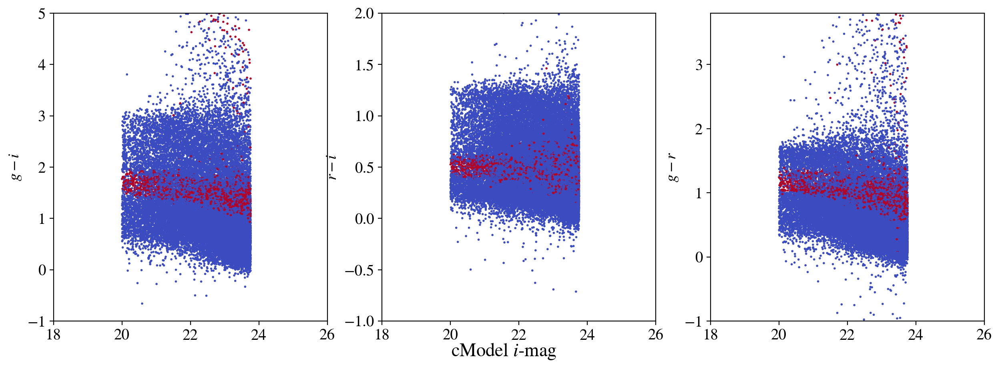

In [34]:
fig, ax = plt.subplots(ncols=3, figsize=(15, 5))

cmap = cm.coolwarm
color_names = ['gi', 'ri', 'gr']
col_name = ['$g-i$', '$r-i$', '$g-r$']
for i in range(3):
    col = color_names[i]
    ax[i].scatter(ecdfs_wl_table['i_cModel_mag'], ecdfs_wl_table[col], marker='.', s=4,
                  c=ecdfs_wl_table[f'all_redseq'], cmap=cmap)
    ax[i].set_ylabel(col_name[i])
    ax[i].set_xlim(18, 26)

ax[0].set_ylim(-1, 5)
ax[1].set_ylim(-1, 2)
ax[2].set_ylim(-1, 3.8)
fig.supxlabel(r"cModel $i$-mag")

#### $N(z)$

In [35]:
pzo = pz_ests['objectId']
ecdfs_pzo = ecdfs_wl_table['objectId']

ecdfs_nz_filt = np.isin(pzo, ecdfs_pzo)

In [36]:
cc_ids = ecdfs_wl_table['objectId'][~ecdfs_wl_table[f'all_redseq']]

In [41]:
pz_algs = ['bpz', 'tpz', 'fzboost', 'knn', 'gpz', 'dnf', 'lephare', 'cmnn']
ecdfs_nz_pdfs = np.zeros((len(pz_algs), 301))

# for cc in ['all', 'gi', 'ri', 'gr']:
for cc in ['all']:
    ecdfs_nz_pdfs = np.zeros((len(pz_algs), 301))

    cc_ids = ecdfs_wl_table['objectId'][~ecdfs_wl_table[f'{cc}_redseq']]

    for i,alg in enumerate(pz_algs):
        new_filt = np.isin(pzo, cc_ids)
        # new_filt = ecdfs_nz_filt
        print(f"On {alg} we have {np.sum(new_filt)}")
        pdf, sample_pdf, xs = get_pdfs(alg, new_filt, pz_ecdfs_pdf_dir)
        np.save(f"cluster_data/ecdfs_nz_{alg}_{cc}noisy.npy", sample_pdf)
        ecdfs_nz_pdfs[i,:] = pdf
        c = gc.collect()

    np.save(f"cluster_data/ecdfs_nz_{cc}noisy.npy", ecdfs_nz_pdfs)

On bpz we have 34918
On tpz we have 34918
On fzboost we have 34918
On knn we have 34918
On gpz we have 34918
On dnf we have 34918
On lephare we have 34918
On cmnn we have 34918


In [42]:
ecdfs_nz_pdfs = np.load("cluster_data/ecdfs_nz_allnoisy.npy")

Text(0.5, 1.0, 'ECDFS All Colors Red Sequence $N(z)$')

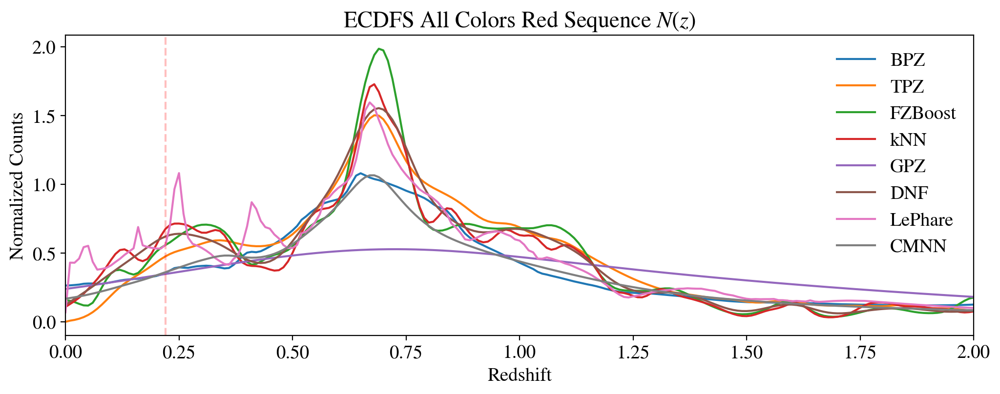

In [43]:
fig, ax = plt.subplots(1, figsize=(12, 4))

label = ['BPZ', 'TPZ', 'FZBoost', 'kNN', 'GPZ', 'DNF', 'LePhare', 'CMNN']

for i, alg in enumerate(pz_algs):
    ax.plot(xs, ecdfs_nz_pdfs[i], label=label[i])

ax.legend(frameon=False)
ax.set_xlim(0, 2)
ax.set_xlabel("Redshift")
ax.set_ylabel("Normalized Counts")
ax.axvline(0.22, ls='--', color='r', alpha=0.25)
plt.title("ECDFS All Colors Red Sequence $N(z)$")
# ax.axvline(0.37, ls='--', color='k', alpha=0.25)
# ax.set_title("N(z) with $z \\geq 0.37$ and $\\sigma_z \\leq 0.25$")

In [271]:
# np.save('cluster_data/ecdfs_nz_allrs.npy', ecdfs_nz_pdfs)

## $N(z)$ Comparison

In [85]:
ecdfs_nz_pdfs = np.load("cluster_data/ecdfs_nz_allnoisy.npy")
# ['bpz', 'tpz', 'fzboost', 'knn', 'gpz', 'dnf', 'lephare', 'cmnn']
wl_pdfs = np.load('cluster_data/sv38_nz_allnoisy.npy')
# ['bpz', 'tpz', 'fzboost', 'knn', 'gpz', 'dnf', 'lephare', 'cmnn']

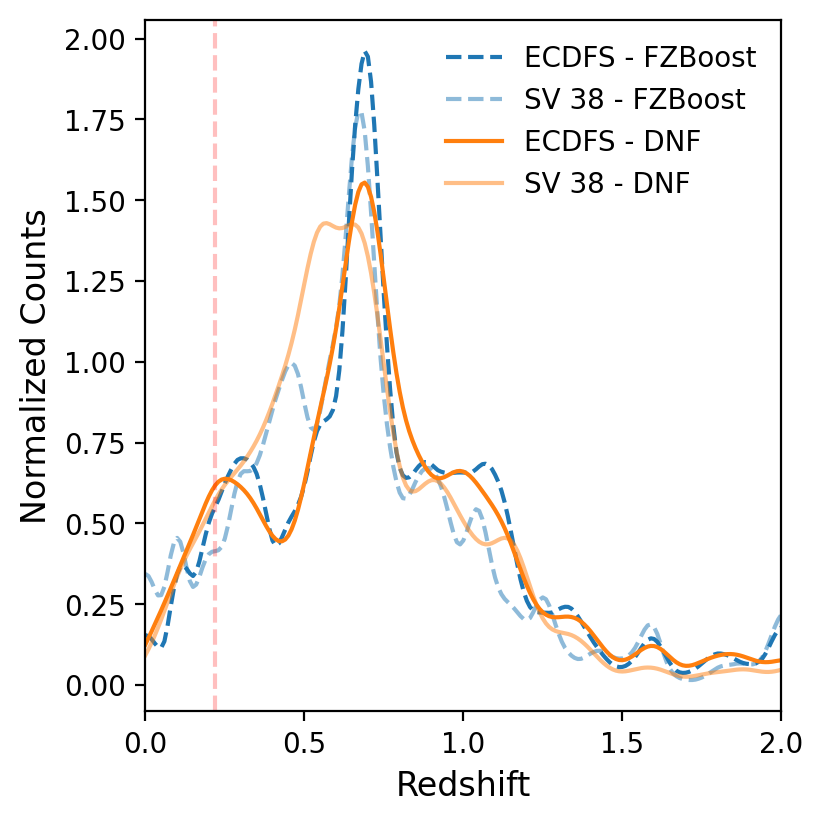

In [90]:
fig, ax = plt.subplots(1, figsize=(4, 4), layout='constrained')

label = ['BPZ', 'TPZ', 'FZBoost', 'kNN', 'GPZ', 'DNF', 'LePhare', 'CMNN']
lss = ['--', '-']

for i,ndx in enumerate([2,5]):
    ax.plot(xs, ecdfs_nz_pdfs[ndx], label=f"ECDFS - {label[ndx]}",
            ls=lss[i], color=f'C{i}')
    ax.plot(xs, wl_pdfs[ndx], label=f"SV 38 - {label[ndx]}",
            ls=lss[i], color=f'C{i}', alpha=0.5)    

ax.legend(frameon=False)
ax.set_xlim(0, 2)
ax.set_xlabel("Redshift", fontsize=12)
ax.set_ylabel("Normalized Counts", fontsize=12)
ax.axvline(0.22, ls='--', color='r', alpha=0.25)
plt.savefig('figs/ecdfs_sv38_nz.pdf', dpi=300)
# plt.title(f"All Colors Red Sequence $N(z)$")
# ax.axvline(0.37, ls='--', color='k', alpha=0.25)
# ax.set_title("N(z) with $z \\geq 0.37$ and $\\sigma_z \\leq 0.25$")

### shapeHSM, Anacal, Metadetect $N(z)$

In [47]:
# ecdfs_nz_pdfs = np.load("cluster_data/ecdfs_nz_allnoisy.npy")
# dnf_ndx = 5
# ecdfs_nz_dnf = ecdfs_nz_pdfs[dnf_ndx]
# # ['bpz', 'tpz', 'fzboost', 'knn', 'gpz', 'dnf', 'lephare', 'cmnn']

In [256]:
ecdfs_pz_dnf = np.load('cluster_data/ecdfs_nz_dnf_allnoisy.npy')
sv38_pz_dnf = np.load('cluster_data/sv38_nz_dnf_pzcut+allnoisy.npy')
anacal_pdfs = np.load('cluster_data/anacal_pzs_dnf_bright_allmasks.npy')
metadetect_pdfs = np.load('/sdf/data/rubin/shared/cluster_commissioning/metadetect/metadetect_gauss_dnf_pz_v2.npy')

In [257]:
ecdfs_table = Table.read('cluster_data/ecdfs_wl_table.fits')
ecdfs_table = ecdfs_table[~ecdfs_table['all_redseq']]

sigma_shapenoise = np.std(ecdfs_table['i_hsmShapeRegauss_e1'])**2 + np.std(ecdfs_table['i_hsmShapeRegauss_e2'])**2
sigma_measurement = 2*ecdfs_table['i_hsmShapeRegauss_sigma']**2
# ecdfs_w_ls = 1/(sigma_shapenoise + sigma_measurement)
ecdfs_w_ls = 1/(0.26**2 + sigma_measurement)

In [258]:
sv38_table = Table.read('cluster_data/abell360_POSTCUTS_dnf0.37_masked_DP1_widepz.fits')

sigma_shapenoise = np.std(sv38_table['i_hsmShapeRegauss_e1'])**2 + np.std(sv38_table['i_hsmShapeRegauss_e2'])**2
sigma_measurement = 2*sv38_table['i_hsmShapeRegauss_sigma']**2

sv38_w_ls = 1/(0.26**2 + sigma_measurement)

In [260]:
# anacal_pz_table = Table.read('cluster_data/anacal_pz_table_v2_bright.fits')
anacal_pz_table = Table.read('cluster_data/anacal_pz_table_v2_bright_allmasks.fits')
anacal_pz_weights = anacal_pz_table['wdet'] * (anacal_pz_table['de1_dg1'] + anacal_pz_table['de2_dg2']) / 2.0
# anacal_pz_weights = np.ones(len(anacal_pz_table))

In [261]:
metadetect_pz_weights = np.ones(len(metadetect_pdfs))

In [262]:
# test_xs = np.linspace(0, 2.5, 251)
test_xs = np.linspace(0, 3.0, 301)

In [263]:
anacal_stacked_nz = np.sum(anacal_pdfs * anacal_pz_weights[:,None], axis=0)/np.sum(anacal_pz_weights)
metadetect_stacked_nz = np.sum(metadetect_pdfs * metadetect_pz_weights[:,None], axis=0)/np.sum(metadetect_pz_weights)
sv38_stacked_nz = np.sum(sv38_pz_dnf * sv38_w_ls[:,None], axis=0)/np.sum(sv38_w_ls)
ecdfs_stacked_nz = np.sum(ecdfs_pz_dnf * ecdfs_w_ls[:,None], axis=0)/np.sum(ecdfs_w_ls)

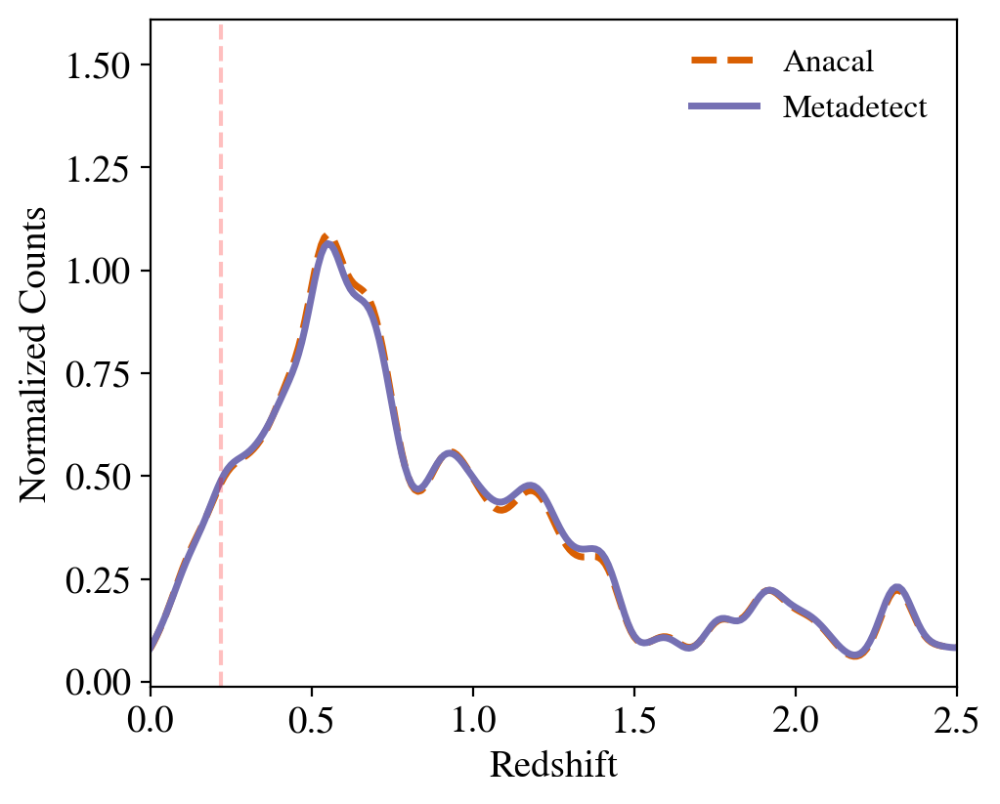

In [264]:
fig, ax = plt.subplots(1, figsize=(5, 4), layout='constrained')


profile_names = ["HSM - CC", "HSM - CC+PZ", "AnaCal", "Metadetect"]
colors = ['#0B956C', '#0B956C','#d95f02','#7570b3']
linestyles = ['dashdot', ':', '--', '-']

ax.plot(test_xs, anacal_stacked_nz, label=f"Anacal", ls='--',
        color='#d95f02', linewidth=2.5)
ax.plot(test_xs, metadetect_stacked_nz, label=f"Metadetect", ls='-',
        color='#7570b3', alpha=1, linewidth=2.5)
# ax.plot(test_xs, ecdfs_stacked_nz, label=f"shapeHSM (CC)", ls='dashdot',
#         color='#0B956C', linewidth=2.5)
# ax.plot(test_xs, sv38_stacked_nz, label=f"shapeHSM (CC + PZ)", ls=':',
#         color='#0B956C', linewidth=2.5)



ax.legend(frameon=False, fontsize=12)
ax.set_xlim(0, 2.5)
ax.set_xlabel("Redshift")
ax.set_ylabel("Normalized Counts")
ax.axvline(0.22, ls='--', color='r', alpha=0.25)
# plt.savefig('figs/all4_nz.pdf', bbox_inches='tight')
# plt.title(f"All Colors Red Sequence $N(z)$")
# ax.axvline(0.37, ls='--', color='k', alpha=0.25)
# ax.set_title("N(z) with $z \\geq 0.37$ and $\\sigma_z \\leq 0.25$")

In [265]:
# pz_algs = ['bpz', 'fzboost', 'dnf']

# np.save(f'cluster_data/anacal_pzs_fzb_bright.npy', sample_pdf)

In [222]:
mdet_table = pd.read_pickle('/sdf/group/rubin/shared/cluster_commissioning/metadetect/md-wl-point-mode_v2.pkl')
mdet_table = Table.from_pandas(mdet_table)

# inner_mdet = mdet_table[(mdet_table['mpc_sep'] > 0.3) * (mdet_table['mpc_sep'] < 0.7)]

In [235]:

Da(0.22) * np.pi/180 * 0.5

6.398552229366873

In [242]:
stacked_anacal = np.zeros((3, 301))
stacked_hsm = np.zeros((3, 301))
stacked_metadetect = np.zeros((3, 301))

for i,alg_name in enumerate(['bpz', 'fzboost', 'dnf']):
    anacal_pdfs = np.load(f'cluster_data/anacal_pzs_{alg_name}_bright.npy')
    metadetect_pdfs = np.load(f'/sdf/data/rubin/shared/cluster_commissioning/metadetect/metadetect_gauss_{alg_name}_pz_v2.npy')
    sv38_pdfs = np.load(f'cluster_data/sv38_nz_{alg_name}_pzcut+allnoisy.npy')

    sv38_table = Table.read(f'cluster_data/abell360_POSTCUTS_{alg_name}0.37_masked_DP1_widepz.fits') 
    sigma_shapenoise = np.std(sv38_table['i_hsmShapeRegauss_e1'])**2 + np.std(sv38_table['i_hsmShapeRegauss_e2'])**2
    sigma_measurement = 2*sv38_table['i_hsmShapeRegauss_sigma']**2
    sv38_w_ls = 1/(0.26**2 + sigma_measurement)

    hsm_mpc = sv38_table['sep'] * Da(0.22) * np.pi/180
    
    inner_mdet_filt = (mdet_table['mpc_sep'] > 0.3) * (mdet_table['mpc_sep'] < 0.7)
    inner_anacal_filt = (anacal_pz_table['mpc_sep'] > 0.3) * (anacal_pz_table['mpc_sep'] < 0.7)
    inner_hsm_filt = (hsm_mpc > 0.3) * (hsm_mpc < 0.7)

    # inner_mdet_filt = (mdet_table['mpc_sep'] > 0.3)
    # inner_anacal_filt = (anacal_pz_table['mpc_sep'] > 0.3)

    # anacal_stacked_nz = np.sum(anacal_pdfs[inner_anacal_filt] * anacal_pz_weights[inner_anacal_filt,None], axis=0)/np.sum(anacal_pz_weights[inner_anacal_filt])
    # metadetect_stacked_nz = np.sum(metadetect_pdfs[inner_mdet_filt], axis=0)/len(metadetect_pdfs[inner_mdet_filt])
    # hsm_stacked_nz = np.sum(sv38_pdfs[inner_hsm_filt] * sv38_w_ls[inner_hsm_filt,None], axis=0)/np.sum(sv38_w_ls[inner_hsm_filt])

    anacal_stacked_nz = np.sum(anacal_pdfs[inner_anacal_filt], axis=0)/len(anacal_pz_weights[inner_anacal_filt])
    metadetect_stacked_nz = np.sum(metadetect_pdfs[inner_mdet_filt], axis=0)/len(metadetect_pdfs[inner_mdet_filt])
    hsm_stacked_nz = np.sum(sv38_pdfs[inner_hsm_filt], axis=0)/len(sv38_w_ls[inner_hsm_filt])

    stacked_anacal[i,:] = anacal_stacked_nz
    stacked_metadetect[i,:] = metadetect_stacked_nz
    stacked_hsm[i,:] = hsm_stacked_nz

Text(0.5, 0.98, 'Inner Bin $N(z)$ - No weighting')

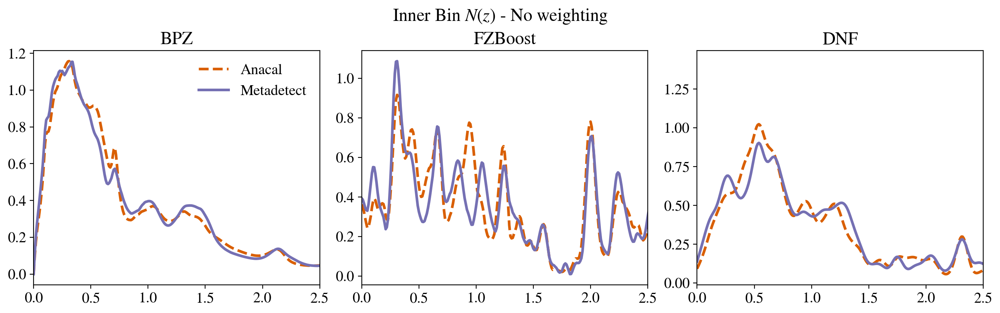

In [249]:
fig, ax = plt.subplots(ncols=3, figsize=(13, 4), layout='constrained')

plot_alg_names = ['BPZ', 'FZBoost', 'DNF']

for i in range(3):
    ax[i].plot(test_xs, stacked_anacal[i,:], label=f"Anacal", ls='--',
            color='#d95f02', linewidth=2.5)
    ax[i].plot(test_xs, stacked_metadetect[i,:], label=f"Metadetect", ls='-',
            color='#7570b3', alpha=1, linewidth=2.5)
    # ax[i].plot(test_xs, stacked_hsm[i,:], label=f"shapeHSM", ls=':',
    #     color='#0B956C', linewidth=2.5)
    ax[i].set_xlim(0, 2.5)
    ax[i].set_title(plot_alg_names[i])

ax[0].legend(frameon=False)
fig.suptitle("Inner Bin $N(z)$ - No weighting")

### $\beta$ and $\beta^2$ Comparison

In [329]:
def get_beta_betasqr_pdf(weights, pdfs, beta_s, beta_sqr, xs=default_xs):
    nz = np.sum(pdfs * weights[:,None],axis=0)/np.sum(weights)
    xfilt = (xs < 2.5)
    # normalization = integrate.trapezoid(nz[xs > 0.22], xs[xs > 0.22])
    normalization = integrate.trapezoid(nz[xfilt], xs[xfilt])
    avg_beta_s = integrate.trapezoid(beta_s[xfilt] * nz[xfilt], xs[xfilt]) / normalization
    avg_beta_s_sqr = integrate.trapezoid(beta_sqr[xfilt] * nz[xfilt], xs[xfilt]) / normalization
    return avg_beta_s, avg_beta_s_sqr

def get_beta_betasqr_boot_pdf(weights, pdfs, beta_s, beta_sqr, N=1000, xs=default_xs):
    avg_betas = np.zeros(N)
    avg_beta_sqrs = np.zeros(N)
    Nsample = len(pdfs)

    for i in range(N):
        boot_filt = rng.choice(Nsample, size=Nsample)
        boot_weights = weights[boot_filt]
        boot_pdfs = pdfs[boot_filt]
        
        beta_s_sample, beta_s_sqr_sample = get_beta_betasqr_pdf(boot_weights, boot_pdfs, beta_s, beta_sqr, xs)
        avg_betas[i] = beta_s_sample
        avg_beta_sqrs[i] = beta_s_sqr_sample
    return avg_betas, avg_beta_sqrs

In [330]:
ecdfs_pz_dnf = np.load('cluster_data/ecdfs_nz_dnf_allnoisy.npy')
sv38_pz_dnf = np.load('cluster_data/sv38_nz_dnf_pzcut+allnoisy.npy')
# anacal_pdfs = np.load('cluster_data/anacal_pzs_dnf_bright.npy')
anacal_pdfs = np.load('cluster_data/anacal_pzs_dnf_bright_allmasks.npy')
metadetect_pdfs = np.load('/sdf/data/rubin/shared/cluster_commissioning/metadetect/metadetect_gauss_dnf_pz_v2.npy')

In [331]:
ecdfs_table = Table.read('cluster_data/ecdfs_wl_table.fits')

sigma_shapenoise = np.std(ecdfs_table['i_hsmShapeRegauss_e1'])**2 + np.std(ecdfs_table['i_hsmShapeRegauss_e2'])**2
sigma_measurement = 2*ecdfs_table['i_hsmShapeRegauss_sigma']**2
# ecdfs_w_ls = 1/(sigma_shapenoise + sigma_measurement)
ecdfs_w_ls = 1/(0.26**2 + sigma_measurement)

In [332]:
sv38_table = Table.read('cluster_data/abell360_POSTCUTS_dnf0.37_masked_DP1_widepz.fits')

sigma_shapenoise = np.std(sv38_table['i_hsmShapeRegauss_e1'])**2 + np.std(sv38_table['i_hsmShapeRegauss_e2'])**2
sigma_measurement = 2*sv38_table['i_hsmShapeRegauss_sigma']**2

mpc_dist = (Da(0.22) * np.pi/180 * sv38_table['sep'])
dist_filt = (mpc_dist > 0.7) & (mpc_dist < 3.75)

sv38_w_ls = np.zeros(len(sigma_measurement))
sv38_w_ls[dist_filt] = 1/(0.26**2 + sigma_measurement[dist_filt])
# sv38_w_ls = 1/(sigma_shapenoise + sigma_measurement)


In [338]:
# anacal_pz_table = Table.read('cluster_data/anacal_pz_table_v2_bright.fits')
anacal_pz_table = Table.read('cluster_data/anacal_pz_table_v2_bright_allmasks.fits')

ang_dist = np.sqrt(((anacal_pz_table['ra'] - cluster_coords[0]) * np.cos(np.deg2rad(cluster_coords[1])))**2 + (anacal_pz_table['dec'] - cluster_coords[1])**2)
mpc_dist = Da(.22) * ang_dist * (np.pi/180)
pdf_dist_filt = (mpc_dist > 0.7) & (mpc_dist < 3.75)

anacal_pdf_weights = np.zeros(len(anacal_pz_table))
pz_weights = anacal_pz_table['wdet'] * (anacal_pz_table['de1_dg1'] + anacal_pz_table['de2_dg2']) / 2.0
anacal_pdf_weights[pdf_dist_filt] = pz_weights[pdf_dist_filt]

In [339]:
metadetect_pz_weights = np.ones(len(metadetect_pdfs))

In [340]:
test_xs = np.linspace(0, 2.5, 251)

beta_s_vals = np.array([beta_s(0.22, xx) for xx in test_xs])
beta_sqr_vals = beta_s_vals**2

In [341]:
anacal_stacked_nz = np.sum(anacal_pdfs[:,:251] * anacal_pdf_weights[:,None], axis=0)/np.sum(anacal_pdf_weights)
metadetect_stacked_nz = np.sum(metadetect_pdfs[:,:251] * metadetect_pz_weights[:,None], axis=0)/np.sum(metadetect_pz_weights)
sv38_stacked_nz = np.sum(sv38_pz_dnf[:,:251] * sv38_w_ls[:,None], axis=0)/np.sum(sv38_w_ls)

In [342]:
sv38_betas = get_beta_betasqr_boot_pdf(sv38_w_ls, sv38_pz_dnf[:,:251],
                                       beta_s_vals, beta_sqr_vals, xs=test_xs)
ecdfs_betas = get_beta_betasqr_boot_pdf(ecdfs_w_ls, ecdfs_pz_dnf[:,:251],
                                        beta_s_vals, beta_sqr_vals, xs=test_xs)
anacal_betas = get_beta_betasqr_boot_pdf(anacal_pdf_weights, anacal_pdfs[:,:251],
                                         beta_s_vals, beta_sqr_vals, xs=test_xs)
metadetect_betas = get_beta_betasqr_boot_pdf(metadetect_pz_weights, metadetect_pdfs[:,:251],
                                             beta_s_vals, beta_sqr_vals, xs=test_xs)

In [343]:
beta_samples = [ecdfs_betas, sv38_betas, anacal_betas, metadetect_betas]
beta_names = ["HSM - CC", "HSM - CC + PZ", "Anacal", "Metadetect"]


for i,sample in enumerate(beta_samples):
    mean_beta = np.mean(sample[0])
    mean_beta_sqr = np.mean(sample[1])
    std_beta = np.std(sample[0])
    std_beta_sqr = np.std(sample[1])
    # print(mean_beta, mean_beta_sqr)
    print(beta_names[i])
    print(f'{mean_beta:0.3f} \\pm {std_beta:0.3f}')
    print(f'{mean_beta_sqr:0.3f} \\pm {std_beta_sqr:0.3f}')
    print('------------------------------------')

HSM - CC
0.614 \pm 0.001
0.442 \pm 0.001
------------------------------------
HSM - CC + PZ
0.649 \pm 0.002
0.457 \pm 0.003
------------------------------------
Anacal
0.635 \pm 0.003
0.463 \pm 0.003
------------------------------------
Metadetect
0.633 \pm 0.002
0.463 \pm 0.002
------------------------------------


In [279]:
all_pdf = np.load('cluster_data/all_dnf_nz.npy')

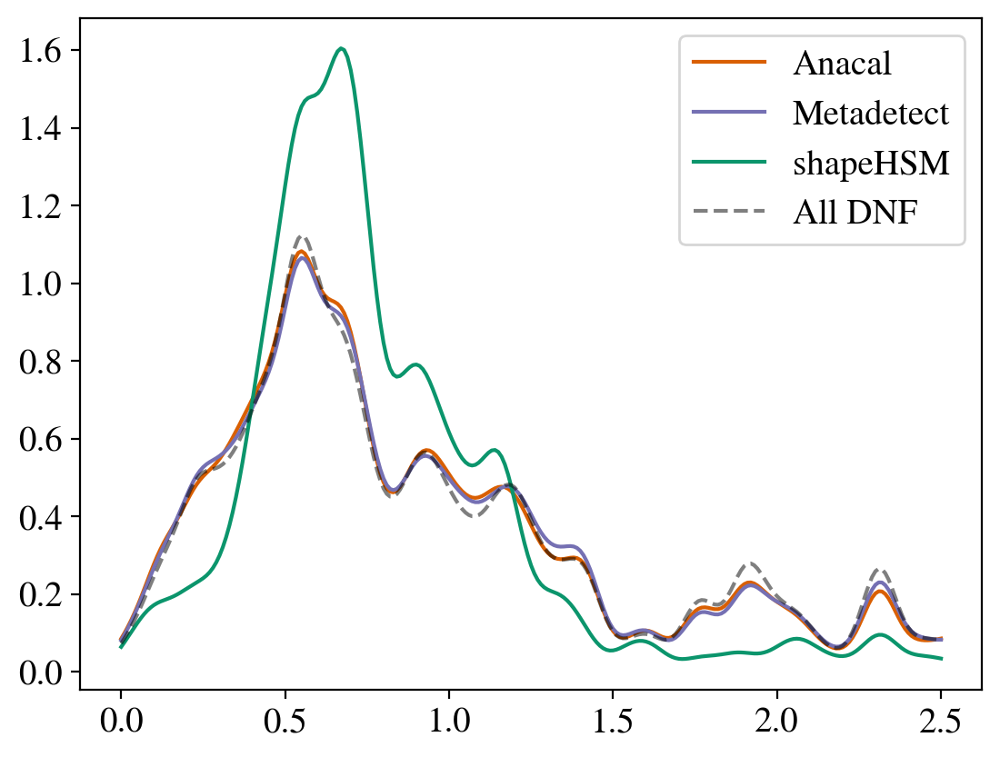

In [280]:
# profile_names = ["HSM - CC", "HSM - CC+PZ", "AnaCal", "Metadetect"]
# colors = ['#0B956C', '#0B956C','#d95f02','#7570b3']

plt.plot(default_xs[:251], anacal_stacked_nz, label='Anacal', color='#d95f02')
plt.plot(default_xs[:251], metadetect_stacked_nz, label='Metadetect', color='#7570b3')
plt.plot(default_xs[:251], sv38_stacked_nz, label='shapeHSM', color='#0B956C')
plt.plot(default_xs[:251], all_pdf[:251], label='All DNF', color='k', ls='--', alpha=0.5)
plt.legend()

### $\beta$ and $\beta^2$ from point estimates

In [235]:
def get_beta_betasqr_point(weights, betas):
    s_w = np.sum(weights)
    beta_s_vals = np.dot(weights, betas)
    beta_s_sqr_vals = np.dot(weights, betas**2)
    avg_beta_s = beta_s_vals / s_w
    avg_beta_s_sqr = beta_s_sqr_vals / s_w
    return avg_beta_s, avg_beta_s_sqr

def get_beta_betasqr_boot_point(weights, points, N=1000):
    avg_betas = np.zeros(N)
    avg_beta_sqrs = np.zeros(N)
    Nsample = len(points)
    beta_points = np.array([beta_s(0.22, z) for z in points])

    for i in range(N):
        boot_filt = rng.choice(Nsample, size=Nsample)
        boot_weights = weights[boot_filt]
        boot_betas = beta_points[boot_filt]
        
        beta_s_sample, beta_s_sqr_sample = get_beta_betasqr_point(boot_weights, boot_betas)
        avg_betas[i] = beta_s_sample
        avg_beta_sqrs[i] = beta_s_sqr_sample
    return avg_betas, avg_beta_sqrs

In [236]:
sv38_table = Table.read('cluster_data/abell360_POSTCUTS_dnf0.37_masked_DP1_widepz.fits')

sigma_shapenoise = np.std(sv38_table['i_hsmShapeRegauss_e1'])**2 + np.std(sv38_table['i_hsmShapeRegauss_e2'])**2
sigma_measurement = 2*sv38_table['i_hsmShapeRegauss_sigma']**2

mpc_dist = (Da(0.22) * np.pi/180 * sv38_table['sep'])
dist_filt = (mpc_dist > 0.7) & (mpc_dist < 3.75)

sv38_w_ls = 1/(0.26**2 + sigma_measurement[dist_filt])
sv38_point_zs = sv38_table['dnf_z_mode'][dist_filt]

In [237]:
ecdfs_table = Table.read('cluster_data/ecdfs_wl_table.fits')

sigma_shapenoise = np.std(ecdfs_table['i_hsmShapeRegauss_e1'])**2 + np.std(ecdfs_table['i_hsmShapeRegauss_e2'])**2
sigma_measurement = 2*ecdfs_table['i_hsmShapeRegauss_sigma']**2
# ecdfs_w_ls = 1/(sigma_shapenoise + sigma_measurement)
ecdfs_w_ls = 1/(0.26**2 + sigma_measurement)
ecdfs_point_zs = ecdfs_table['dnf_z_mode']

In [252]:
anacal_pz_table = Table.read('cluster_data/anacal_pz_table_v2.fits')

ang_dist = np.sqrt(((anacal_pz_table['ra'] - cluster_coords[0]) * np.cos(np.deg2rad(cluster_coords[1])))**2 + (anacal_pz_table['dec'] - cluster_coords[1])**2)
mpc_dist = Da(.22) * ang_dist * (np.pi/180)
point_dist_filt = (mpc_dist > 0.7) & (mpc_dist < 3.75)

pz_weights = anacal_pz_table['wdet'] * (anacal_pz_table['de1_dg1'] + anacal_pz_table['de2_dg2']) / 2.0
anacal_pz_weights = pz_weights[point_dist_filt]
anacal_point_zs = anacal_pz_table['dnf_z_mode'][point_dist_filt]

In [242]:
mdet_table = pd.read_pickle('/sdf/group/rubin/shared/cluster_commissioning/metadetect/md-wl-point-mode_v2.pkl')
mdet_table = Table.from_pandas(mdet_table)

dist_filt = (mdet_table['mpc_sep'] > 0.7) & (mdet_table['mpc_sep'] < 3.75)

mdet_pz_weights = np.ones(np.sum(dist_filt))
mdet_point_zs = mdet_table['dnf_mode'][dist_filt]

In [243]:
ecdfs_betas_points = get_beta_betasqr_boot_point(ecdfs_w_ls, ecdfs_point_zs)
sv38_betas_points = get_beta_betasqr_boot_point(sv38_w_ls, sv38_point_zs)
anacal_betas_points = get_beta_betasqr_boot_point(anacal_pz_weights, anacal_point_zs)
# anacal_betas_points = get_beta_betasqr_boot_point(anacal_no_weights, anacal_point_zs)
mdet_betas_points = get_beta_betasqr_boot_point(mdet_pz_weights, mdet_point_zs)

/tmp/ipykernel_7069/3140841244.py:5: RuntimeWarning: invalid value encountered in scalar divide
  avg_beta_s = beta_s_vals / s_w
/tmp/ipykernel_7069/3140841244.py:6: RuntimeWarning: invalid value encountered in scalar divide
  avg_beta_s_sqr = beta_s_sqr_vals / s_w


In [256]:
beta_samples = [ecdfs_betas_points, sv38_betas_points, anacal_betas_points, mdet_betas_points]
beta_names = ["HSM - CC", "HSM - CC + PZ", "Anacal", "Metadetect"]

for i,sample in enumerate(beta_samples):
    mean_beta = np.mean(sample[0])
    mean_beta_sqr = np.mean(sample[1])
    std_beta = np.std(sample[0])
    std_beta_sqr = np.std(sample[1])
    # print(mean_beta, mean_beta_sqr)
    print(beta_names[i])
    print(f'{mean_beta:0.3f} \\pm {std_beta:0.3f}')
    print(f'{mean_beta_sqr:0.3f} \\pm {std_beta_sqr:0.3f}')
    print('------------------------------------')

HSM - CC
0.600 \pm 0.001
0.426 \pm 0.001
------------------------------------
HSM - CC + PZ
0.641 \pm 0.003
0.439 \pm 0.003
------------------------------------
Anacal
0.543 \pm 0.004
0.357 \pm 0.003
------------------------------------
Metadetect
0.656 \pm 0.004
0.487 \pm 0.004
------------------------------------


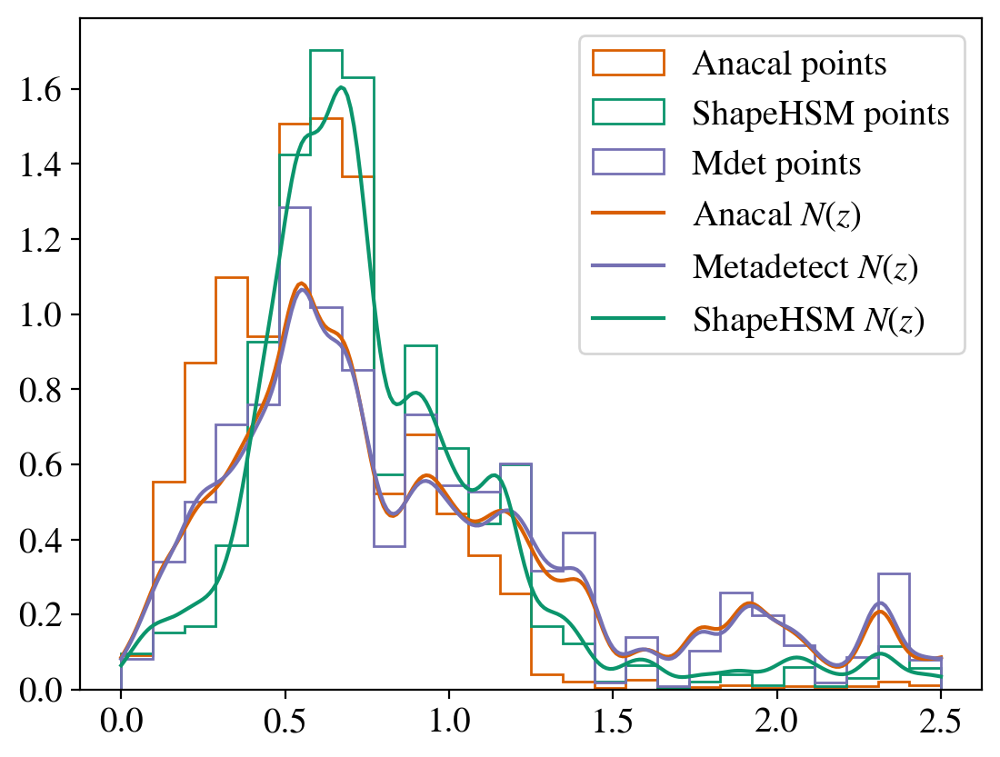

In [257]:
# profile_names = ["HSM - CC", "HSM - CC+PZ", "AnaCal", "Metadetect"]
# colors = ['#0B956C', '#0B956C','#d95f02','#7570b3']

plt.hist(anacal_point_zs, range=(0, 2.5), bins=26, weights=anacal_pz_weights,
         histtype='step', label='Anacal points',
         density=True, color='#d95f02')
plt.hist(sv38_point_zs, range=(0, 2.5), bins=26,
         histtype='step', label='ShapeHSM points',
         density=True, color='#0B956C')
plt.hist(mdet_point_zs, range=(0, 2.5), bins=26,
         histtype='step', label='Mdet points',
         density=True, color='#7570b3')
plt.plot(test_xs, anacal_stacked_nz, label='Anacal $N(z)$', color='#d95f02')
plt.plot(test_xs, metadetect_stacked_nz, label='Metadetect $N(z)$', color='#7570b3')
plt.plot(test_xs, sv38_stacked_nz, label='ShapeHSM $N(z)$', color='#0B956C')
plt.ylim(bottom=0)
plt.legend()

## Profile Comparison

In [655]:
with open(f'./cluster_data/technote/profile_dnf0.37_masked_y3_narrowbins', 'rb') as f:
    hsm_cc_pz = pickle.load(f)

with open(f'./cluster_data/technote/profile_allnoisy_masked_y3_narrowbins', 'rb') as f:
    hsm_cc = pickle.load(f)

with open(f'./cluster_data/technote/profile_metadetect_gauss_beta', 'rb') as f:
    mdet = pickle.load(f)

with open(f'./cluster_data/technote/profile_anacal_globalresponse', 'rb') as f:
    acal = pickle.load(f)
profiles = [acal.profile, mdet.profile, hsm_cc.profile, hsm_cc_pz.profile]

Text(0.5, 1.0, 'Noisy Red Sequence + Mask')

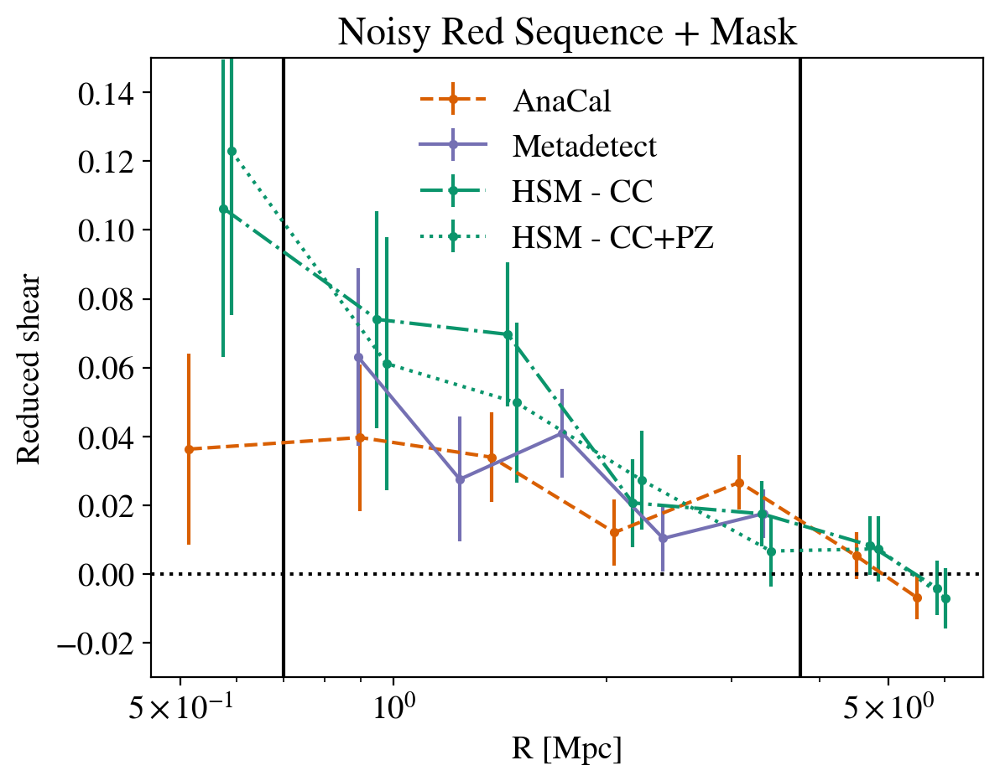

In [663]:
profile_names = ["AnaCal", "Metadetect", "HSM - CC", "HSM - CC+PZ", ]
colors = ['#d95f02','#7570b3', '#0B956C', '#0B956C',]
linestyles = ['--', '-', 'dashdot', ':']

for i,profile in enumerate(profiles):

    plt.errorbar(profile['radius']*(1+.03*i), profile['gt'], profile['gt_err'], 
                 ls=linestyles[i], marker='.', label=f'{profile_names[i]}', color=colors[i])
    # plt.errorbar(profile['radius']*(1.1+.03*i), profile['gx'], profile['gx_err'], 
    #              ls=linestyles[i], marker='x', color=colors[i], alpha=0.4)
    
plt.xlabel("R (Mpc)")
plt.axvline(0.7, ls='-', color='k', alpha=1)
plt.axvline(3.75, ls='-', color='k', alpha=1)
plt.xscale('log')
# plt.yscale('log')
plt.axhline(0.0, color='k', ls=':')
plt.ylim([-0.03,0.15])
plt.xticks([0.5, 1, 5], [r'$5\times 10^{-1}$', '$10^0$', r'$5\times 10^0$'])
# plt.xlim([0.2,7])


#plt.yscale('log')
plt.xlabel('R [Mpc]')
plt.ylabel('Reduced shear')
plt.legend(frameon=False)
plt.title("Noisy Red Sequence + Mask")
# plt.title("HSM Profile with Color Cuts - DP1")

In [ ]:

colors = ['#000000', '#1b9e77','#d95f02','#7570b3']
labels = ['All Colors', 'g-i', 'r-i', 'g-r']

for i,profile in enumerate(noisy_profiles):

    plt.errorbar(profile['radius']*(1+.03*i), profile['gt'], profile['gt_err'], 
                 ls='', marker='.', label=f'{labels[i]}', color=colors[i])
    plt.errorbar(profile['radius']*(1.1+.03*i), profile['gx'], profile['gx_err'], 
                 ls='', marker='x', color=colors[i], alpha=0.4)

plt.xscale('log')
# plt.yscale('log')
plt.axhline(0.0, color='k', ls=':')
plt.ylim([-0.03,0.15])
plt.xlim([0.2,7])
#plt.yscale('log')
plt.xlabel('R [Mpc]')
plt.ylabel('Reduced shear')
plt.legend(loc=1, frameon=False)
plt.title("Noisy Red Sequence + Mask")
# plt.title("HSM Profile with Color Cuts - DP1")

In [30]:
cc_types = ['all', 'gi', 'ri', 'gr']
profiles = []

for cc in cc_types:
    with open(f'./cluster_data/technote/profile_{cc}noisy_y3_narrowbins', 'rb') as f:
        profile = pickle.load(f)
        profiles.append(profile.profile)

In [31]:
cc_types = ['all', 'gi', 'ri', 'gr']
noisy_profiles = []

for cc in cc_types:
    with open(f'./cluster_data/technote/profile_{cc}noisy_masked_y3_narrowbins', 'rb') as f:
        profile = pickle.load(f)
        noisy_profiles.append(profile.profile)

Text(0.5, 1.0, 'Noisy Red Sequence + Mask')

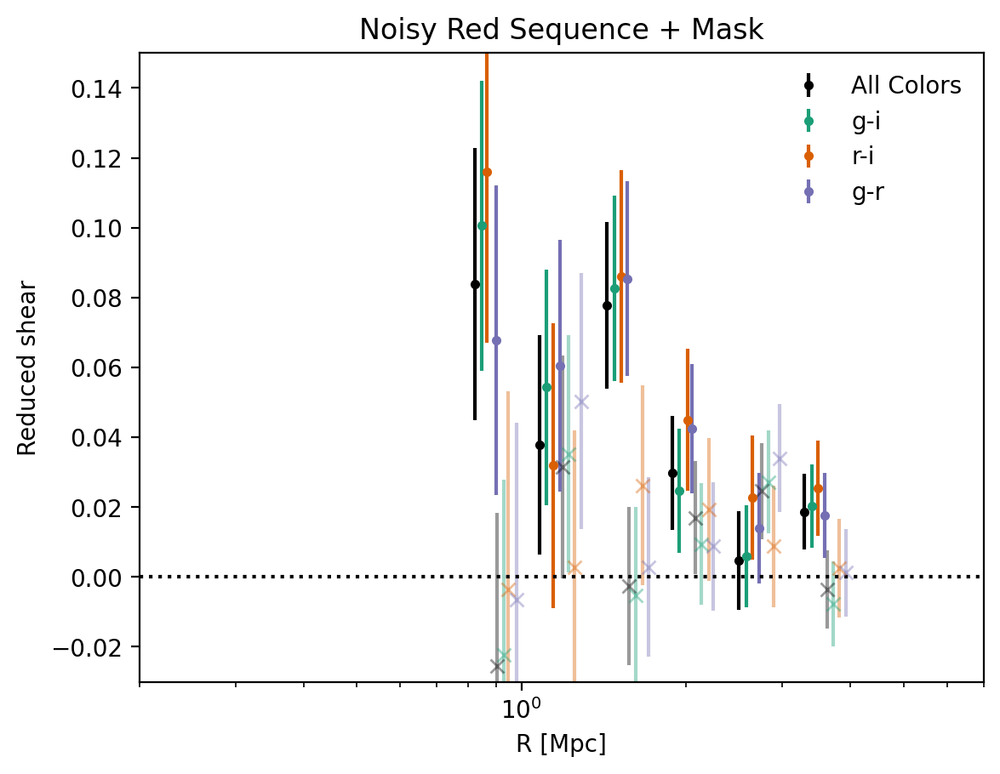

In [32]:

colors = ['#000000', '#1b9e77','#d95f02','#7570b3']
labels = ['All Colors', 'g-i', 'r-i', 'g-r']

for i,profile in enumerate(noisy_profiles):

    plt.errorbar(profile['radius']*(1+.03*i), profile['gt'], profile['gt_err'], 
                 ls='', marker='.', label=f'{labels[i]}', color=colors[i])
    plt.errorbar(profile['radius']*(1.1+.03*i), profile['gx'], profile['gx_err'], 
                 ls='', marker='x', color=colors[i], alpha=0.4)

plt.xscale('log')
# plt.yscale('log')
plt.axhline(0.0, color='k', ls=':')
plt.ylim([-0.03,0.15])
plt.xlim([0.2,7])
#plt.yscale('log')
plt.xlabel('R [Mpc]')
plt.ylabel('Reduced shear')
plt.legend(loc=1, frameon=False)
plt.title("Noisy Red Sequence + Mask")
# plt.title("HSM Profile with Color Cuts - DP1")

Text(0, 0.5, 'Reduced shear')

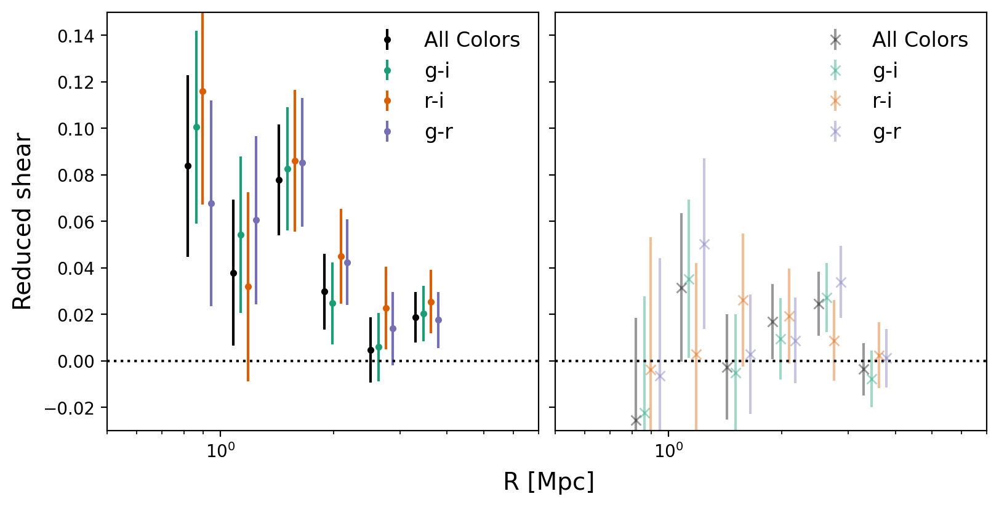

In [52]:

colors = ['#000000', '#1b9e77','#d95f02','#7570b3']
labels = ['All Colors', 'g-i', 'r-i', 'g-r']

fig, ax = plt.subplots(ncols=2, figsize=(8,4), sharey=True, layout='constrained')

for i,profile in enumerate(noisy_profiles):

    ax[0].errorbar(profile['radius']*(1+.05*i), profile['gt'], profile['gt_err'], 
                 ls='', marker='.', label=f'{labels[i]}', color=colors[i])
    ax[1].errorbar(profile['radius']*(1+.05*i), profile['gx'], profile['gx_err'], 
                 ls='', marker='x', label=f'{labels[i]}', color=colors[i], alpha=0.4)

for xx in ax:
    xx.set_xscale('log')
    # plt.yscale('log')
    xx.axhline(0.0, color='k', ls=':')
    xx.set_ylim([-0.03,0.15])
    xx.set_xlim([0.5,7])
    xx.legend(loc=1, frameon=False, fontsize=12)
    #plt.yscale('log')
fig.supxlabel('R [Mpc]', fontsize=14, x=0.55)
ax[0].set_ylabel('Reduced shear', fontsize=14)

    # plt.title("Noisy Red Sequence + Mask")
# plt.title("HSM Profile with Color Cuts - DP1")

Text(0.5, 1.0, 'Noisy Red Sequence')

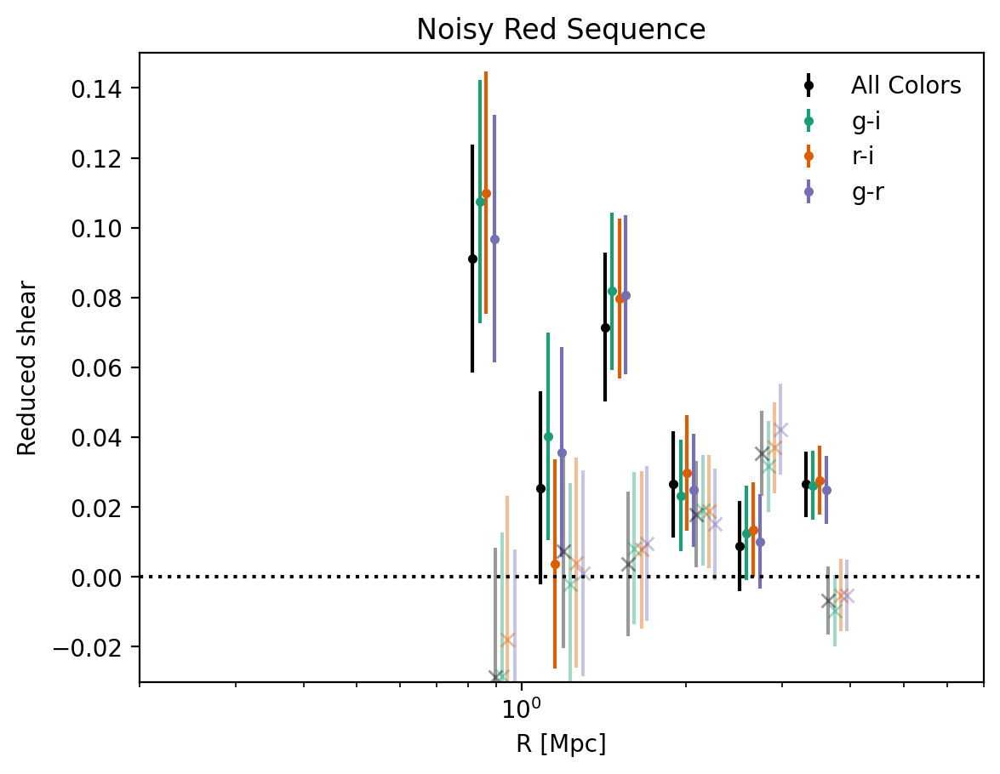

In [198]:

colors = ['#000000', '#1b9e77','#d95f02','#7570b3']
labels = ['All Colors', 'g-i', 'r-i', 'g-r']

for i,profile in enumerate(profiles):

    plt.errorbar(profile['radius']*(1+.03*i), profile['gt'], profile['gt_err'], 
                 ls='', marker='.', label=f'{labels[i]}', color=colors[i])
    plt.errorbar(profile['radius']*(1.1+.03*i), profile['gx'], profile['gx_err'], 
                 ls='', marker='x', color=colors[i], alpha=0.4)

plt.xscale('log')
# plt.yscale('log')
plt.axhline(0.0, color='k', ls=':')
plt.ylim([-0.03,0.15])
plt.xlim([0.2,7])
#plt.yscale('log')
plt.xlabel('R [Mpc]')
plt.ylabel('Reduced shear')
plt.legend(loc=1, frameon=False)
plt.title("Noisy Red Sequence")
# plt.title("HSM Profile with Color Cuts - DP1")

In [122]:
# pz_types = ['bpz0.37', 'tpz0.37', 'fzboost0.37', 'knn0.37']
pz_types = ['gpz0.37', 'dnf0.37', 'lephare0.37', 'cmnn0.37']
pz_profiles = []

for cc in pz_types:
    with open(f'./cluster_data/technote/profile_{cc}_y3', 'rb') as f:
        profile = pickle.load(f)
        pz_profiles.append(profile.profile)

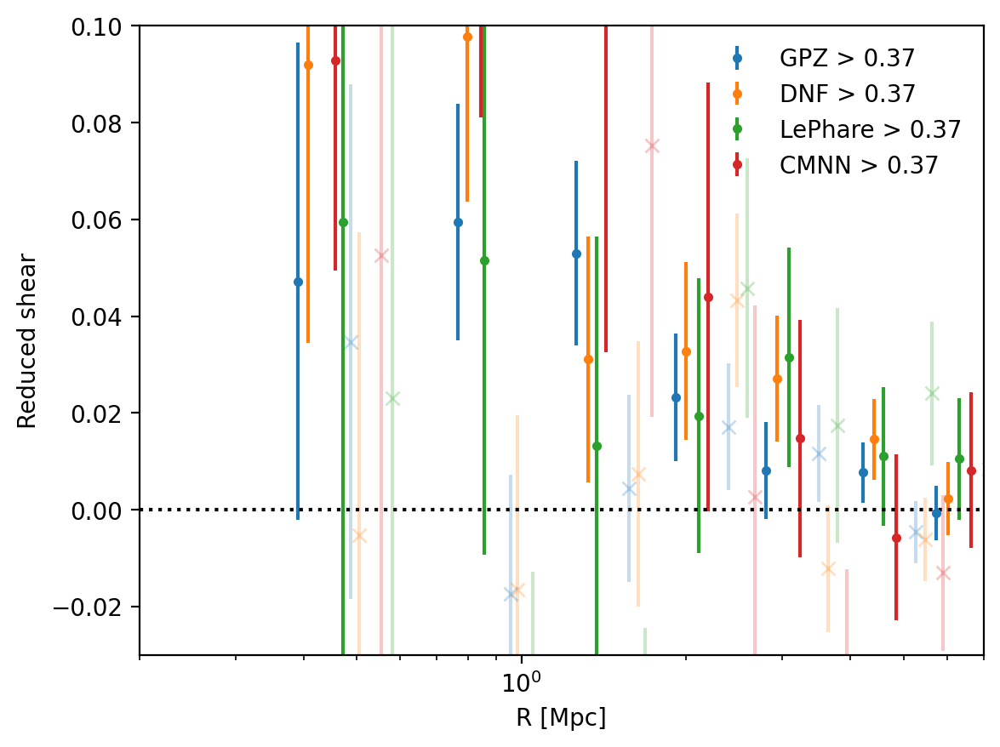

In [123]:

cmap = cm.tab10
labels = ['BPZ > 0.37', 'TPZ > 0.37',  'FZBoost > 0.37', 'kNN > 0.37']
labels = ['GPZ > 0.37', 'DNF > 0.37',  'LePhare > 0.37', 'CMNN > 0.37']
# colors = [cmap(0), cmap(1.),cmap(.25), cmap(0.75)]
colors = [cmap(i) for i in range(4)]


for i,profile in enumerate(pz_profiles):
    plt.errorbar(profile['radius']*(1+.05*i), profile['gt'], profile['gt_err'], 
                 ls='', marker='.', label=f'{labels[i]}', color=colors[i])
    plt.errorbar(profile['radius']*(1.25+.05*i), profile['gx'], profile['gx_err'], 
                 ls='', marker='x', color=colors[i], alpha=0.25)

plt.xscale('log')
# plt.yscale('log')
plt.axhline(0.0, color='k', ls=':')
plt.ylim([-0.03,0.1])
plt.xlim([0.2,7])
#plt.yscale('log')
plt.xlabel('R [Mpc]')
plt.ylabel('Reduced shear')
plt.legend(loc=1, frameon=False)
# plt.title("HSM Profile with PZ Cuts - DP1")

In [29]:
with open(f'./weights_clmm', 'rb') as f:
    clmm_catalog = pickle.load(f)
    weighted_profile = clmm_catalog.profile

with open(f'./noweights_clmm', 'rb') as f:
    clmm_catalog = pickle.load(f)
    unweighted_profile = clmm_catalog.profile

Text(0, 0.5, 'Reduced shear')

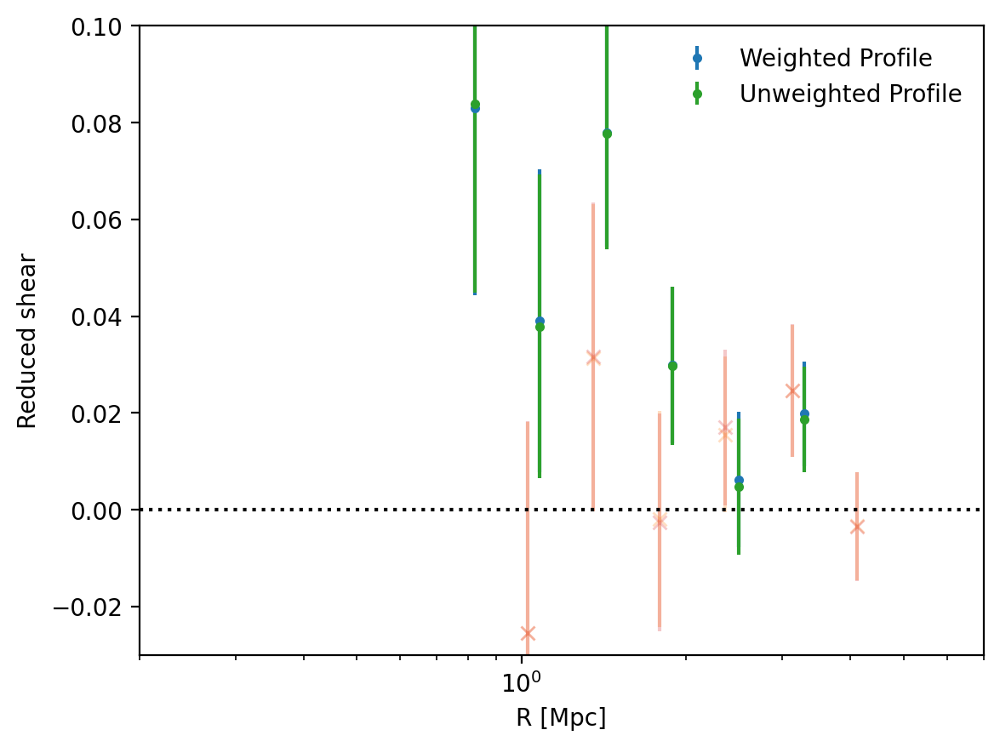

In [33]:

plt.errorbar(weighted_profile['radius']*(1), weighted_profile['gt'], weighted_profile['gt_err'], 
             ls='', marker='.', label='Weighted Profile')
plt.errorbar(weighted_profile['radius']*(1.25), weighted_profile['gx'], weighted_profile['gx_err'], 
             ls='', marker='x', alpha=0.25)

plt.errorbar(unweighted_profile['radius']*(1), unweighted_profile['gt'], unweighted_profile['gt_err'], 
             ls='', marker='.', label='Unweighted Profile')
plt.errorbar(unweighted_profile['radius']*(1.25), unweighted_profile['gx'], unweighted_profile['gx_err'], 
             ls='', marker='x', alpha=0.25)

plt.xscale('log')
# plt.yscale('log')
plt.axhline(0.0, color='k', ls=':')
plt.ylim([-0.03,0.1])
plt.xlim([0.2,7])
plt.legend(frameon=False)
#plt.yscale('log')
plt.xlabel('R [Mpc]')
plt.ylabel('Reduced shear')
# plt.title("HSM Profile with PZ Cuts - DP1")

In [77]:
kale = Table.read('cluster_data/wl_pztable_new.fits')

In [93]:
np.sum(kale[~kale['all_redseq']]['dnf_z_median'] < 0.2)

np.int64(358)

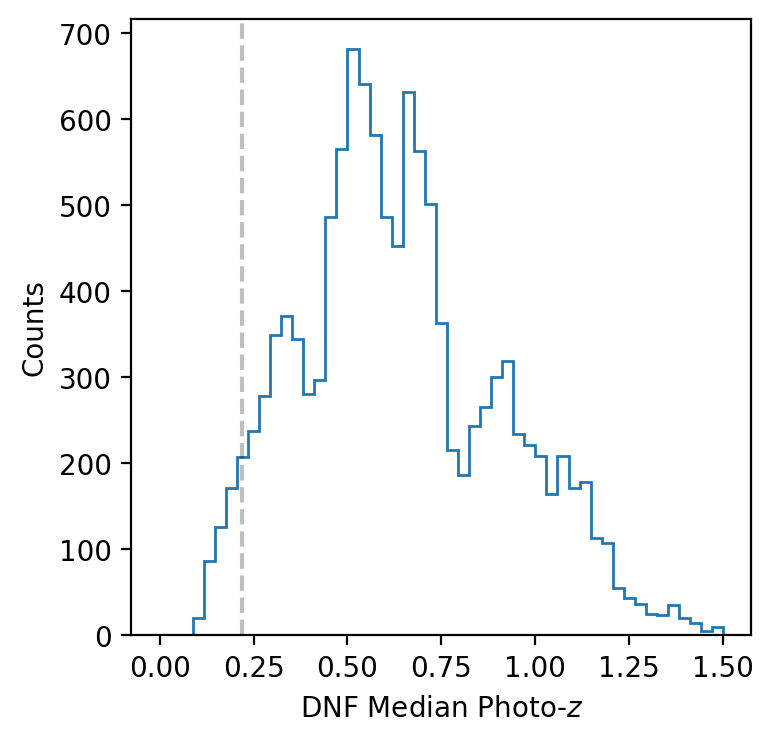

In [95]:
fig, ax = plt.subplots(1, figsize=(4,4))

ax.hist(kale['dnf_z_median'], range=(0, 1.5), bins=51, histtype='step')
# ax.hist(kale[kale['all_redseq']]['dnf_z_median'], range=(0, 1.5), bins=51, histtype='step')
ax.set_xlabel("DNF Median Photo-$z$")
ax.set_ylabel("Counts")
ax.axvline(0.22, ls='--', color='k', alpha=0.25)

### Shear Ratio Test

In [206]:
import clmm
from clmm import GalaxyCluster, ClusterEnsemble, GCData, Cosmology
from clmm import Cosmology, utils

cosmo = clmm.Cosmology(H0=70.0, Omega_dm0=0.3 - 0.045, Omega_b0=0.045, Omega_k0=0.0)

In [199]:
# From Shenming's CLMM demo on using HSC data
def apply_shear_calibration(e1_0, e2_0, e_rms, m, c1, c2, weight):
    R = 1.0 - np.sum(weight * e_rms**2.0) / np.sum(weight)
    m_mean = np.sum(weight * m) / np.sum(weight)
    c1_mean = np.sum(weight * c1) / np.sum(weight)
    c2_mean = np.sum(weight * c2) / np.sum(weight)
    print("R, m_mean, c1_mean, c2_mean: ", R, m_mean, c1_mean, c2_mean)

    g1 = (e1_0 / (2.0 * R) - c1) / (1.0 + m_mean)
    g2 = (e2_0 / (2.0 * R) - c2) / (1.0 + m_mean)

    return g1, g2


In [207]:
algos = ['knn', 'fzboost', 'bpz', 'tpz']
bin_names = ['bin1', 'bin2']

In [262]:
algo_profiles = {}

for calib_type in algos:
    for bn in bin_names:
        print(f"Working on {calib_type} {bn}")
    
        postcuts_filename = f'technote/shear-ratio_{calib_type}{bn}_DP1.fits'
        calib_filename = f'technote/shear_ratio_calib_{calib_type}_{bn}.fits'
    
        with fits.open(f'cluster_data/{calib_filename}') as hdul:
            # Assuming data is in the first HDU (if not, change the index as needed)
            data = hdul[1].data
    
            # Convert the FITS data to an Astropy Table
            table = Table(data)
    
        with fits.open(f'cluster_data/{postcuts_filename}') as hdul:
            # Assuming data is in the first HDU (if not, change the index as needed)
            data = hdul[1].data
    
            # Convert the FITS data to an Astropy Table
            wl_table = Table(data)
    
        e_rms = table["ishape_hsm_regauss_derived_rms_e"]
        m = table["ishape_hsm_regauss_derived_shear_bias_m"]
        c1 = table["ishape_hsm_regauss_derived_shear_bias_c1"]
        c2 = table["ishape_hsm_regauss_derived_shear_bias_c2"]
        weight = table["ishape_hsm_regauss_derived_shape_weight"]
        # weight = np.ones(len(c1))
    
        g1, g2 = apply_shear_calibration(wl_table['i_hsmShapeRegauss_e1'], wl_table['i_hsmShapeRegauss_e2'], e_rms, m, c1, c2, weight)
    
        galcat = GCData()
        galcat['ra'] = wl_table['coord_ra']
        galcat['dec'] = wl_table['coord_dec']
        galcat['e1'] = g1
        galcat['e2'] = g2
        galcat['e_err'] = wl_table['i_hsmShapeRegauss_sigma']/2
        galcat['hsm_weight'] = weight
        galcat['id'] = np.arange(len(wl_table))
        galcat['z'] = np.zeros(len(wl_table))
        # galcat['z'] = wl_table['fzb_z_median']
    
        ra_bcg = 37.865017
        dec_bcg = 6.982205
        
        cluster_id = "Abell 360"
        gc_object1 = clmm.GalaxyCluster(cluster_id, ra_bcg, dec_bcg, 0.22, galcat, coordinate_system='euclidean')
    
        gc_object1.compute_tangential_and_cross_components(add=True);
        bins_mpc = np.array([.25, .5, 1, 1.5, 2.27, 3.3, 5, 7]) 
     
        gc_object1.make_radial_profile(bins=bins_mpc, bin_units='Mpc', add=True, cosmo=cosmo, 
                                   overwrite=True, use_weights=False, gal_ids_in_bins=False);
        algo_profiles[(calib_type, bn)] = gc_object1.profile

Working on knn bin1
R, m_mean, c1_mean, c2_mean:  0.8507852581234192 -0.0757610319317728 -1.80525784488124e-05 9.67227069517149e-06
Working on knn bin2
R, m_mean, c1_mean, c2_mean:  0.8428679777941148 -0.11161964415980455 -0.0003827883791800409 -2.2700211857176177e-05
Working on fzboost bin1
R, m_mean, c1_mean, c2_mean:  0.853753794785097 -0.056246820243661136 0.00013707294533029467 1.316323729456556e-05
Working on fzboost bin2
R, m_mean, c1_mean, c2_mean:  0.8436046997897865 -0.08931549574129578 -0.0003299916848557445 -3.483495925856697e-05
Working on bpz bin1
R, m_mean, c1_mean, c2_mean:  0.8496120311850853 -0.08070947082450636 -8.652164986558431e-05 -4.20825844448325e-06
Working on bpz bin2
R, m_mean, c1_mean, c2_mean:  0.8451347391477535 -0.08090421650003288 -0.0002830273579807718 -5.971653608379527e-06
Working on tpz bin1
R, m_mean, c1_mean, c2_mean:  0.8523100644928511 -0.05986017122355586 2.983781004426725e-05 1.1427323101747962e-06
Working on tpz bin2
R, m_mean, c1_mean, c2_mea

In [267]:
gc_object1.profile

radius_min,radius,radius_max,gt,gt_err,gx,gx_err,z,z_err,n_src,W_l
float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,float64
0.25,0.39632851403785413,0.5,0.009441891312178487,0.05855085188442001,0.0026745408004181037,0.09944776555742985,0.0,0.0,11,11.0
0.5,0.756388691854338,1.0,0.07709165417443203,0.04054107804044779,-0.04075655467857554,0.038085461401220114,0.0,0.0,45,45.0
1.0,1.271848424486781,1.5,-0.0015788453892636558,0.027437390393657456,6.846888070953516e-05,0.027412685364038118,0.0,0.0,96,96.0
1.5,1.9073743817449897,2.27,0.0310946159555359,0.01738787111247196,0.04116089263767675,0.016377846955399088,0.0,0.0,218,218.0
2.27,2.7921006069735386,3.3,0.044697650393187245,0.012733115314093485,0.004371723711584023,0.012624491317362279,0.0,0.0,413,413.0
3.3,4.192417429349808,5.0,0.007552980308977855,0.008262772429571687,-0.006602461712351294,0.008225493117828752,0.0,0.0,976,976.0
5.0,5.738780750240027,7.0,-0.00536031300303605,0.007190092845021429,0.026954104712700506,0.007497382892848415,0.0,0.0,1207,1207.0


In [268]:
plot_means_t = np.zeros((len(algos), 2))
plot_errs_t = np.zeros((len(algos), 2))

plot_means_x = np.zeros((len(algos), 2))
plot_errs_x = np.zeros((len(algos), 2))

for i,alg in enumerate(algos):
    for j, bn in enumerate(bin_names):
        profile = algo_profiles[(alg, bn)]
        plot_means_t[i,j] = profile['gt'][1]
        plot_errs_t[i,j] = profile['gt_err'][1]
        plot_means_x[i,j] = profile['gx'][1]
        plot_errs_x[i,j] = profile['gx_err'][1]

Text(0.02, 0.5, 'Reduced shear')

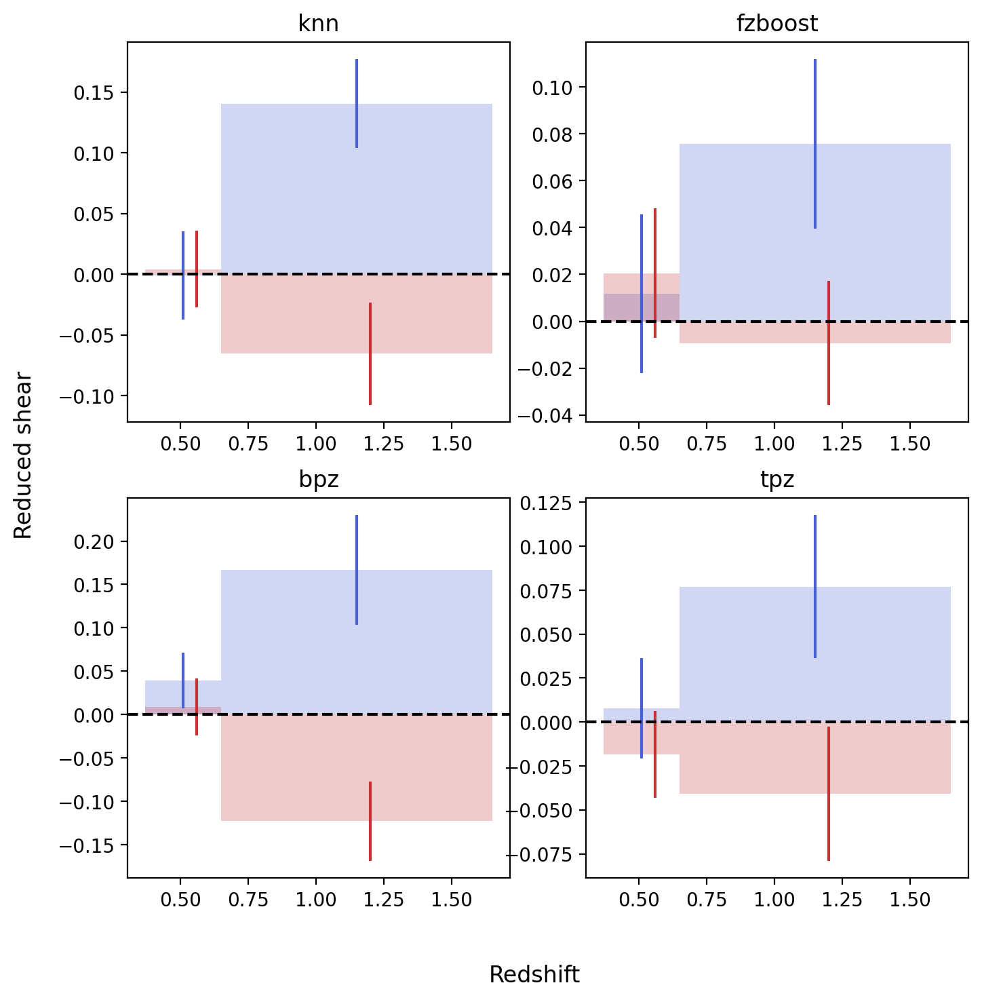

In [274]:
fig, axes = plt.subplots(2, 2, figsize=(8,8))

cmap = cm.coolwarm

for i in range(4):
    ix = i//2
    iy = i%2

    axes[ix, iy].bar([0.51, 1.15], height=plot_means_t[i], width=[0.28, 1], color=cmap(0.05), alpha=0.25)
    axes[ix, iy].errorbar(x=[0.51, 1.15], y=plot_means_t[i], yerr=plot_errs_t[i], color=cmap(0.05), ls='')
    axes[ix, iy].bar([0.51, 1.15], height=plot_means_x[i], width=[0.28, 1], color=cmap(0.95), alpha=0.25)
    axes[ix, iy].errorbar(x=[0.51+0.05, 1.15+0.05], y=plot_means_x[i], yerr=plot_errs_x[i], color=cmap(0.95), ls='')
    axes[ix, iy].set_title(algos[i])
    # axes[ix, iy].set_ylim(-.01, .02)
    axes[ix, iy].axhline(0, ls='--', color='k')
fig.supxlabel("Redshift")
fig.supylabel("Reduced shear")

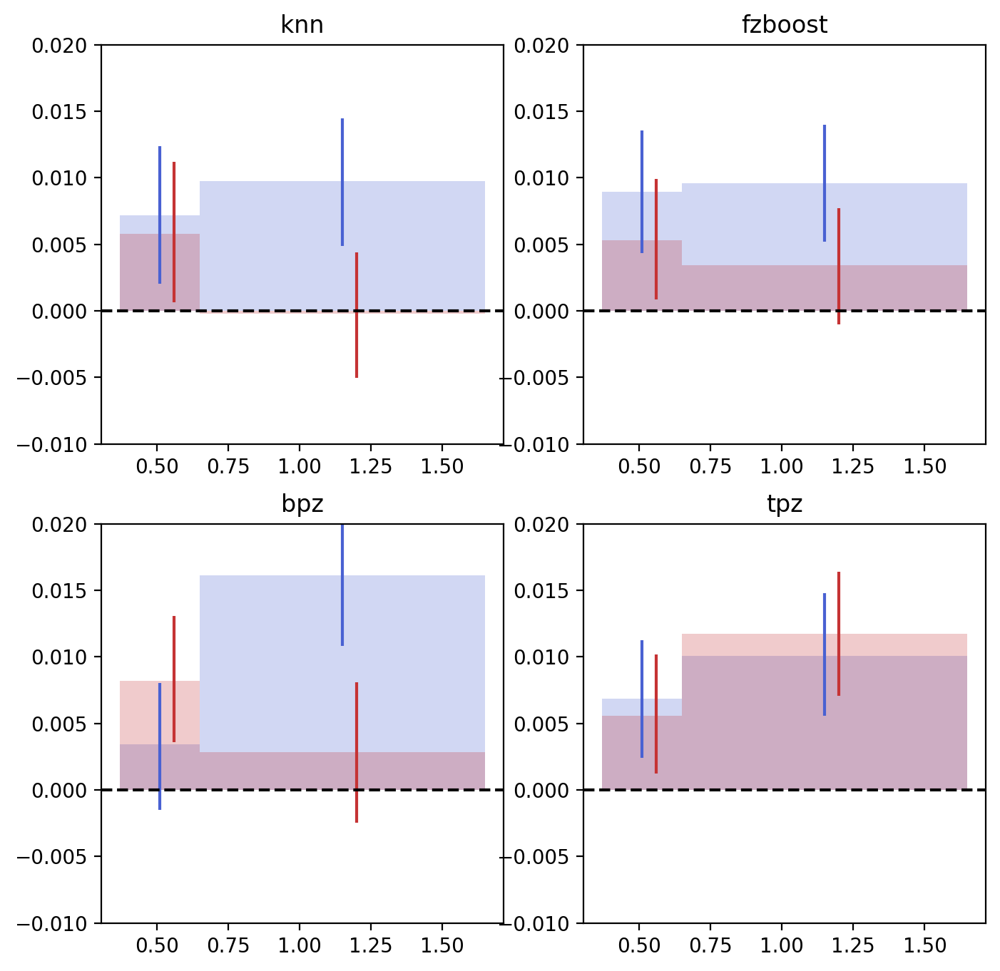

In [261]:
fig, axes = plt.subplots(2, 2, figsize=(8,8))

cmap = cm.coolwarm

for i in range(4):
    ix = i//2
    iy = i%2

    axes[ix, iy].bar([0.51, 1.15], height=plot_means_t[i], width=[0.28, 1], color=cmap(0.05), alpha=0.25)
    axes[ix, iy].vlines([0.51, 1.15], ymin=plot_errs_t[i,:,0], ymax=plot_errs_t[i,:,1], color=cmap(0.05))
    axes[ix, iy].bar([0.51, 1.15], height=plot_means_x[i], width=[0.28, 1], color=cmap(0.95), alpha=0.25)
    axes[ix, iy].vlines([0.51+.05, 1.15+.05], ymin=plot_errs_x[i,:,0], ymax=plot_errs_x[i,:,1], color=cmap(0.95))
    axes[ix, iy].set_title(algos[i])
    axes[ix, iy].set_ylim(-.01, .02)
    axes[ix, iy].axhline(0, ls='--', color='k')

## Data Summary Plot

Assuming the Butler cells were ran up-to creating the preclean_table

In [116]:
# # Get point estimates for the entire field (169034 objects)
pz_ests = pd.read_parquet(pz_sv38_point)
pz_ests = Table.from_pandas(pz_ests)

In [117]:
method_list = ['fzboost', 'knn', 'cmnn', 'dnf', 'tpz', 'gpz', 'bpz', 'lephare']

for algo in method_list:
    zwidth = np.abs(pz_ests[f'{algo}_z_err95_high'] - pz_ests[f'{algo}_z_err95_low'])
    pz_ests[algo+'_diff'] = zwidth

In [118]:
# We could load this in via butler we did save this earlier :)
# This is the cleaned catalog that removed entries if any of the measurement algorithms failed.
# dp1_catalog = Table.read('cluster_data/abell360_PRECUTS_DP1_new.fits', format="fits")
# dp1_catalog, _ = load_pz_photomdata(ddir='/global/cfs/cdirs/lsst/groups/PZ/DP1/data/dp1_v29.0.0/', suffix='parquet')
dp1_catalog, _ = load_pz_photomdata(clean_fn=preclean_filt)
# dp1_catalog, _ = load_pz_photomdata(clean_fn=preclean_flux_filt)
# dp1_catalog = Table.read('cluster_data/abell360_PRECUTS_DP1_gaap_cModel.fits', format="fits")

/opt/lsst/software/stack/conda/envs/lsst-scipipe-12.1.0/lib/python3.13/site-packages/astropy/units/function/logarithmic.py:67: RuntimeWarning: divide by zero encountered in log10
  return dex.to(self._function_unit, np.log10(x))
/opt/lsst/software/stack/conda/envs/lsst-scipipe-12.1.0/lib/python3.13/site-packages/astropy/units/function/logarithmic.py:67: RuntimeWarning: invalid value encountered in log10
  return dex.to(self._function_unit, np.log10(x))


In [119]:
pz_table = join(dp1_catalog, pz_ests, keys='objectId')

In [164]:
# clean_table2 = preclean_table[preclean_filt(preclean_table)]
clean_table = preclean_table[preclean_flux_filt(preclean_table)]

In [165]:
clean_table = apply_redsequence_noisy(clean_table, mag_lim=23.76, sigma=1)

In [166]:
clean_mask = get_masks(clean_table)
clean_table_masked = clean_table[clean_mask]

In [167]:
clean_table_psf = clean_table_masked[~clean_table_masked['i_iPSF_flag']]
clean_table_hsm = clean_table_psf[~clean_table_psf['i_hsmShapeRegauss_flag']]
# clean_table_extend = clean_table[clean_table['refExtendedness'] == 1]

In [168]:
wl_filt = get_wlfilt(clean_table_hsm, mag_lim=28, bright_lim=20, SNR=0, apply_extend=False, apply_res=False)
wl_table = clean_table_hsm[wl_filt]

After WL cuts: 20825


In [169]:
# wl_table_bright = wl_table[wl_table['i_cModel_mag'] < 23.76]

In [170]:
# gstars = wl_table_bright[wl_table_bright['g_extendedness']==0]

# # for b in bands:
# #     print(b, np.sum(wl_table_bright[f'{b}_extendedness'] == 0))

In [171]:
wl_table_gal = wl_table[(wl_table['refExtendedness'] == 1) * (wl_table['res'] >= 0.3)]
# wl_table_gal = wl_table[(wl_table['res'] >= 0.3)]
print(len(wl_table_gal))

18821


In [172]:
imag_table = wl_table_gal[wl_table_gal['i_cModel_mag'] < 23.76]
Nimag_table = len(imag_table)

In [173]:
SNR_cut14 = imag_table[imag_table['i_cModelFlux']/imag_table['i_cModelFluxErr'] > 14]
SNR_cut10 = imag_table[imag_table['i_cModelFlux']/imag_table['i_cModelFluxErr'] > 10]
Nsnr = len(SNR_cut10)
print((Nimag_table-Nsnr)/Nimag_table)

0.026632131234641695


In [180]:
rs_cut = SNR_cut10[~SNR_cut10['all_redseq']]

In [181]:
pz_cut = pz_table[np.isin(pz_table['objectId'], rs_cut['objectId'])]
print(len(pz_cut))
pz_cut= pz_cut[pz_cut['dnf_z_median'] > 0.37]
print(len(pz_cut))

10843
9187


In [182]:
# missed_pz = rs_cut[~np.isin(rs_cut['objectId'], pz_table['objectId'])]
missed_pz = pz_table[~np.isin(pz_table['objectId'], rs_cut['objectId'])]

In [183]:
for cl in missed_pz.columns:
    # print(cl)
    if missed_pz[cl].dtype.kind == 'f':
        n_nan = np.sum(np.isnan(missed_pz[cl]))
        if n_nan > 0:
            print(cl, n_nan)

In [139]:
hist_bins = np.array([[i, i+0.25, i+.5, i+.75,] for i in range(18, 28)])
hist_bins = np.ravel(hist_bins)

[]

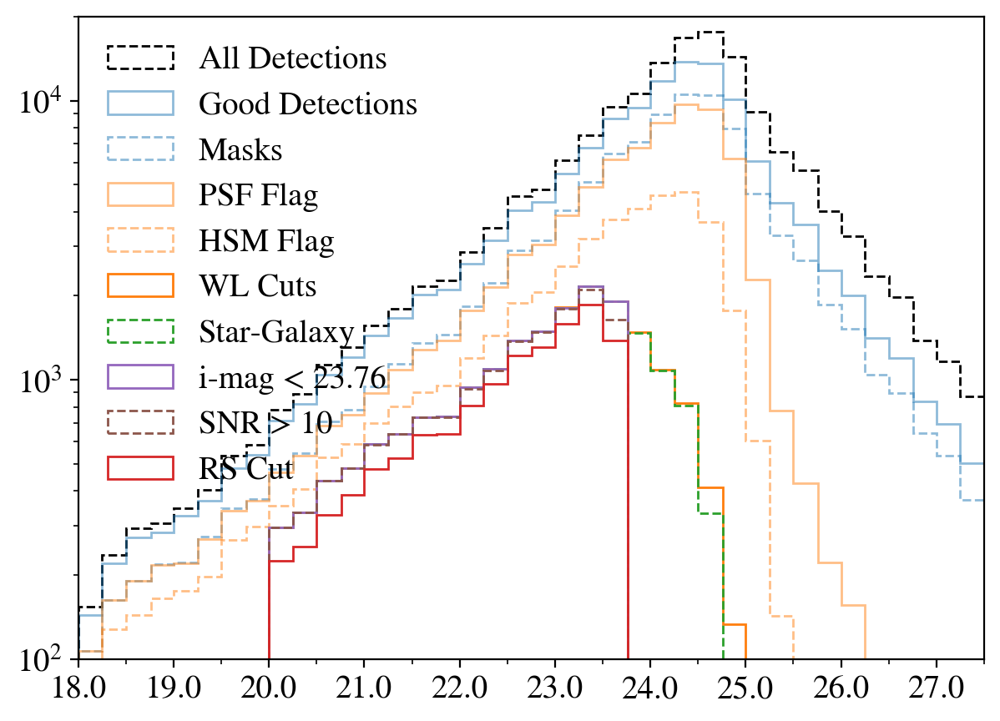

In [146]:
major_xticks = np.arange(18, 28.5, 1)
minor_xticks = np.arange(18.5, 28.5, 1)

cmap = cm.tab10

fig, ax = plt.subplots(1, figsize=(7,5))

# ax.hist(preclean_table['i_cModel_mag'], bins=hist_bins, histtype='step', label="All Detections", color='k')
# ax.hist(clean_table['i_cModel_mag'], bins=hist_bins, histtype='step', label="Good Detections", color=cmap(0), alpha=0.5, ls='--')
# ax.hist(clean_table_masked['i_cModel_mag'], bins=hist_bins, histtype='step', label="Masks", color=cmap(0), alpha=0.5)
# ax.hist(clean_table_psf['i_cModel_mag'], bins=hist_bins, histtype='step', label="PSF Flag", color=cmap(1), alpha=0.5, ls='--')
# ax.hist(clean_table_hsm['i_cModel_mag'], bins=hist_bins, histtype='step', label="HSM Flag", color=cmap(1), alpha=0.5, ls='-')
# ax.hist(wl_table['i_cModel_mag'], bins=hist_bins, histtype='step', label="WL Cuts", color=cmap(1), ls='--')
# ax.hist(wl_table_gal['i_cModel_mag'], bins=hist_bins, histtype='step', label="Star-Galaxy", color=cmap(2))
# ax.hist(imag_table['i_cModel_mag'], bins=hist_bins, histtype='step', label="i-mag < 23.76", color=cmap(4), ls='--')
# ax.hist(SNR_cut10['i_cModel_mag'], bins=hist_bins, histtype='step', label="SNR > 10", color=cmap(5))
# # plt.hist(SNR_cut14['i_cModel_mag'], range=(18, 28), histtype='step', bins=31, label="SNR > 14", color=cmap(4))
# ax.hist(rs_cut['i_cModel_mag'], bins=hist_bins, histtype='step', label="RS Cut", color=cmap(3), ls='--')

ax.hist(preclean_table['i_cModel_mag'], bins=hist_bins, histtype='step', label="All Detections", color='k', ls='--')
ax.hist(clean_table['i_cModel_mag'], bins=hist_bins, histtype='step', label="Good Detections", color=cmap(0), alpha=0.5)
ax.hist(clean_table_masked['i_cModel_mag'], bins=hist_bins, histtype='step', label="Masks", color=cmap(0), alpha=0.5, ls='--')
ax.hist(clean_table_psf['i_cModel_mag'], bins=hist_bins, histtype='step', label="PSF Flag", color=cmap(1), alpha=0.5)
ax.hist(clean_table_hsm['i_cModel_mag'], bins=hist_bins, histtype='step', label="HSM Flag", color=cmap(1), alpha=0.5, ls='--')
ax.hist(wl_table['i_cModel_mag'], bins=hist_bins, histtype='step', label="WL Cuts", color=cmap(1))
ax.hist(wl_table_gal['i_cModel_mag'], bins=hist_bins, histtype='step', label="Star-Galaxy", color=cmap(2), ls='--')
ax.hist(imag_table['i_cModel_mag'], bins=hist_bins, histtype='step', label="i-mag < 23.76", color=cmap(4))
ax.hist(SNR_cut10['i_cModel_mag'], bins=hist_bins, histtype='step', label="SNR > 10", color=cmap(5), ls='--')
# plt.hist(SNR_cut14['i_cModel_mag'], range=(18, 28), histtype='step', bins=31, label="SNR > 14", color=cmap(4))
ax.hist(rs_cut['i_cModel_mag'], bins=hist_bins, histtype='step', label="RS Cut", color=cmap(3))

ax.set_xticks(major_xticks, major_xticks, minor=False)
ax.set_xticks(minor_xticks, minor=True)
ax.set_ylim(1e2, 2e4)
ax.set_xlim(major_xticks[0], minor_xticks[-1])
ax.legend(frameon=False, ncol=1, loc='upper left', columnspacing=1)
ax.semilogy()
# ax.set_title("Abell 360 Field")

In [140]:
hist_bins = np.array([[i, i+0.25, i+.5, i+.75] for i in range(17, 28)])
hist_bins = np.ravel(hist_bins)

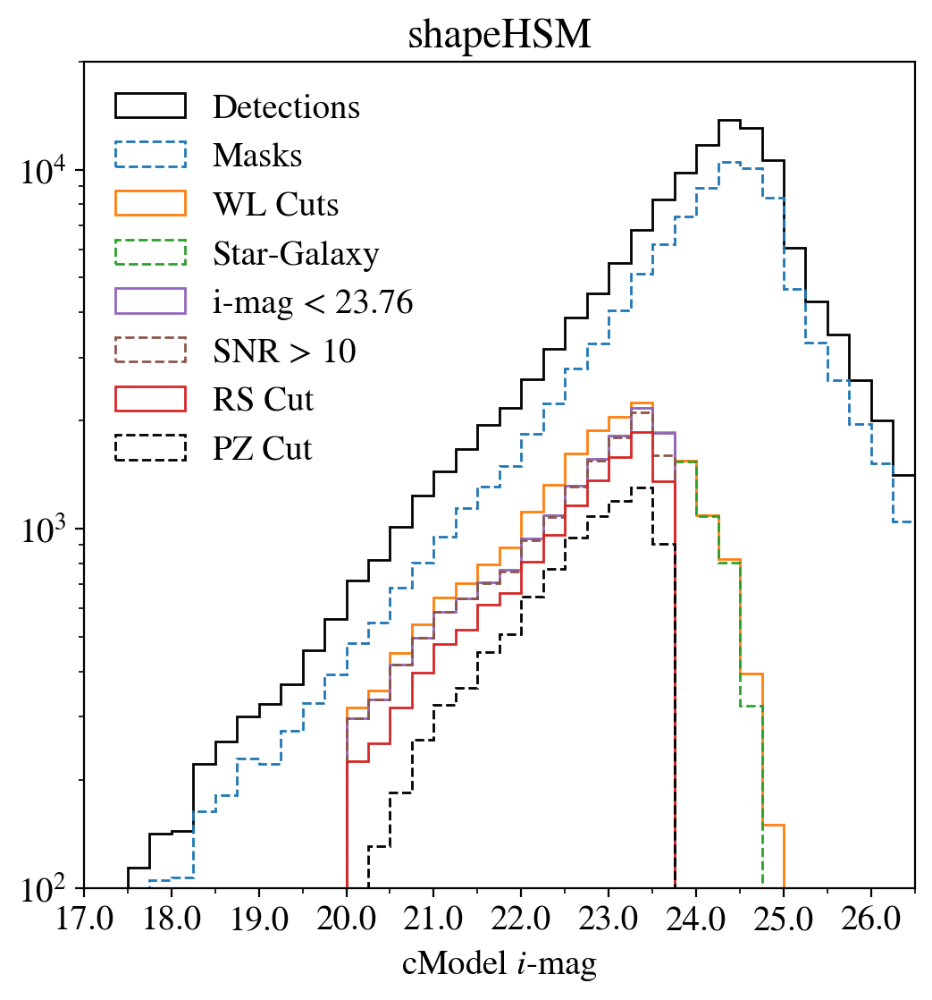

In [184]:
major_xticks = np.arange(17, 27.5, 1)
minor_xticks = np.arange(17.5, 27.5, 1)

cmap = cm.tab10

fig, ax = plt.subplots(1, figsize=(6,6))

# ax.hist(preclean_table['i_cModel_mag'], bins=hist_bins, histtype='step', label="All Detections", color='k')
# ax.hist(clean_table['i_cModel_mag'], bins=hist_bins, histtype='step', label="Good Detections", color=cmap(0), alpha=0.5, ls='--')
# ax.hist(clean_table_masked['i_cModel_mag'], bins=hist_bins, histtype='step', label="Masks", color=cmap(0), alpha=0.5)
# ax.hist(clean_table_psf['i_cModel_mag'], bins=hist_bins, histtype='step', label="PSF Flag", color=cmap(1), alpha=0.5, ls='--')
# ax.hist(clean_table_hsm['i_cModel_mag'], bins=hist_bins, histtype='step', label="HSM Flag", color=cmap(1), alpha=0.5, ls='-')
# ax.hist(wl_table['i_cModel_mag'], bins=hist_bins, histtype='step', label="WL Cuts", color=cmap(1), ls='--')
# ax.hist(wl_table_gal['i_cModel_mag'], bins=hist_bins, histtype='step', label="Star-Galaxy", color=cmap(2))
# ax.hist(imag_table['i_cModel_mag'], bins=hist_bins, histtype='step', label="i-mag < 23.76", color=cmap(4), ls='--')
# ax.hist(SNR_cut10['i_cModel_mag'], bins=hist_bins, histtype='step', label="SNR > 10", color=cmap(5))
# # plt.hist(SNR_cut14['i_cModel_mag'], range=(18, 28), histtype='step', bins=31, label="SNR > 14", color=cmap(4))
# ax.hist(rs_cut['i_cModel_mag'], bins=hist_bins, histtype='step', label="RS Cut", color=cmap(3), ls='--')

# ax.hist(preclean_table['i_cModel_mag'], bins=hist_bins, histtype='step', label="All Detections", color='k', ls='--')
ax.hist(clean_table['i_cModel_mag'], bins=hist_bins, histtype='step', label="Detections", color='k', alpha=1)
ax.hist(clean_table_masked['i_cModel_mag'], bins=hist_bins, histtype='step', label="Masks", color=cmap(0), alpha=1, ls='--')
# ax.hist(clean_table_psf['i_cModel_mag'], bins=hist_bins, histtype='step', label="PSF Flag", color=cmap(1), alpha=0.5)
# ax.hist(clean_table_hsm['i_cModel_mag'], bins=hist_bins, histtype='step', label="HSM Flag", color=cmap(1), alpha=0.5, ls='--')
ax.hist(wl_table['i_cModel_mag'], bins=hist_bins, histtype='step', label="WL Cuts", color=cmap(1))
ax.hist(wl_table_gal['i_cModel_mag'], bins=hist_bins, histtype='step', label="Star-Galaxy", color=cmap(2), ls='--')
ax.hist(imag_table['i_cModel_mag'], bins=hist_bins, histtype='step', label="i-mag < 23.76", color=cmap(4))
ax.hist(SNR_cut10['i_cModel_mag'], bins=hist_bins, histtype='step', label="SNR > 10", color=cmap(5), ls='--')
# plt.hist(SNR_cut14['i_cModel_mag'], range=(18, 28), histtype='step', bins=31, label="SNR > 14", color=cmap(4))
ax.hist(rs_cut['i_cModel_mag'], bins=hist_bins, histtype='step', label="RS Cut", color=cmap(3))
ax.hist(pz_cut['i_cModel_mag'], bins=hist_bins, histtype='step', label="PZ Cut", color='k', ls='--')


ax.set_xticks(major_xticks, major_xticks, minor=False)
ax.set_xticks(minor_xticks, minor=True)
ax.set_ylim(1e2, 2e4)
ax.set_xlim(major_xticks[0], minor_xticks[-1])
ax.set_xlabel('cModel $i$-mag')
ax.legend(frameon=False, ncol=1, loc='upper left', columnspacing=1)
ax.semilogy()
ax.set_title("shapeHSM")
plt.savefig('figs/sv38_distrib.pdf', format='pdf', bbox_inches='tight')

In [307]:
clean_ecdfs, preclean_ecdfs = load_pz_photomdata(tracts=ecdfs_tracts, columns=ecdfs_object_req_cols)


/opt/lsst/software/stack/conda/envs/lsst-scipipe-10.1.0/lib/python3.12/site-packages/astropy/units/function/logarithmic.py:67: RuntimeWarning: divide by zero encountered in log10
  return dex.to(self._function_unit, np.log10(x))
/opt/lsst/software/stack/conda/envs/lsst-scipipe-10.1.0/lib/python3.12/site-packages/astropy/units/function/logarithmic.py:67: RuntimeWarning: invalid value encountered in log10
  return dex.to(self._function_unit, np.log10(x))


In [308]:
clean_ecdfs = apply_redsequence_noisy(clean_ecdfs, sigma=1, mag_lim=23.76)

/tmp/ipykernel_149/697460470.py:42: RuntimeWarning: invalid value encountered in log10
  gi_neg = -2.5*np.log10((table['g_gaap1p0Flux'] - sigma*table['g_gaap1p0FluxErr'])/(table['i_gaap1p0Flux'] - sigma*table['i_gaap1p0FluxErr']))
/tmp/ipykernel_149/697460470.py:43: RuntimeWarning: invalid value encountered in log10
  ri_neg = -2.5*np.log10((table['r_gaap1p0Flux'] - sigma*table['r_gaap1p0FluxErr'])/(table['i_gaap1p0Flux'] - sigma*table['i_gaap1p0FluxErr']))
/tmp/ipykernel_149/697460470.py:44: RuntimeWarning: invalid value encountered in log10
  gr_neg = -2.5*np.log10((table['g_gaap1p0Flux'] - sigma*table['g_gaap1p0FluxErr'])/(table['r_gaap1p0Flux'] - sigma*table['r_gaap1p0FluxErr']))
/tmp/ipykernel_149/697460470.py:46: RuntimeWarning: invalid value encountered in log10
  gi_pos = -2.5*np.log10((table['g_gaap1p0Flux'] + sigma*table['g_gaap1p0FluxErr'])/(table['i_gaap1p0Flux'] + sigma*table['i_gaap1p0FluxErr']))
/tmp/ipykernel_149/697460470.py:47: RuntimeWarning: invalid value encountere

In [340]:
ec_mask = ecdfs_mask(clean_ecdfs)
clean_ecdfs_masked = clean_ecdfs[ec_mask]

In [341]:
clean_ecdfs_psf = clean_ecdfs_masked[~clean_ecdfs_masked['i_iPSF_flag']]
clean_ecdfs_hsm = clean_ecdfs_psf[~clean_ecdfs_psf['i_hsmShapeRegauss_flag']]

In [353]:
wl_filt = get_wlfilt(clean_ecdfs_hsm, mag_lim=28, bright_lim=20, SNR=0, apply_sep=False, apply_extend=False)
ecdfs_wl_table = clean_ecdfs_hsm[wl_filt]

After WL cuts: 73100


In [354]:
clean_ecdfs_extend = ecdfs_wl_table[ecdfs_wl_table['refExtendedness'] == 1]

In [355]:
ecdfs_imag_table = clean_ecdfs_extend[clean_ecdfs_extend['i_cModel_mag'] < 23.76]
Nimag_table = len(ecdfs_imag_table)

In [356]:
ecdfs_SNR_cut14 = ecdfs_imag_table[ecdfs_imag_table['i_cModelFlux']/ecdfs_imag_table['i_cModelFluxErr'] > 14]
ecdfs_SNR_cut10 = ecdfs_imag_table[ecdfs_imag_table['i_cModelFlux']/ecdfs_imag_table['i_cModelFluxErr'] > 10]
Nsnr = len(ecdfs_SNR_cut10)
print((Nimag_table-Nsnr)/Nimag_table)

0.004463696151712844


In [357]:
ecdfs_rs_cut = ecdfs_SNR_cut10[~ecdfs_SNR_cut10['all_redseq']]

[]

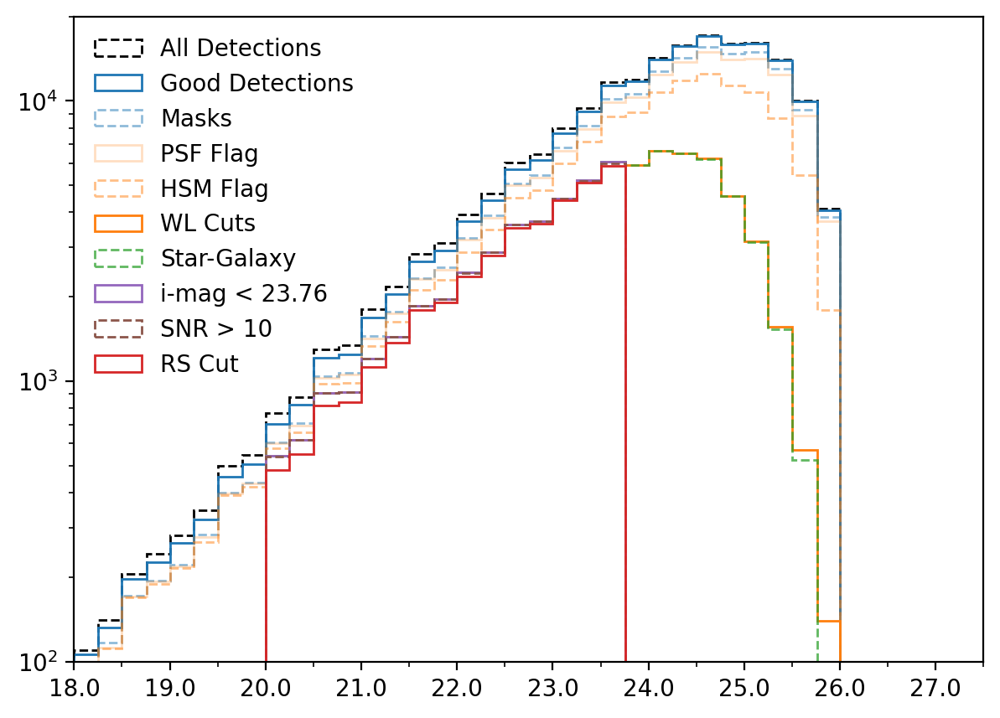

In [381]:
fig, ax = plt.subplots(1, figsize=(7,5))

major_xticks = np.arange(18, 28.5, 1)
minor_xticks = np.arange(18.5, 28.5, 1)

cmap = cm.tab10

ax.hist(preclean_ecdfs['i_cModel_mag'], bins=hist_bins, histtype='step', label="All Detections", color='k', ls='--')
ax.hist(clean_ecdfs['i_cModel_mag'], bins=hist_bins, histtype='step', label="Good Detections", color=cmap(0))
ax.hist(clean_ecdfs_masked['i_cModel_mag'], bins=hist_bins, histtype='step', label="Masks", color=cmap(0), alpha=0.5, ls='--')
ax.hist(clean_ecdfs_psf['i_cModel_mag'], bins=hist_bins, histtype='step', label="PSF Flag", color=cmap(1), alpha=0.25, ls='-')
ax.hist(clean_ecdfs_hsm['i_cModel_mag'], bins=hist_bins, histtype='step', label="HSM Flag", color=cmap(1), alpha=0.5, ls='--')
ax.hist(ecdfs_wl_table['i_cModel_mag'], bins=hist_bins, histtype='step', label="WL Cuts", color=cmap(1))
ax.hist(clean_ecdfs_extend['i_cModel_mag'], bins=hist_bins, histtype='step', label="Star-Galaxy", color=cmap(2), alpha=0.75, ls='--')
ax.hist(ecdfs_imag_table['i_cModel_mag'], bins=hist_bins, histtype='step', label="i-mag < 23.76", color=cmap(4))
ax.hist(ecdfs_SNR_cut10['i_cModel_mag'], bins=hist_bins, histtype='step', label="SNR > 10", color=cmap(5), ls='--')
# plt.hist(SNR_cut14['i_cModel_mag'], range=(18, 28), histtype='step', bins=31, label="SNR > 14", color=cmap(4))
ax.hist(ecdfs_rs_cut['i_cModel_mag'], bins=hist_bins, histtype='step', label="RS Cut", color=cmap(3))

ax.set_xticks(major_xticks, major_xticks, minor=False)
ax.set_xticks(minor_xticks, minor=True)
ax.set_ylim(1e2, 2e4)
ax.set_xlim(major_xticks[0], minor_xticks[-1])
ax.legend(frameon=False, ncol=1, loc='upper left', columnspacing=1)
ax.semilogy()
# ax.set_title("ECDFS")

#### Playground

In [145]:
hsm_table = Table.read('/sdf/data/rubin/shared/cluster_commissioning/catalogs/HSM_noisy_allpz.fits')

In [150]:
# # Get point estimates for the entire field (169034 objects)
pz_ests = pd.read_parquet(pz_sv38_point)
pz_ests = Table.from_pandas(pz_ests)

In [151]:
# We could load this in via butler we did save this earlier :)
# This is the cleaned catalog that removed entries if any of the measurement algorithms failed.
# dp1_catalog = Table.read('cluster_data/abell360_PRECUTS_DP1_new.fits', format="fits")
# dp1_catalog, _ = load_pz_photomdata(ddir='/global/cfs/cdirs/lsst/groups/PZ/DP1/data/dp1_v29.0.0/', suffix='parquet')
dp1_catalog, _ = load_pz_photomdata(clean_fn=preclean_filt)
# dp1_catalog = Table.read('cluster_data/abell360_PRECUTS_DP1_gaap_cModel.fits', format="fits")

/opt/lsst/software/stack/conda/envs/lsst-scipipe-11.0.0/lib/python3.12/site-packages/astropy/units/function/logarithmic.py:67: RuntimeWarning: divide by zero encountered in log10
  return dex.to(self._function_unit, np.log10(x))
/opt/lsst/software/stack/conda/envs/lsst-scipipe-11.0.0/lib/python3.12/site-packages/astropy/units/function/logarithmic.py:67: RuntimeWarning: invalid value encountered in log10
  return dex.to(self._function_unit, np.log10(x))


In [152]:
pz_table = join(dp1_catalog, pz_ests, keys='objectId')

In [153]:
# The P(z) PDFs are stored in a qp file which we can access via the get_pdfs function
# This contains the PDFs for all objects in the field which would be too much data to
# load in this notebook. We only want the PDFs for the objects that have passed our
# basic quality cuts.

clean_pz_ids = hsm_table['objectId']
all_pz_ids = pz_ests['objectId']
hsm_pz_filt = np.isin(all_pz_ids, clean_pz_ids)
# big_pz_filt = [k in clean_pz_ids for k in pz_ests['objectId']]


In [199]:
xs = np.arange(0, 3, 0.05)
# xs = np.concatenate((np.arange(0, 1, 0.02), np.arange(1, 3, 0.05)))

In [200]:
plot_algs = ['fzboost', 'knn', 'cmnn', 'dnf', 'tpz', 'gpz', 'bpz', 'lephare']
quality_pdfs = []

for alg in plot_algs:
    print(f"On {alg} we have {np.sum(hsm_pz_filt)}")
    _, pdfs, _ = get_pdfs(alg, hsm_pz_filt, pz_dir=pz_sv38_pdf_dir, xs=xs)
    c = gc.collect()
    # pdf, _, xs = get_pdfs(alg, big_pz_filt)
    quality_pdfs.append(pdfs)

On fzboost we have 11085
On knn we have 11085
On cmnn we have 11085
On dnf we have 11085
On tpz we have 11085
On gpz we have 11085
On bpz we have 11085
On lephare we have 11085


In [209]:
# print("Total entries: ", len(quality_pdfs[0]))

test_ints = np.arange(1, 1.1, .01)
n_issues = np.zeros((8, 11))

for j, ti in enumerate(test_ints):
    for i, alg in enumerate(plot_algs):
        Ngreater = np.sum(integrate.trapezoid(quality_pdfs[i], xs) > ti)
        n_issues[i,j] = Ngreater
        # print(f'{alg} has {Ngreater} entries with int. P(z) > 1')

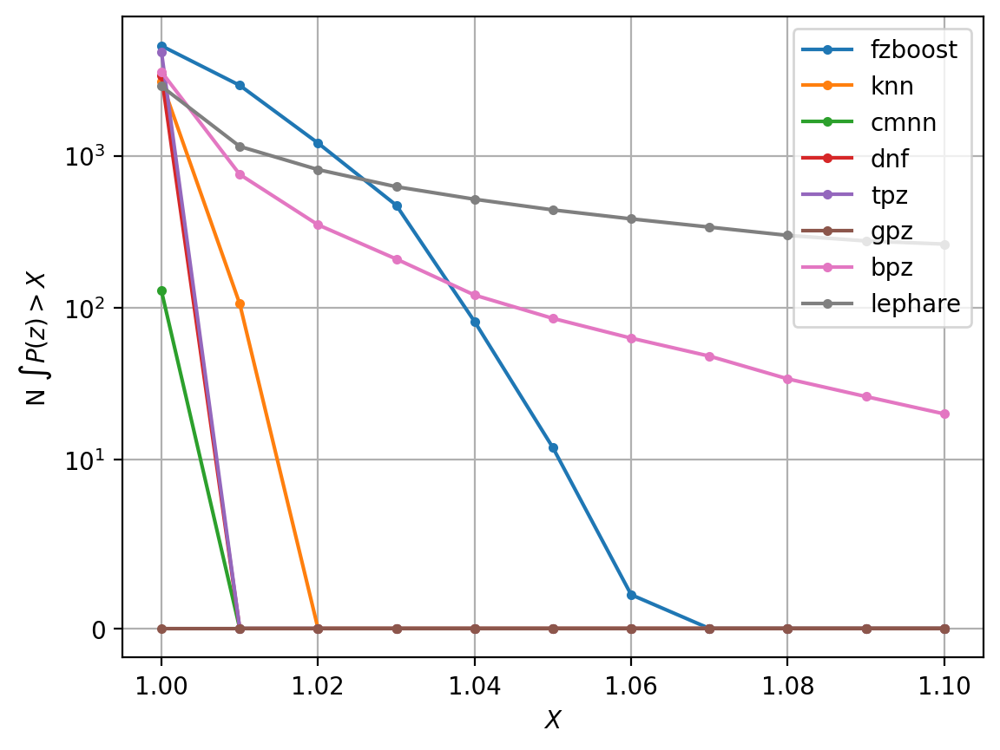

In [223]:


for i, alg in enumerate(plot_algs):
    plt.plot(test_ints, n_issues[i,:], '.-', label=alg)
# plt.ylim(-1, 100)
plt.yscale('symlog', linthresh=10)
plt.grid()
plt.ylabel(r"N $\int P(z) > X$")
plt.xlabel(r"$X$")
plt.legend()

In [201]:
# for i, alg in enumerate(plot_algs):
#     hsm_table[f'{alg}_pz'] = quality_pdfs[i]

# hsm_table.write('cluster_data/HSM_noisy_allpz_distrib.pq', format='parquet')

In [193]:
# kale = Table.read('cluster_data/HSM_noisy_allpz_distrib.pq', format='parquet')

In [226]:
kale = Table.read('/sdf/data/rubin/shared/cluster_commissioning/catalogs/Anacal_allpz.fits')

ra,dec,flux,dflux_dg1,dflux_dg2,dflux_dj1,dflux_dj2,t,dt_dg1,dt_dg2,dt_dj1,dt_dj2,a1,da1_dg1,da1_dg2,da1_dj1,da1_dj2,a2,da2_dg1,da2_dg2,da2_dj1,da2_dj2,e1,de1_dg1,de1_dg2,de1_dj1,de1_dj2,e2,de2_dg1,de2_dg2,de2_dj1,de2_dj2,x1,dx1_dg1,dx1_dg2,dx1_dj1,dx1_dj2,x2,dx2_dg1,dx2_dg2,dx2_dj1,dx2_dj2,fluxap2,dfluxap2_dg1,dfluxap2_dg2,dfluxap2_dj1,dfluxap2_dj2,wdet,dwdet_dg1,dwdet_dg2,dwdet_dj1,dwdet_dj2,wsel,dwsel_dg1,dwsel_dg2,dwsel_dj1,dwsel_dj2,mask_value,is_peak,is_primary,fpfs_e1,fpfs_de1_dg1,fpfs_de1_dg2,fpfs_de1_dj1,fpfs_de1_dj2,fpfs_e2,fpfs_de2_dg1,fpfs_de2_dg2,fpfs_de2_dj1,fpfs_de2_dj2,fpfs_m0,fpfs_dm0_dg1,fpfs_dm0_dg2,fpfs_dm0_dj1,fpfs_dm0_dj2,fpfs_m2,fpfs_dm2_dg1,fpfs_dm2_dg2,fpfs_dm2_dj1,fpfs_dm2_dj2,peakv,dpeakv_dg1,dpeakv_dg2,dpeakv_dj1,dpeakv_dj2,bkg,dbkg_dg1,dbkg_dg2,dbkg_dj1,dbkg_dj2,x1_det,x2_det,block_id,g_flux,g_dflux_dg1,g_dflux_dg2,g_fpfs1_e1,g_fpfs1_de1_dg1,g_fpfs1_e2,g_fpfs1_de2_dg2,g_fpfs1_q1,g_fpfs1_dq1_dg1,g_fpfs1_q2,g_fpfs1_dq2_dg2,g_fpfs1_m00,g_fpfs1_dm00_dg1,g_fpfs1_dm00_dg2,g_fpfs1_m20,g_fpfs1_dm20_dg1,g_fpfs1_dm20_dg2,g_fpfs1_m22c,g_fpfs1_dm22c_dg1,g_fpfs1_m22s,g_fpfs1_dm22s_dg2,r_flux,r_dflux_dg1,r_dflux_dg2,r_fpfs1_e1,r_fpfs1_de1_dg1,r_fpfs1_e2,r_fpfs1_de2_dg2,r_fpfs1_q1,r_fpfs1_dq1_dg1,r_fpfs1_q2,r_fpfs1_dq2_dg2,r_fpfs1_m00,r_fpfs1_dm00_dg1,r_fpfs1_dm00_dg2,r_fpfs1_m20,r_fpfs1_dm20_dg1,r_fpfs1_dm20_dg2,r_fpfs1_m22c,r_fpfs1_dm22c_dg1,r_fpfs1_m22s,r_fpfs1_dm22s_dg2,i_flux,i_dflux_dg1,i_dflux_dg2,i_fpfs1_e1,i_fpfs1_de1_dg1,i_fpfs1_e2,i_fpfs1_de2_dg2,i_fpfs1_q1,i_fpfs1_dq1_dg1,i_fpfs1_q2,i_fpfs1_dq2_dg2,i_fpfs1_m00,i_fpfs1_dm00_dg1,i_fpfs1_dm00_dg2,i_fpfs1_m20,i_fpfs1_dm20_dg1,i_fpfs1_dm20_dg2,i_fpfs1_m22c,i_fpfs1_dm22c_dg1,i_fpfs1_m22s,i_fpfs1_dm22s_dg2,z_flux,z_dflux_dg1,z_dflux_dg2,z_fpfs1_e1,z_fpfs1_de1_dg1,z_fpfs1_e2,z_fpfs1_de2_dg2,z_fpfs1_q1,z_fpfs1_dq1_dg1,z_fpfs1_q2,z_fpfs1_dq2_dg2,z_fpfs1_m00,z_fpfs1_dm00_dg1,z_fpfs1_dm00_dg2,z_fpfs1_m20,z_fpfs1_dm20_dg1,z_fpfs1_dm20_dg2,z_fpfs1_m22c,z_fpfs1_dm22c_dg1,z_fpfs1_m22s,z_fpfs1_dm22s_dg2,mag,g_mag,r_mag,i_mag,z_mag,res,correct_e1,correct_e2,knn_z_median,knn_z_mode,knn_z_err95_low,knn_z_err95_high,knn_z_err68_low,knn_z_err68_high,tpz_z_median,tpz_z_mean,tpz_z_mode,tpz_z_err95_low,tpz_z_err95_high,tpz_z_err68_low,tpz_z_err68_high,cmnn_z_median,cmnn_z_mean,cmnn_z_mode,cmnn_z_err95_low,cmnn_z_err95_high,cmnn_z_err68_low,cmnn_z_err68_high,gpz_z_median,gpz_z_mean,gpz_z_mode,gpz_z_err95_low,gpz_z_err95_high,gpz_z_err68_low,gpz_z_err68_high,bpz_z_median,bpz_z_mean,bpz_z_mode,bpz_z_err95_low,bpz_z_err95_high,bpz_z_err68_low,bpz_z_err68_high,dnf_z_median,dnf_z_mean,dnf_z_mode,dnf_z_err95_low,dnf_z_err95_high,dnf_z_err68_low,dnf_z_err68_high,fzboost_z_median,fzboost_z_mean,fzboost_z_mode,fzboost_z_err95_low,fzboost_z_err95_high,fzboost_z_err68_low,fzboost_z_err68_high,lephare_z_median,lephare_z_mean,lephare_z_mode,lephare_z_err95_low,lephare_z_err95_high,lephare_z_err68_low,lephare_z_err68_high,cal_e1,cal_e2
float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int32,bool,bool,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float

### RS Number Count Data

In [100]:
# clean_table2 = preclean_table[preclean_filt(preclean_table)]
clean_table = preclean_table[preclean_flux_filt(preclean_table)]

In [102]:
# clean_table = apply_redsequence_noisy(clean_table, mag_lim=23.76, sigma=1)
delta = 0.05
clean_table = apply_redsequence_noisy(clean_table, sigma=1, mag_lim=23.76, bright_lim=10, delta=delta)

In [104]:
clean_mask = get_masks(clean_table)
clean_table_masked = clean_table[clean_mask]

In [107]:
clean_table_psf = clean_table_masked[~clean_table_masked['i_iPSF_flag']]
clean_table_hsm = clean_table_psf[~clean_table_psf['i_hsmShapeRegauss_flag']]
# clean_table_extend = clean_table[clean_table['refExtendedness'] == 1]

In [111]:
# wl_filt = get_wlfilt(clean_table_hsm, mag_lim=28, bright_lim=20, SNR=0, apply_extend=False)
wl_filt = get_wlfilt(clean_table_hsm, mag_lim=23.76, bright_lim=10, SNR=10, apply_extend=True)
wl_table = clean_table_hsm[wl_filt]

After WL cuts: 15774


In [129]:
wl_table.meta = {}
wl_table.write('/sdf/data/rubin/shared/cluster_commissioning/catalogs/HSM_cluster_luminosity.fits', format='fits', overwrite=True)

In [121]:
rs_table =  wl_table[wl_table['all_redseq']]

### Inner Bin Visual Check

In [36]:
spherePoint = lsst.geom.SpherePoint(ra_bcg*lsst.geom.degrees, dec_bcg*lsst.geom.degrees)
t_skymap = obs_butler.get('skyMap', skymap='lsst_cells_v1')

tract = t_skymap.findTract(spherePoint)
patch = tract.findPatch(spherePoint)
tract_id = tract.tract_id
patch_id = patch.getSequentialIndex()
skymap = 'lsst_cells_v1'
wcs = tract.getWcs()
print(f"Tract: {tract_id}, Patch: {patch_id}")



Tract: 10463, Patch: 61


In [37]:
deg_inner = ((0.3) / (Da(0.22) * np.pi/180))
deg_outer = ((0.7) / (Da(0.22) * np.pi/180))

npix_inner = deg_inner / arcsec * 5
npix_outer = deg_outer / arcsec * 5

In [38]:
box_size_deg = 1.1 * deg_outer

In [39]:
ra1 = ra_bcg + box_size_deg / np.cos(np.radians(dec_bcg))
ra2 = ra_bcg - box_size_deg / np.cos(np.radians(dec_bcg))
dec1 = dec_bcg - box_size_deg
dec2 = dec_bcg + box_size_deg
print('ra1 = %8.4f,  ra2 = %8.4f,  delta RA = %6.3f' %
      (ra1, ra2, np.abs(ra2-ra1)))
print('dec1 = %8.4f, dec2 = %8.4f, delta Dec = %6.3f' %
      (dec1, dec2, np.abs(dec2-dec1)))
corners = np.asarray([[ra1, dec1], [ra2, dec1],
                      [ra2, dec2], [ra1, dec2]],
                     dtype='float')


ra1 =  37.9256,  ra2 =  37.8044,  delta RA =  0.121
dec1 =   6.9220, dec2 =   7.0424, delta Dec =  0.120


In [40]:


center = geom.SpherePoint(ra_bcg, dec_bcg, geom.degrees)

radec = [geom.SpherePoint(ra2, dec1, geom.degrees),
         geom.SpherePoint(ra2, dec2, geom.degrees),
         geom.SpherePoint(ra1, dec1, geom.degrees),
         geom.SpherePoint(ra1, dec2, geom.degrees)]

tracts_and_patches = t_skymap.findTractPatchList(radec)

tp_dict = {}
for tract_num in np.arange(len(tracts_and_patches)):
    tract_info = tracts_and_patches[tract_num][0]
    tract_idx = tract_info.getId()
    # All the patches around the cluster
    patches = []
    for i,patch in enumerate(tracts_and_patches[tract_num][1]):
        patch_info = tracts_and_patches[tract_num][1][i]
        patch_idx = patch_info.sequential_index
        patches.append(patch_idx)
    tp_dict.update({tract_idx:patches})
tp_dict



{10463: [61, 71, 62, 72]}

In [41]:
anchor_tract = 10463
anchor_patch = 61

In [42]:
temp = []
for tract in tp_dict.keys():
     for patch in tp_dict[tract]:
        if (tract != anchor_tract) | (patch != anchor_patch):
            temp.append([tract, patch])
add_tracts_and_patches = np.asarray(temp, dtype='int')
#del temp

print('add these to the anchor patch: ')
print(add_tracts_and_patches)



add these to the anchor patch: 
[[10463    71]
 [10463    62]
 [10463    72]]


In [45]:
filter_arr = ['g', 'r', 'i']
coadds = []
for use_filter in filter_arr:
    anchor_dataId = {'tract': anchor_tract, 'patch': anchor_patch,
                 'band': use_filter}
    anchor_image = obs_butler.get('deep_coadd', dataId=anchor_dataId)
    anchor_wcs = anchor_image.getWcs() 
    all_dataIds = [anchor_dataId]
    all_images = [anchor_image]
    all_tracts = [anchor_tract]
    
    for i in range(len(add_tracts_and_patches)):
        temp_tract = add_tracts_and_patches[i][0]
        temp_patch = add_tracts_and_patches[i][1]
        temp_dataId = {'tract': temp_tract, 'patch': temp_patch,
                       'band': use_filter}
        temp_image = obs_butler.get('deep_coadd', dataId=temp_dataId)
    
        all_images.append(temp_image)
        all_dataIds.append(temp_dataId)
        all_tracts.append(temp_tract)
    
    del temp_tract, temp_patch, temp_dataId, temp_image

    getTemplateTask = GetTemplateTask()
    crval = geom.SpherePoint(ra_bcg, dec_bcg, geom.degrees)

    crpix = box_size_deg * 3600 / 0.2
    crpix1 = crpix
    crpix2 = crpix
    crpix = geom.Point2D(crpix1, crpix2)
    
    x = anchor_image.getWcs().getFitsMetadata()
    cdMatrix = [x['CD1_1'], x['CD1_2']], [x['CD2_1'], x['CD2_2']]
    
    projection = 'TAN'
    newWCS = makeSkyWcs(crpix, crval, cdMatrix, projection)
 
    corner_SE_deg = geom.SpherePoint(corners[0][0], corners[0][1], geom.degrees)
    corner_NW_deg = geom.SpherePoint(corners[2][0], corners[2][1], geom.degrees)
    corner_SE_pix = newWCS.skyToPixel(corner_SE_deg)
    corner_NW_pix = newWCS.skyToPixel(corner_NW_deg)
    
    xmin = int(np.floor(corner_SE_pix[0]))
    ymin = int(np.floor(corner_SE_pix[1]))
    xmax = int(np.floor(corner_NW_pix[0]))
    ymax = int(np.floor(corner_NW_pix[1]))
    
    newimg_shape = Image(geom.Box2I(minimum=geom.Point2I(x=xmin, y=ymin),
                                    maximum=geom.Point2I(x=xmax, y=ymax)),
                         dtype=np.float32)
    newimage_bbox = newimg_shape.getBBox()

    dI = all_dataIds[0]
    dataset_refs = list(obs_butler.query_datasets('deep_coadd', data_id=dI))
    dataset_refs = set(dataset_refs)
    
    for dI in all_dataIds[1:]:
        dr = list(obs_butler.query_datasets('deep_coadd', data_id=dI))
        dataset_refs = dataset_refs.union(set(dr))
    
    coadd_deferred_dataset_handle = [obs_butler.getDeferred(dr) for dr in dataset_refs]
    sky_map = obs_butler.get("skyMap")
    inputs = {"coaddExposures": coadd_deferred_dataset_handle,
              "bbox": newimage_bbox,
              "skyMap": sky_map,
              "wcs": newWCS, }
    print(f"{use_filter}-band: collecting the patches/tracts that overlap the desired bounding box")
    
    results = getTemplateTask.getExposures(coadd_deferred_dataset_handle,
                                           newimage_bbox, sky_map, newWCS)
    newimage = getTemplateTask.run(coaddExposureHandles=results.coaddExposures, 
                                   bbox=newimage_bbox,
                                   wcs=newWCS, dataIds=results.dataIds,
                                   physical_filter=use_filter)
    coadds.append(newimage.template)

g-band: collecting the patches/tracts that overlap the desired bounding box


r-band: collecting the patches/tracts that overlap the desired bounding box


i-band: collecting the patches/tracts that overlap the desired bounding box


In [46]:
coadds_exp = MultibandExposure.fromExposures(['g', 'r', 'i'], coadds)

In [55]:
outdir

'/home/a/adari/u/clusters/cluster_data'

In [47]:
sv38_table = Table.read(f'{outdir}/abell360_POSTCUTS_allnoisy_masked_DP1.fits')
print(len(sv38_table))
sky_mpc = (Da(0.22) * np.pi/180 * sv38_table['sep'])
inner_sv38 = sv38_table[(sky_mpc > 0.3) * (sky_mpc < 0.7)]

12595


In [253]:
# anacal_table = Table.read('cluster_data/new_anacal_5snr.fits')
# anacal_table = Table.read('cluster_data/masked_anacal.fits')
anacal_table = Table.read('cluster_data/anacal_table_v2_bright.fits')

sky_mpc = (Da(0.22) * np.pi/180 * anacal_table['sep'])
inner_ana = anacal_table[(sky_mpc > 0.3) * (sky_mpc < 0.7)]

In [52]:

mdet_table = pd.read_pickle('/sdf/group/rubin/shared/cluster_commissioning/metadetect/md-wl-point-mode_v2.pkl')
mdet_table = Table.from_pandas(mdet_table)

inner_mdet = mdet_table[(mdet_table['mpc_sep'] > 0.3) * (mdet_table['mpc_sep'] < 0.7)]

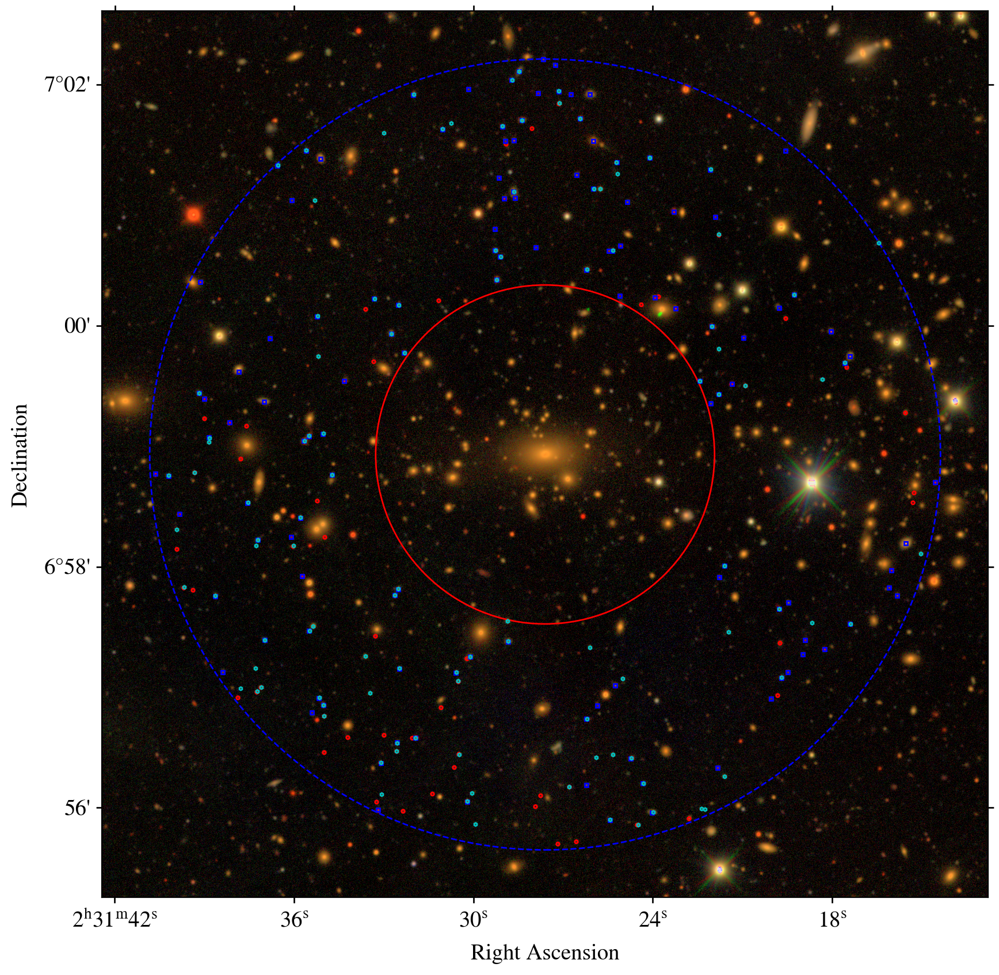

In [56]:
new_wcs = WCS(coadds[0].getWcs().getFitsMetadata())

fig, ax = plt.subplots(figsize=(10,10), nrows=1, ncols=1, 
                       subplot_kw={'projection': new_wcs})

rgb_original = createRGB(coadds_exp.image, bgr=['g', 'r', 'i'], stretch=60, Q=10)#,stretch=0.01, Q=100, scale=[1, 1, 1])

rgb_extent = (newimage.template.getBBox().beginX, newimage.template.getBBox().endX,
              newimage.template.getBBox().beginY, newimage.template.getBBox().endY)
center_pixel = new_wcs.world_to_pixel_values([[ra_bcg, dec_bcg]])[0]


ax.imshow(rgb_original, origin='lower', extent=rgb_extent)
# ax.imshow(rgb_original, origin='lower')
inner_circle = Circle(center_pixel, radius=npix_inner, fill=False, color='r', ls='-')
outer_circle = Circle(center_pixel, radius=npix_outer, fill=False, color='b', ls='--')

sv_pixs = new_wcs.world_to_pixel_values(inner_sv38['coord_ra'], inner_sv38['coord_dec'])
ax.plot(sv_pixs[0], sv_pixs[1], marker='o',
        fillstyle='none', color='r', linestyle='', markersize=2)

ana_pixs = new_wcs.world_to_pixel_values(inner_ana['ra'], inner_ana['dec'])
ax.plot(ana_pixs[0], ana_pixs[1], marker='s',
        fillstyle='none', color='b', linestyle='', markersize=2) 

# edge_colors = [cm.bwr(1.0) if k <= 23.5 else cm.bwr(0.0) for k in inner_ana['i_mag']] #red if bright, blue if faint
# edge_colors = [cm.bwr(0.0) if k else cm.bwr(1.0) for k in inner_ana['ben_mask']] #red if removed, blue if kept
# ax.scatter(ana_pixs[0], ana_pixs[1], marker='o', edgecolor=edge_colors,
#         facecolor='none', s=7, alpha=1)
# for i in range(len(ana_pixs[0])):
#     ax.annotate(i, (ana_pixs[0][i], ana_pixs[1][i]),color='white', fontsize=5)

mdet_pixs = new_wcs.world_to_pixel_values(inner_mdet['ra'], inner_mdet['dec'])
ax.plot(mdet_pixs[0], mdet_pixs[1], marker='h',
        fillstyle='none', color='c', linestyle='', markersize=2)


ax.add_artist(inner_circle)
ax.add_artist(outer_circle)

# ax.set_xlim([newimage.template.getBBox().beginX, newimage.template.getBBox().endX])
# ax.set_ylim([newimage.template.getBBox().beginY, newimage.template.getBBox().endY])
ax.set_xlabel("Right Ascension")
ax.set_ylabel("Declination")



# ax.scatter(inner_sv38['x'], inner_sv38['y'], s=4, marker='x')

In [283]:
def cross_match_frac(hsm, ana, mdet, match_pixels=1):
    hsm_coords = np.vstack((hsm['coord_ra'], hsm['coord_dec'])).T
    ana_coords = np.vstack((ana['ra'], ana['dec'])).T
    mdet_coords = np.vstack((mdet['ra'], mdet['dec'])).T

    N_hsm = len(hsm)
    N_ana = len(ana)
    N_mdet = len(mdet)
    
    hsm_tree = KDTree(hsm_coords)
    ana_tree = KDTree(ana_coords)
    mdet_tree = KDTree(mdet_coords)

    # Sources within match_radius
    match_radius = match_pixels * 0.2 * arcsec
    hsm_mdet = hsm_tree.query_ball_point(mdet_coords, r=match_radius, return_length=True) # HSM sources within 1 pixel of a mdet source
    hsm_ana = hsm_tree.query_ball_point(ana_coords, r=match_radius, return_length=True) # HSM sources within 1 pixel of a anacal source

    ana_mdet = ana_tree.query_ball_point(mdet_coords, r=match_radius, return_length=True)
    ana_hsm = ana_tree.query_ball_point(hsm_coords, r=match_radius, return_length=True)

    mdet_ana = mdet_tree.query_ball_point(ana_coords, r=match_radius, return_length=True)
    mdet_hsm = mdet_tree.query_ball_point(hsm_coords, r=match_radius, return_length=True)

    Nhm = np.sum(hsm_mdet)
    Nha = np.sum(hsm_ana)

    Nam = np.sum(ana_mdet)
    Nah = np.sum(ana_hsm)

    Nmh = np.sum(mdet_hsm)
    Nma = np.sum(mdet_ana)

    hsm_mdet_frac = Nhm/N_mdet
    hsm_ana_frac = Nha/N_ana
    
    ana_mdet_frac = Nam/N_mdet
    ana_hsm_frac = Nah/N_hsm

    mdet_hsm_frac = Nmh/N_hsm
    mdet_ana_frac = Nma/N_ana

    fractions = [hsm_mdet_frac, hsm_ana_frac, ana_mdet_frac, ana_hsm_frac, mdet_hsm_frac, mdet_ana_frac]
    Nsamples = [Nhm, Nha, Nam, Nah, Nmh, Nma]
    cross_match_table = np.array([[N_ana, Nha, Nma],
                                  [Nah, N_hsm, Nmh],
                                  [Nam, Nhm, N_mdet]])

    print(f"{N_hsm=}, {N_ana=}, {N_mdet=}")
    print(f"{Nhm=}, {Nha=}, {Nam=}, {Nah=}, {Nmh=}, {Nma=}")
    print(fractions)

    return fractions, Nsamples, mdet_tree, ana_tree, hsm_tree, mdet_coords, ana_coords, hsm_coords, cross_match_table
    

In [58]:
_, _, mt, at, ht, mc, ac, hc = cross_match_frac(inner_sv38, inner_ana, inner_mdet, 3)

N_hsm=111, N_ana=126, N_mdet=109
Nhm=np.int64(51), Nha=np.int64(59), Nam=np.int64(64), Nah=np.int64(59), Nmh=np.int64(51), Nma=np.int64(64)
[np.float64(0.46788990825688076), np.float64(0.46825396825396826), np.float64(0.5871559633027523), np.float64(0.5315315315315315), np.float64(0.4594594594594595), np.float64(0.5079365079365079)]


In [71]:
ma_overlapcoords = ac[mt.query_ball_point(ac, r=0.5*arcsec, return_length=True).astype(bool)]

In [74]:
print(f"There are {ht.query_ball_point(ma_overlapcoords, r=0.5*arcsec, return_length=True).sum()} objects between all three catalogs")

There are 37 objects between all three catalogs


In [78]:

am_overlap = ac[mt.query_ball_point(ac, r=0.5*arcsec, return_length=True).astype(bool)]
hm_overlap = hc[mt.query_ball_point(hc, r=0.5*arcsec, return_length=True).astype(bool)]
ah_overlap = ac[ht.query_ball_point(ac, r=0.5*arcsec, return_length=True).astype(bool)]

In [79]:
ha_overlap = hc[at.query_ball_point(hc, r=0.5*arcsec, return_length=True).astype(bool)]

In [90]:
anacal_solo = ac[(~(ht.query_ball_point(ac, r=0.5*arcsec, return_length=True).astype(bool))) & (~(mt.query_ball_point(ac, r=0.5*arcsec, return_length=True).astype(bool)))]

In [94]:
a_solo = ac[(~(ht.query_ball_point(ac, r=0.5*arcsec, return_length=True).astype(bool))) & (~(mt.query_ball_point(ac, r=0.5*arcsec, return_length=True).astype(bool)))]
m_solo = mc[(~(ht.query_ball_point(mc, r=0.5*arcsec, return_length=True).astype(bool))) & (~(at.query_ball_point(mc, r=0.5*arcsec, return_length=True).astype(bool)))]
h_solo = hc[(~(at.query_ball_point(hc, r=0.5*arcsec, return_length=True).astype(bool))) & (~(mt.query_ball_point(hc, r=0.5*arcsec, return_length=True).astype(bool)))]

am_overlap = ac[mt.query_ball_point(ac, r=0.5*arcsec, return_length=True).astype(bool)]
hm_overlap = hc[mt.query_ball_point(hc, r=0.5*arcsec, return_length=True).astype(bool)]
ah_overlap = ac[ht.query_ball_point(ac, r=0.5*arcsec, return_length=True).astype(bool)]


amh_overlap = am_overlap[ht.query_ball_point(am_overlap, r=0.5*arcsec, return_length=True).astype(bool)]



In [102]:

amh_overlap.shape

(37, 2)

In [98]:
a_solo.shape[0] + am_overlap.shape[0] + ah_overlap.shape[0] - amh_overlap.shape[0]

126

In [112]:
from astropy.visualization import LuptonAsinhStretch

In [116]:

kale = LuptonAsinhStretch(stretch=5, Q=10)

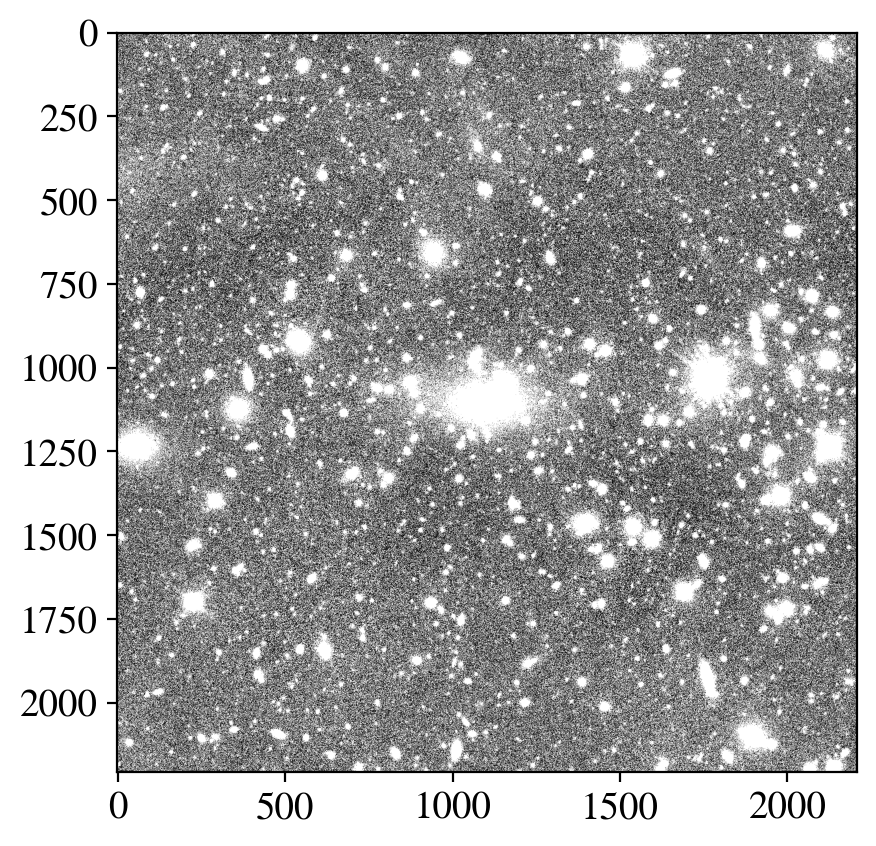

In [121]:
plt.imshow(coadds_exp.image['i'].array, norm='asinh', cmap=cm.gray, vmin=-.1, vmax=1) 

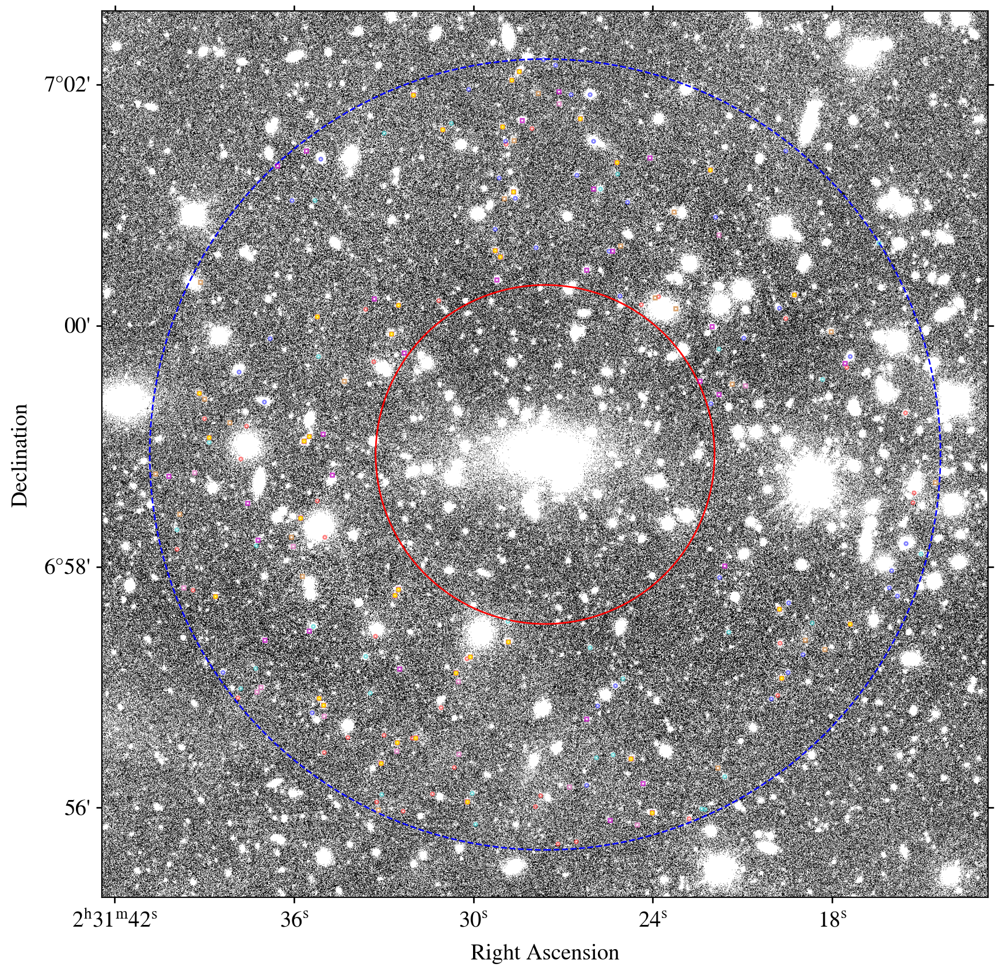

In [123]:
new_wcs = WCS(coadds[0].getWcs().getFitsMetadata())

fig, ax = plt.subplots(figsize=(10,10), nrows=1, ncols=1, 
                       subplot_kw={'projection': new_wcs})

rgb_original = createRGB(coadds_exp.image, bgr=['g', 'r', 'i'], stretch=5, Q=10)#,stretch=0.01, Q=100, scale=[1, 1, 1])
# rgb_original = createRGB(coadds_exp.image['i'], bgr=['i', 'i', 'i'], stretch=5, Q=10)#,stretch=0.01, Q=100, scale=[1, 1, 1])

rgb_extent = (newimage.template.getBBox().beginX, newimage.template.getBBox().endX,
              newimage.template.getBBox().beginY, newimage.template.getBBox().endY)
center_pixel = new_wcs.world_to_pixel_values([[ra_bcg, dec_bcg]])[0]


# ax.imshow(rgb_original, origin='lower', extent=rgb_extent)
ax.imshow(coadds_exp.image['i'].array, norm='asinh',
          cmap=cm.gray, vmin=-.1, vmax=1, origin='lower', extent=rgb_extent) 

# ax.imshow(rgb_original, origin='lower')
inner_circle = Circle(center_pixel, radius=npix_inner, fill=False, color='r', ls='-')
outer_circle = Circle(center_pixel, radius=npix_outer, fill=False, color='b', ls='--')

sv_pixs = new_wcs.world_to_pixel_values(h_solo[:,0], h_solo[:,1])
ax.plot(sv_pixs[0], sv_pixs[1], marker='o', alpha=0.5,
        fillstyle='none', color='r', linestyle='', markersize=2)

ana_pixs = new_wcs.world_to_pixel_values(a_solo[:,0], a_solo[:,1])
ax.plot(ana_pixs[0], ana_pixs[1], marker='o', alpha=0.5,
        fillstyle='none', color='b', linestyle='', markersize=2) 

mdet_pixs = new_wcs.world_to_pixel_values(m_solo[:,0], m_solo[:,1])
ax.plot(mdet_pixs[0], mdet_pixs[1], marker='o', alpha=0.5,
        fillstyle='none', color='c', linestyle='', markersize=2)

am_overlap_pixs = new_wcs.world_to_pixel_values(am_overlap[:,0], am_overlap[:,1])
ax.plot(am_overlap_pixs[0], am_overlap_pixs[1], marker='s', alpha=0.7,
        fillstyle='none', color='m', linestyle='', markersize=2)

hm_overlap_pixs = new_wcs.world_to_pixel_values(hm_overlap[:,0], hm_overlap[:,1])
ax.plot(hm_overlap_pixs[0], hm_overlap_pixs[1], marker='s', alpha=0.7,
        fillstyle='none', color='tab:pink', linestyle='', markersize=2)

ah_overlap_pixs = new_wcs.world_to_pixel_values(ah_overlap[:,0], ah_overlap[:,1])
ax.plot(ah_overlap_pixs[0], ah_overlap_pixs[1], marker='s', alpha=0.7,
        fillstyle='none', color='peru', linestyle='', markersize=2)

amh_overlap_pixs = new_wcs.world_to_pixel_values(amh_overlap[:,0], amh_overlap[:,1])
ax.plot(amh_overlap_pixs[0], amh_overlap_pixs[1], marker='h', alpha=1,
        fillstyle='none', color='gold', linestyle='', markersize=2)


ax.add_artist(inner_circle)
ax.add_artist(outer_circle)

# ax.set_xlim([newimage.template.getBBox().beginX, newimage.template.getBBox().endX])
# ax.set_ylim([newimage.template.getBBox().beginY, newimage.template.getBBox().endY])
ax.set_xlabel("Right Ascension")
ax.set_ylabel("Declination")



# ax.scatter(inner_sv38['x'], inner_sv38['y'], s=4, marker='x')

In [310]:
# sv38_table = Table.read(f'{outdir}/abell360_POSTCUTS_allnoisy_masked_DP1.fits')
sv38_table = Table.read(f'{outdir}/abell360_POSTCUTS_dnf0.37_masked_DP1_widepz.fits')
# print(len(sv38_table))
# sky_mpc = (Da(0.22) * np.pi/180 * sv38_table['sep'])
# inner_sv38 = sv38_table[(sky_mpc > 0.3) * (sky_mpc < 0.7)]

In [311]:
# anacal_table = Table.read('cluster_data/new_anacal_5snr.fits')
# anacal_table = Table.read('cluster_data/masked_anacal.fits')
# anacal_table = Table.read('cluster_data/anacal_table_v2_bright_allmasks.fits')
anacal_table = Table.read('cluster_data/anacal_pz_table_v2_bright_allmasks.fits')


# sky_mpc = (Da(0.22) * np.pi/180 * anacal_table['sep'])
# inner_ana = anacal_table[(sky_mpc > 0.3) * (sky_mpc < 0.7)]

In [312]:

mdet_table = pd.read_pickle('/sdf/group/rubin/shared/cluster_commissioning/metadetect/md-wl-point-mode_v2.pkl')
mdet_table = Table.from_pandas(mdet_table)

# inner_mdet = mdet_table[(mdet_table['mpc_sep'] > 0.3) * (mdet_table['mpc_sep'] < 0.7)]

In [313]:
_, _, mt, at, ht, mc, ac, hc, big_crossmatch = cross_match_frac(sv38_table, anacal_table, mdet_table, 3)

N_hsm=9469, N_ana=9701, N_mdet=10934
Nhm=np.int64(5075), Nha=np.int64(4381), Nam=np.int64(5310), Nah=np.int64(4381), Nmh=np.int64(5075), Nma=np.int64(5310)
[np.float64(0.4641485275288092), np.float64(0.451602927533244), np.float64(0.48564111944393634), np.float64(0.46266765233921214), np.float64(0.5359594466152708), np.float64(0.5473662509019689)]


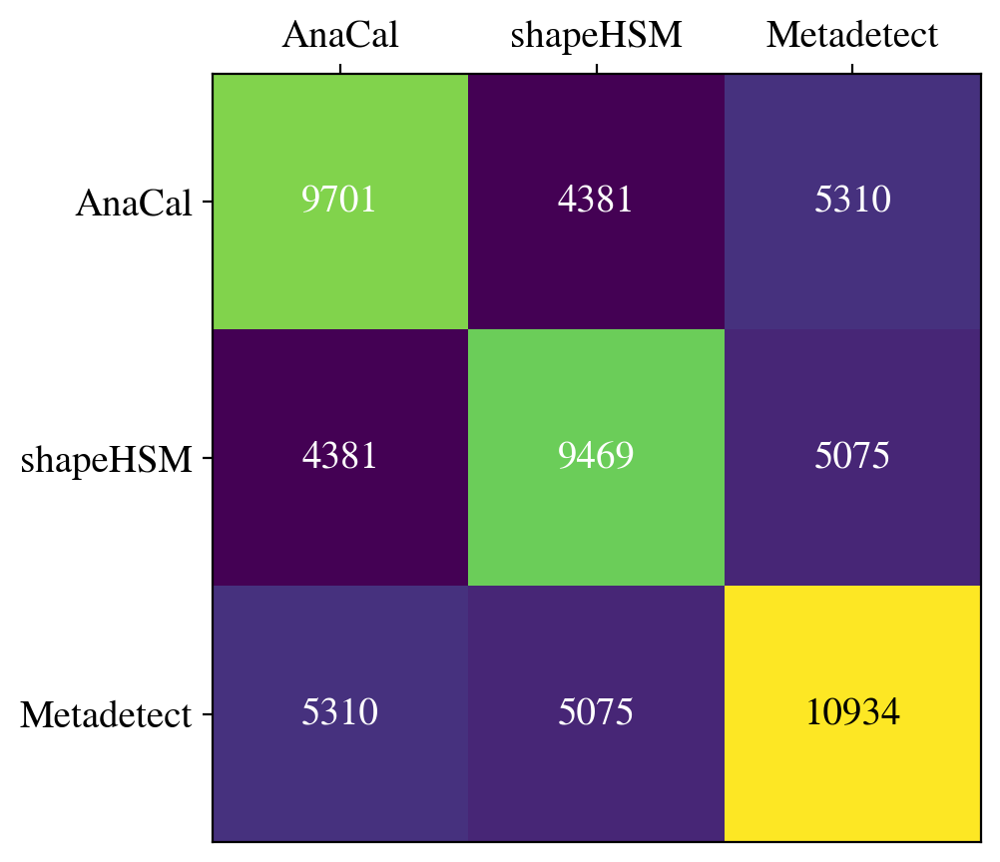

In [323]:
fig, ax = plt.subplots(1, figsize=(5,5))

im = ax.imshow(big_crossmatch)

ax.set_xticks(range(3), labels=['AnaCal', 'shapeHSM', 'Metadetect'],
              rotation=0,)
ax.set_yticks(range(3), labels=['AnaCal', 'shapeHSM', 'Metadetect'])
ax.tick_params(top=True, labeltop=True, bottom=False, labelbottom=False)
# ax.spines[:].set_visible(False)
for i in range(3):
    for j in range(3):
        if i==2 and j==2:
            color='k'
        else:
            color='w'
        text = ax.text(j, i, big_crossmatch[i, j],
                       ha="center", va="center", color=color)